### Statlog (Vehicle Silhouettes)
https://archive.ics.uci.edu/ml/datasets/Statlog+(Vehicle+Silhouettes)

#### Data Description:
The data contains features extracted from the silhouette of vehicles in
different angles. Four &quot;Corgie&quot; model vehicles were used for the
experiment: a double decker bus, Cheverolet van, Saab 9000 and an
Opel Manta 400 cars. This particular combination of vehicles was
chosen with the expectation that the bus, van and either one of the cars
would be readily distinguishable, but it would be more difficult to
distinguish between the cars.

#### Domain:
Object recognition

#### Context:
The purpose is to classify a given silhouette as one of three types of
vehicle, using a set of features extracted from the silhouette. The vehicle
may be viewed from one of many different angles.

##### Attribute Information:
1. All the features are geometric features extracted from the
silhouette.
2. All are numeric in nature.



In [1]:
#importing the needed packages
import numpy as np
import pandas as pd
import pandas as pd
import seaborn as sns; sns.set(style="ticks", color_codes=True)
import warnings; warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import time
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier 
from sklearn import svm
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
import xgboost as xgb
from xgboost import XGBClassifier
import lightgbm as lgb
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import cross_validate
from sklearn.metrics import f1_score
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import BayesianRidge
from sklearn.manifold import TSNE
from sklearn.neighbors import NeighborhoodComponentsAnalysis
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

In [2]:
#Setting style for seaborn charts
sns.set_context("talk", font_scale=0.75, rc={"lines.linewidth": 2.5})

### Approach Taken/Summary of Steps :

#### Data Analysis, Feature Engineering and EDA
1. Read the dataset
2. Inspect of data types, Study the Five Number Summary of the data
3. Null value detection/treatement 
4. Outliers detection/treatment with EDA
5. Correlation Analysis of independent numerical variables - Check for Multicollinearity with EDA
6. Multicollinearity with EDA
7. Analysis of Target variable - Multi class distribution for this use case

#### Model Implementation - Basic Modeling with Hyperparameter tuning
8. Split train and test set for the cleansed data
9. Base training of models to get base score - RAW DATA, NO Hyper Parameters, NO scaling 
10. Evaluation of Base Model - Confusion Matrix, Classification Reports, F1 score assessment
11. Model 1 - Choosing BEST AMONG Hyper parameter tuning of Logistic Regression and SVC (NO Scaling, NO PCA)
12. Evaluation of Model 1 - Confusion Matrix, Classification Reports, F1 score assessment
13. Model 2 - ONLY Logistics Regression Hyper parameter tuning of Logistic Regression (NO scaling, NO PCA)
14. Evaluation of Model 2 - Confusion Matrix, Classification Reports, F1 score assessment
15. Model 3 - Hyper Parameter tuning of scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models
16. Evaluation of Model 3 - Confusion Matrix, Classification Reports, F1 score assessment

#### Model Implementation - Basic Modeling with Hyperparameter tuning with PCA
17. Model 4 - Hyper Parameter tuning of PCA(FINDING BEST NUMBER OF FEATURES BETWEEN 1 AND 15), parameter tuning of Scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models
18. Evaluation of Model 4 - Confusion Matrix, Classification Reports, F1 score assessment
19. Visualization of PCA, Ploting Explained Variance Ratio with PCA for Model 4
20. Model 5 - Hyper Parameter tuning of PCA(FINDING BEST NUMBER OF FEATURES BETWEEN 1 AND 10), parameter tuning of Scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models
21. Evaluation of Model 5 - Confusion Matrix, Classification Reports, F1 score assessment
22. Visualization of PCA, Ploting Explained Variance Ratio with PCA for Model 5
23. Model 6 - Hyper Parameter tuning of PCA(FINDING BEST NUMBER OF FEATURES BETWEEN 1 AND 12), parameter tuning of Scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models
24. Evaluation of Model 6 - Confusion Matrix, Classification Reports, F1 score assessment
25. Visualization of PCA, Ploting Explained Variance Ratio with PCA for Model 6
26. INSPECTING COLLINEARITY REMOVAL after PCA - Study of pair plots

#### Model Implementation - Basic Modeling with Hyperparameter tuning with PCA and Feature Selection Techniques 
27. Model 7 - Hyper Parameter tuning of FEATURE SELECTION USING ANOVA F-value and mutual_info_classif(Mutual information for a discrete target), parameter tuning of Scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models
28. Evaluation of Model 7 - Confusion Matrix, Classification Reports, F1 score assessment
29. Model 8 - Hyper Parameter tuning of FEATURE SELECTION USING RANDOM FOREST, DECISION TREE AND EXTRA TREE CLASSIFIERS, parameter tuning of Scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models
30. Evaluation of Model 8 - Confusion Matrix, Classification Reports, F1 score assessment
31. Model 9 - Hyper Parameter tuning of FEATURE SELECTION USING LINEAR SVC, LIGHTGBM, LOGISTIC REGRESSION CLASSIFIERS, parameter tuning of Scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models
32. Evaluation of Model 9 - Confusion Matrix, Classification Reports, F1 score assessment

#### Model Implementation - Basic Modeling with Hyperparameter tuning with PCA and Tree Based Models
33. Model 10 - Hyper Parameter tuning of RANDOM FOREST MODEL, PCA tuning and parameter tuning of Scaler methods - Standard, Robust, Quantile scalers
34. Evaluation of Model 10 - Confusion Matrix, Classification Reports, F1 score assessment
35. Visualization of PCA, Ploting Explained Variance Ratio with PCA for Model 10
36. Model 11 - Hyper Parameter tuning of XGBOOST MODEL, PCA tuning and parameter tuning of Scaler methods - Standard, Robust, Quantile scalers
37. Evaluation of Model 11 - Confusion Matrix, Classification Reports, F1 score assessment
38. Visualization of PCA, Ploting Explained Variance Ratio with PCA for Model 11

#### Model Selection - Based on Hyperparameter Tuning, Clustering
39. COMPARE AND CONTRAST the best fits from all the above 11 models - based on F1 score of each class
40. Using ELBOW METHOD - Scale using MINMAX Scaler, Find Optimal clusters for KMeans, Fit Kmeans & Evaluate the confusion matrix and classification F1 Scores against the clusters predicted
41. Using ELBOW METHOD - Scale using best PCA/Scaler obtained from best fits, Find Optimal clusters for KMeans, Fit Kmeans & Evaluate the confusion matrix and classification F1 Scores against the clusters predicted

#### Model Implementation - Stacking
42. STACKING - With 11 best fit hyper parameter tuned models, consolidating the learners together and perform stacking. For this use case, only Level 0 and Level 1 stacking has been accomplished.
43. Evaluate of stacked model - Confusion Matrix, Classification Reports, F1 score assessment

#### Other Experimentation - Application of LDA & T-SNE
44. Hyperparameter tuning with LDA - Observe for better clustering groups
45. Evaluation of T-SNE with different hyperparameters for T-SNE
46. Final Evaluation - Best of T-SNE parameters Vs LDA parameters Vs PCA parameters

#### Final Verdict
47. Technical Summary
48. Final Conclusion 

In [3]:
#Reading the dataset
train_df = pd.read_csv("vehicle.csv")
train_df.head(10).T

,0,1,2,3,4,5,6,7,8,9
compactness,95,91,104,93,85,107,97,90,86,93
circularity,48,41,50,41,44,NaN,43,43,34,44
distance_circularity,83,84,106,82,70,106,73,66,62,98
radius_ratio,178,141,209,159,205,172,173,157,140,NaN
pr.axis_aspect_ratio,72,57,66,63,103,50,65,65,61,62
max.length_aspect_ratio,10,9,10,9,52,6,6,9,7,11
scatter_ratio,162,149,207,144,149,255,153,137,122,183
elongatedness,42,45,32,46,45,26,42,48,54,36
pr.axis_rectangularity,20,19,23,19,19,28,19,18,17,22
max.length_rectangularity,159,143,158,143,144,169,143,146,127,146


#### Immediate Observation : LOT of NaNs, null values are evidently present - Let us inspect the data types

In [4]:
#let us see whether pandas has read the data types correctly like given in dataset description
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 846 entries, 0 to 845
Data columns (total 19 columns):
compactness                    846 non-null int64
circularity                    841 non-null float64
distance_circularity           842 non-null float64
radius_ratio                   840 non-null float64
pr.axis_aspect_ratio           844 non-null float64
max.length_aspect_ratio        846 non-null int64
scatter_ratio                  845 non-null float64
elongatedness                  845 non-null float64
pr.axis_rectangularity         843 non-null float64
max.length_rectangularity      846 non-null int64
scaled_variance                843 non-null float64
scaled_variance.1              844 non-null float64
scaled_radius_of_gyration      844 non-null float64
scaled_radius_of_gyration.1    842 non-null float64
skewness_about                 840 non-null float64
skewness_about.1               845 non-null float64
skewness_about.2               845 non-null float64
hollows_ratio    

#### Total of 19 columns - 18 numerical features as described in problem statement and 1 Target variable (class)

In [5]:
#inspecting the max, min, median, mean and count to inspect the data further
train_df.describe().T

,count,mean,std,min,25%,50%,75%,max
compactness,846.0,93.678487,8.234474,73.0,87.00,93.0,100.0,119.0
circularity,841.0,44.828775,6.152172,33.0,40.00,44.0,49.0,59.0
distance_circularity,842.0,82.110451,15.778292,40.0,70.00,80.0,98.0,112.0
radius_ratio,840.0,168.888095,33.520198,104.0,141.00,167.0,195.0,333.0
pr.axis_aspect_ratio,844.0,61.678910,7.891463,47.0,57.00,61.0,65.0,138.0
max.length_aspect_ratio,846.0,8.567376,4.601217,2.0,7.00,8.0,10.0,55.0
scatter_ratio,845.0,168.901775,33.214848,112.0,147.00,157.0,198.0,265.0
elongatedness,845.0,40.933728,7.816186,26.0,33.00,43.0,46.0,61.0
pr.axis_rectangularity,843.0,20.582444,2.592933,17.0,19.00,20.0,23.0,29.0
max.length_rectangularity,846.0,147.998818,14.515652,118.0,137.00,146.0,159.0,188.0


### Observation : 

1. Mean and median are mostly close to each other, but definitely not same. This is definite signs of distribution being right of left skewed. We can observe this in pair plot that we would be doing shortly after this step.
2. From quick glance - there are very evident outliers where max value is way beyond the min, 25-75 percentile range. Scaled_variance.1 for example has max value 1018 where 75 percentile range of the data was between 300 to 600. Like wise axis_aspect_ratio, length_aspect_ratio seem to have very evident outliers.
3. We will be doing outlier detection as separate step where we would do deep dive bit more to detect these outliers
4. Whole dataset features - NO DESCRIPTION was given explaining how these features would play a role with respect to vehicle attributes. Despite class target present, these would be kind of unsupervised learning with we wanting to study the interactions between features further and drawing conclusions based on our analysis

In [6]:
# check for null values
print("Check for IS NULL ")
print("*****************")
print(train_df.isnull().sum())

Check for IS NULL 
*****************
compactness                    0
circularity                    5
distance_circularity           4
radius_ratio                   6
pr.axis_aspect_ratio           2
max.length_aspect_ratio        0
scatter_ratio                  1
elongatedness                  1
pr.axis_rectangularity         3
max.length_rectangularity      0
scaled_variance                3
scaled_variance.1              2
scaled_radius_of_gyration      2
scaled_radius_of_gyration.1    4
skewness_about                 6
skewness_about.1               1
skewness_about.2               1
hollows_ratio                  0
class                          0
dtype: int64


##### Like we saw in quick inspection of data - there are NULL values in different features. They need to be treated before the model implementation

In [7]:
### AS mentioned in problem statement - Van, Car and bus : THREE distinct targets ####
train_df['class'].unique()

array(['van', 'car', 'bus'], dtype=object)

In [8]:
#########################################################
####### OPTIONAL PROFLING REPORT FROM PANDAS ############
######## One of the COOL FEATURES OF PANDAS #############
#########################################################

import pandas_profiling
pandas_profiling.ProfileReport(train_df)

In [9]:
###################################################################################
### This function takes input dataframe and returns separate list of ##############
#### Numerical features, Categorical features, target AND NULL VALUE features #####
###################################################################################

def extract_feature_types(train_df, itarget=None):
    
    categorical_features = []
    numerical_features = []
    target = []
    for column in train_df.columns:
        if (train_df[column].dtype == 'object' or train_df[column].dtype.name == 'category'):
            print ("**** Adding categorical feature **** ")
            print (column)
            train_df[column] = train_df[column].astype('category')
            if(column not in (itarget)):
                categorical_features = categorical_features + [column]
            else:
                target = column
        else :
            numerical_features = numerical_features + [column]
    null_features = train_df.columns[train_df.isnull().any()]
    return numerical_features, categorical_features, target, null_features

        

In [10]:
####################################################################################
############# Utility function to draw set of KDE plots for list of features #######
####################################################################################
def dist_plot_series(train_df, total_feature_list, number_of_graphs=2, category=None):

    number_of_graphs = number_of_graphs
    grid_x = int(len(total_feature_list)/number_of_graphs)

    f, axes = plt.subplots(grid_x, number_of_graphs, figsize=(16, 16), sharex=False)
    axis_y = 0
    axis_x = 0
    
    for feature in total_feature_list:
        
        grid = sns.FacetGrid(train_df, hue=category, size=5)
            
        grid.map(sns.kdeplot, feature, ax=axes[axis_x,axis_y]) \
        .add_legend()
        
        axes[axis_x,axis_y].set_title("KDE plot for " + feature)
        axis_x += 1
        axis_y += 1
        if(axis_y == number_of_graphs):
            axis_y = 0;
        if(axis_x == grid_x):
            axis_x = 0; 
        
        plt.close(2)
    return

In [11]:
numerical_features, categorical_features, target, null_features = extract_feature_types(train_df, 'class')
print("\n############### Numerical features are ############### \n  %s \n"%(numerical_features))
print("############### Categorical features are ############### \n  %s \n"%(categorical_features))
print("############### Features having NULL values ############### \n \n %s \n"%(null_features))
print("############### Target/y############### \n  %s "%(target))


**** Adding categorical feature **** 
class

############### Numerical features are ############### 
  ['compactness', 'circularity', 'distance_circularity', 'radius_ratio', 'pr.axis_aspect_ratio', 'max.length_aspect_ratio', 'scatter_ratio', 'elongatedness', 'pr.axis_rectangularity', 'max.length_rectangularity', 'scaled_variance', 'scaled_variance.1', 'scaled_radius_of_gyration', 'scaled_radius_of_gyration.1', 'skewness_about', 'skewness_about.1', 'skewness_about.2', 'hollows_ratio'] 

############### Categorical features are ############### 
  [] 

############### Features having NULL values ############### 
 
 Index(['circularity', 'distance_circularity', 'radius_ratio',
       'pr.axis_aspect_ratio', 'scatter_ratio', 'elongatedness',
       'pr.axis_rectangularity', 'scaled_variance', 'scaled_variance.1',
       'scaled_radius_of_gyration', 'scaled_radius_of_gyration.1',
       'skewness_about', 'skewness_about.1', 'skewness_about.2'],
      dtype='object') 

############### Target/

In [12]:
#### Checking the feature transformation after above invoking of extract_feature_types() #####
############### TO MAKE SURE feature types are not wrongly transformed #######################
##############################################################################################
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 846 entries, 0 to 845
Data columns (total 19 columns):
compactness                    846 non-null int64
circularity                    841 non-null float64
distance_circularity           842 non-null float64
radius_ratio                   840 non-null float64
pr.axis_aspect_ratio           844 non-null float64
max.length_aspect_ratio        846 non-null int64
scatter_ratio                  845 non-null float64
elongatedness                  845 non-null float64
pr.axis_rectangularity         843 non-null float64
max.length_rectangularity      846 non-null int64
scaled_variance                843 non-null float64
scaled_variance.1              844 non-null float64
scaled_radius_of_gyration      844 non-null float64
scaled_radius_of_gyration.1    842 non-null float64
skewness_about                 840 non-null float64
skewness_about.1               845 non-null float64
skewness_about.2               845 non-null float64
hollows_ratio    

In [13]:
#### Just inspecting the shape of dataframe, X and Y ########

X = train_df.loc[:, numerical_features+categorical_features]
y = np.array(train_df.loc[:, target]).reshape(-1,1)
train_df.shape

(846, 19)

In [14]:
X.shape

(846, 18)

In [15]:
y.shape

(846, 1)

### NULL Values Imputation

In [16]:
##### Let us inspect some null values - to study whether they have any specific pattern for null values #####

train_df[train_df.isnull().any(axis=1)][null_features].head()

,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2
5,NaN,106.0,172.0,50.0,255.0,26.0,28.0,280.0,957.0,264.0,85.0,5.0,9.0,181.0
9,44.0,98.0,NaN,62.0,183.0,36.0,22.0,202.0,505.0,152.0,64.0,4.0,14.0,195.0
19,56.0,100.0,215.0,NaN,208.0,32.0,24.0,227.0,651.0,223.0,74.0,6.0,5.0,186.0
35,46.0,NaN,172.0,67.0,157.0,43.0,20.0,170.0,363.0,184.0,67.0,17.0,7.0,192.0
66,43.0,68.0,125.0,57.0,149.0,46.0,19.0,169.0,323.0,172.0,NaN,NaN,18.0,179.0


##### Since there are quite a few NULL values, it is not good idea to drop them. Useful information would be lost, if we drop them. Let us treat them

In [17]:
#### Taking a backup copy for NULL value treatement #####
#########################################################
X_missing = np.copy(X)
X_missing[X.isnull().any(axis=1)]

array([[107.,  nan, 106., 172.,  50.,   6., 255.,  26.,  28., 169., 280.,
        957., 264.,  85.,   5.,   9., 181., 183.],
       [ 93.,  44.,  98.,  nan,  62.,  11., 183.,  36.,  22., 146., 202.,
        505., 152.,  64.,   4.,  14., 195., 204.],
       [101.,  56., 100., 215.,  nan,  10., 208.,  32.,  24., 169., 227.,
        651., 223.,  74.,   6.,   5., 186., 193.],
       [100.,  46.,  nan, 172.,  67.,   9., 157.,  43.,  20., 150., 170.,
        363., 184.,  67.,  17.,   7., 192., 200.],
       [ 81.,  43.,  68., 125.,  57.,   8., 149.,  46.,  19., 146., 169.,
        323., 172.,  nan,  nan,  18., 179., 184.],
       [ 96.,  55.,  98., 161.,  54.,  10., 215.,  31.,  nan, 175., 226.,
        683., 221.,  76.,   3.,   6., 185., 193.],
       [ 86.,  40.,  62., 140.,  62.,   7., 150.,  45.,  19., 133., 165.,
        330., 173.,  nan,   2.,   3., 180., 185.],
       [104.,  52.,  94.,  nan,  66.,   5., 208.,  31.,  24., 161., 227.,
        666., 218.,  76.,  11.,   4., 193., 191.],


In [18]:
######################################################################
##### NULL VALUE IMPUTATION - USING MODEL BASED IMPUTATION ###########
######################################################################


#Let us take reliable regressor like random forest with default parameters
# to evaluate the imputation score
base_evaluator = RandomForestClassifier(random_state=42)

missing_imputers_dict =  {
    "Bayesian Ridge": BayesianRidge(),    
    "Decision Tree Regressor": DecisionTreeRegressor(max_features='sqrt', random_state=0),
    "Extra Tree Regressor_10": ExtraTreesRegressor(n_estimators=10, random_state=0),       
    "Extra Tree Regressor_6": ExtraTreesRegressor(n_estimators=6, random_state=0),
    "Extra Tree Regressor_12": ExtraTreesRegressor(n_estimators=12, random_state=0),
    "Extra Tree Regressor_15": ExtraTreesRegressor(n_estimators=15, random_state=0),
    "KNeighborsRegressor_3": KNeighborsRegressor(n_neighbors=3),
    "KNeighborsRegressor_2": KNeighborsRegressor(n_neighbors=2),
    "KNeighborsRegressor_4": KNeighborsRegressor(n_neighbors=4),
    "KNeighborsRegressor_5": KNeighborsRegressor(n_neighbors=5),
    "KNeighborsRegressor_6": KNeighborsRegressor(n_neighbors=6) 
    }


In [19]:
def impute_null_values(X_missing, y_missing, missing_imputers_dict=None, verbose=False):
    imputer_eval_df = pd.DataFrame()
    cross_val_list = []
    scoring_parameters = ['precision_macro', 'recall_macro', 'f1_macro']

    for imputer_name, imputer in list(missing_imputers_dict.items()):

        if (verbose == True):
            print("***** BEGIN Imputation of [%s] *****"%(imputer_name))
        impute_itr = make_pipeline(IterativeImputer(random_state=42, estimator=imputer),
                                  base_evaluator)
        cross_val_clf = cross_validate(impute_itr, X_missing, y_missing,
                                                                      scoring=scoring_parameters,
                                                                      cv=5)
        metric_list = []
        for key in cross_val_clf.keys():
            metric_list =  metric_list + [cross_val_clf[key].mean()]

        imputer_eval_df = pd.concat([imputer_eval_df, 
                                     pd.DataFrame(metric_list, columns=[imputer_name], index=cross_val_clf.keys())], axis=1)
        cross_val_list = cross_val_list + [cross_val_clf]
        if (verbose == True):
            print("***** END Imputation of [%s] *****"%(imputer_name))

    imputer_eval_df = imputer_eval_df.T
    if (verbose == True):
        print("List of models imputed <%s>" %(cross_val_list))
    return imputer_eval_df, cross_val_list 
    

In [20]:
### Observing how imputation has performed by different models ######
y_missing = train_df['class'].replace({'van': 0, 'car': 1, 'bus': 2})
null_imputed_df, impute_list = impute_null_values(X_missing, y_missing, missing_imputers_dict, False)
null_imputed_df.sort_values('test_f1_macro')

,fit_time,score_time,test_precision_macro,test_recall_macro,test_f1_macro
Extra Tree Regressor_15,2.967433,0.076022,0.931909,0.937124,0.932786
Extra Tree Regressor_6,1.268982,0.046174,0.934748,0.941634,0.936976
Extra Tree Regressor_12,2.409866,0.066477,0.935576,0.940930,0.936985
KNeighborsRegressor_2,0.037945,0.014602,0.937056,0.940930,0.937927
KNeighborsRegressor_5,0.036117,0.013364,0.936708,0.942480,0.938451
Extra Tree Regressor_10,1.976057,0.055362,0.939028,0.944112,0.940653
Bayesian Ridge,0.434367,0.020053,0.939445,0.944112,0.940674
Decision Tree Regressor,0.156305,0.010476,0.939090,0.944102,0.940677
KNeighborsRegressor_3,0.034120,0.012118,0.939320,0.944147,0.940690
KNeighborsRegressor_4,0.037678,0.014552,0.940573,0.944922,0.941801


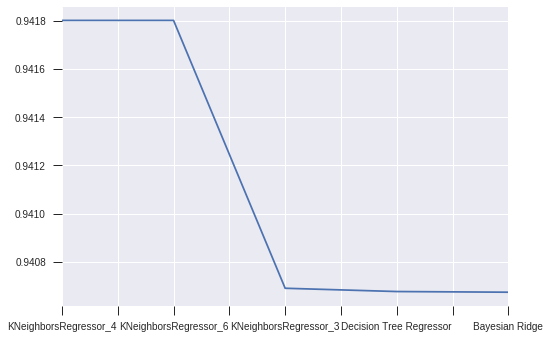

In [21]:
null_imputed_df['test_f1_macro'].nlargest(5).plot(kind='line')
#########################################################################################################
######### Plotting the F1 score - to choose which model to choose for NULL value imputation #############
#########################################################################################################

#### Observation ON NULL VALUE Imputation :
K Nearest NeighborsRegressor model with neighbors of '4' have high F1 score for null value imputation, hence we will choose KNN with neighbors as 4 for NULL value imputation 

In [22]:
missing_imputer = IterativeImputer(random_state=0, estimator= KNeighborsRegressor(n_neighbors=4))

#### I could have gone for mean, median or mode for NULL value imputation, but thing to be noted - THESE FEATURES HAVE NO EVIDENT DESCRIPTION of how they interact with each other and how significant they are to target. In other words, NO DOMAIN KNOWLEDGE on these features. Hence, instead of making assumptions to treat by mean/median, I wanted to find the nearest neighbor points for that feature space missing and replace them for the null values. Choosing nearest neighbors as 4 as per Imputer evaluation among different models for F1 score criteria. 

In [23]:
missing_imputer.get_params

<bound method BaseEstimator.get_params of IterativeImputer(add_indicator=False,
                 estimator=KNeighborsRegressor(algorithm='auto', leaf_size=30,
                                               metric='minkowski',
                                               metric_params=None, n_jobs=None,
                                               n_neighbors=4, p=2,
                                               weights='uniform'),
                 imputation_order='ascending', initial_strategy='mean',
                 max_iter=10, max_value=None, min_value=None,
                 missing_values=nan, n_nearest_features=None, random_state=0,
                 sample_posterior=False, tol=0.001, verbose=0)>

In [24]:
##### Transforming the missing values with nearest neighbor using KNN #######

X_missing_knn = missing_imputer.fit_transform(X_missing)

In [25]:
### POST transformation of null values - Random inspection to check whether null values are gone #####
########### Looks like, null values are GONE and transformed with nearest neighbor points ############
#######################################################################################################

X_missing_knn[X.isnull().any(axis=1)]

array([[107.  ,  56.75, 106.  , 172.  ,  50.  ,   6.  , 255.  ,  26.  ,
         28.  , 169.  , 280.  , 957.  , 264.  ,  85.  ,   5.  ,   9.  ,
        181.  , 183.  ],
       [ 93.  ,  44.  ,  98.  , 196.5 ,  62.  ,  11.  , 183.  ,  36.  ,
         22.  , 146.  , 202.  , 505.  , 152.  ,  64.  ,   4.  ,  14.  ,
        195.  , 204.  ],
       [101.  ,  56.  , 100.  , 215.  ,  67.5 ,  10.  , 208.  ,  32.  ,
         24.  , 169.  , 227.  , 651.  , 223.  ,  74.  ,   6.  ,   5.  ,
        186.  , 193.  ],
       [100.  ,  46.  ,  84.25, 172.  ,  67.  ,   9.  , 157.  ,  43.  ,
         20.  , 150.  , 170.  , 363.  , 184.  ,  67.  ,  17.  ,   7.  ,
        192.  , 200.  ],
       [ 81.  ,  43.  ,  68.  , 125.  ,  57.  ,   8.  , 149.  ,  46.  ,
         19.  , 146.  , 169.  , 323.  , 172.  ,  83.25,   5.25,  18.  ,
        179.  , 184.  ],
       [ 96.  ,  55.  ,  98.  , 161.  ,  54.  ,  10.  , 215.  ,  31.  ,
         24.  , 175.  , 226.  , 683.  , 221.  ,  76.  ,   3.  ,   6.  ,
        185

##### ....... NULL VALUE TRANSFORMATION - COMPLETE ........

In [26]:
##### THIS STEP is just to compare previous state of data frame and conclude that NULL VALUES are GONE #####
X_bkup = np.copy(X)
X = np.copy(X_missing_knn)
imputed_df = pd.DataFrame(data=X, columns=numerical_features)
imputed_df.iloc[[5,9,19,35,66]].head(10)

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio
5,107.0,56.75,106.00,172.0,50.0,6.0,255.0,26.0,28.0,169.0,280.0,957.0,264.0,85.00,5.00,9.0,181.0,183.0
9,93.0,44.00,98.00,196.5,62.0,11.0,183.0,36.0,22.0,146.0,202.0,505.0,152.0,64.00,4.00,14.0,195.0,204.0
19,101.0,56.00,100.00,215.0,67.5,10.0,208.0,32.0,24.0,169.0,227.0,651.0,223.0,74.00,6.00,5.0,186.0,193.0
35,100.0,46.00,84.25,172.0,67.0,9.0,157.0,43.0,20.0,150.0,170.0,363.0,184.0,67.00,17.00,7.0,192.0,200.0
66,81.0,43.00,68.00,125.0,57.0,8.0,149.0,46.0,19.0,146.0,169.0,323.0,172.0,83.25,5.25,18.0,179.0,184.0


In [27]:
##### THIS STEP is just to compare previous state of data frame and conclude that NULL VALUES are GONE #####
train_df[train_df.isnull().any(axis=1)].head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
5,107,NaN,106.0,172.0,50.0,6,255.0,26.0,28.0,169,280.0,957.0,264.0,85.0,5.0,9.0,181.0,183,bus
9,93,44.0,98.0,NaN,62.0,11,183.0,36.0,22.0,146,202.0,505.0,152.0,64.0,4.0,14.0,195.0,204,car
19,101,56.0,100.0,215.0,NaN,10,208.0,32.0,24.0,169,227.0,651.0,223.0,74.0,6.0,5.0,186.0,193,car
35,100,46.0,NaN,172.0,67.0,9,157.0,43.0,20.0,150,170.0,363.0,184.0,67.0,17.0,7.0,192.0,200,van
66,81,43.0,68.0,125.0,57.0,8,149.0,46.0,19.0,146,169.0,323.0,172.0,NaN,NaN,18.0,179.0,184,bus


In [28]:
##### THIS STEP is just to compare previous state of data frame and conclude that NULL VALUES are GONE #####
imputed_df[imputed_df.isnull().any(axis=1)].head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio


##### As suspected during five number summary, there are evident outlier features like mentioned above

In [29]:
#### NULL VALUE TREATED IMPUTED_DF will be our dataframe now for further EDA #####

y_df = pd.DataFrame(y, columns=['target'])
imputed_df = pd.concat([imputed_df, y_df], axis=1)
imputed_df.head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,target
0,95.0,48.0,83.0,178.0,72.0,10.0,162.0,42.0,20.0,159.0,176.0,379.0,184.0,70.0,6.0,16.0,187.0,197.0,van
1,91.0,41.0,84.0,141.0,57.0,9.0,149.0,45.0,19.0,143.0,170.0,330.0,158.0,72.0,9.0,14.0,189.0,199.0,van
2,104.0,50.0,106.0,209.0,66.0,10.0,207.0,32.0,23.0,158.0,223.0,635.0,220.0,73.0,14.0,9.0,188.0,196.0,car
3,93.0,41.0,82.0,159.0,63.0,9.0,144.0,46.0,19.0,143.0,160.0,309.0,127.0,63.0,6.0,10.0,199.0,207.0,van
4,85.0,44.0,70.0,205.0,103.0,52.0,149.0,45.0,19.0,144.0,241.0,325.0,188.0,127.0,9.0,11.0,180.0,183.0,bus


In [30]:
############################################################
#### Function to plot the correlation matrix ###############
############################################################

def correlation_matrix(train_df, width=11, height=9, mask_upper=True) :
    # Compute the correlation matrix
    corr = train_df.corr()
    
    if mask_upper == True:
        # Generate a mask for the upper triangle
        mask = np.zeros_like(corr, dtype=np.bool)
        mask[np.triu_indices_from(mask)] = True
    else: 
        mask=None

    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=(width, height))

    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(220, 10, as_cmap=True)

    # Draw the heatmap with the mask and correct aspect ratio
    sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
                square=True, linewidths=.5, cbar_kws={"shrink": .5})
    return corr;

#### This is interesting, lot of strongly correlated features are evident from the plot. Let us inspect this further to get their values and study their nature

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio
compactness,1.000000,0.689786,0.791707,0.691081,0.091779,0.148249,0.812770,-0.788736,0.814248,0.676143,0.764361,0.818674,0.585845,-0.250603,0.236685,0.157670,0.298528,0.365552
circularity,0.689786,1.000000,0.797180,0.625051,0.154283,0.251407,0.858265,-0.827246,0.856603,0.965729,0.806791,0.850863,0.935950,0.053080,0.144968,-0.011869,-0.106339,0.045652
distance_circularity,0.791707,0.797180,1.000000,0.771748,0.158684,0.264621,0.907949,-0.913020,0.896273,0.775149,0.865710,0.890541,0.706950,-0.227001,0.114665,0.266049,0.146027,0.333648
radius_ratio,0.691081,0.625051,0.771748,1.000000,0.665363,0.450486,0.738480,-0.792946,0.712744,0.571083,0.798294,0.725598,0.541325,-0.181520,0.049112,0.174469,0.382912,0.472339
pr.axis_aspect_ratio,0.091779,0.154283,0.158684,0.665363,1.000000,0.648861,0.103832,-0.183492,0.079566,0.127322,0.273738,0.089750,0.122454,0.152860,-0.058539,-0.032180,0.240201,0.267760


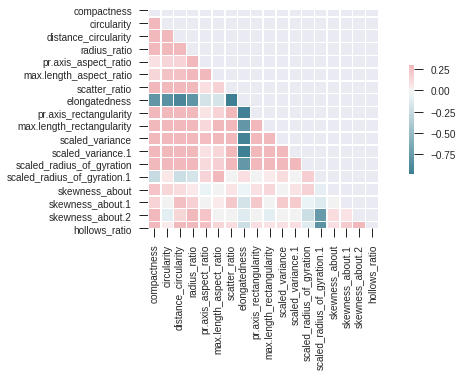

In [31]:
## Computing correlation matrix
corr = correlation_matrix(train_df[numerical_features], 11, 4, True)
#### Inspecting the correlation dataframe ####
corr.head()

In [32]:
#####################################################################################
####### FETCHING THE FEATURE PAIRS THAT HAS STRONG CORRELATION ONLY #################
############ i.e. corr_value != 1 and corr_value > 0.1 or corr_value < -0.1 #########
##################### Let us study them further! ####################################
#####################################################################################
corr_val = corr.unstack().sort_values(kind='quicksort').to_dict()
temp_list = list(set([(tuple(sorted(key)), corr_val[key]) for key in corr_val]))

corr_df = pd.DataFrame(temp_list, columns=['corr_pair', 'corr_value'])
corr_df.set_index('corr_pair', inplace =True)
corr_df.query('corr_value != 1 and corr_value > 0.1 or corr_value < -0.1 ') \
.sort_values(by=['corr_value'], ascending=False)

,corr_value
corr_pair,
"(scaled_variance.1, scatter_ratio)",0.996328
"(pr.axis_rectangularity, scaled_variance.1)",0.992316
"(pr.axis_rectangularity, scatter_ratio)",0.992078
"(circularity, max.length_rectangularity)",0.965729
"(scaled_variance, scatter_ratio)",0.951672
"(scaled_variance, scaled_variance.1)",0.949766
"(pr.axis_rectangularity, scaled_variance)",0.938182
"(circularity, scaled_radius_of_gyration)",0.935950
"(distance_circularity, scatter_ratio)",0.907949


#### Like suspected, correlation value of 0.8-0.9 rings immediate bell for very strong multi collinearity due to strong correlation. We can study this further in scatter plots by inspecting top strongly correlated feature pairs. These are bad for model design for classification problem. Features would need to be independent of each other and classify the target, strong correlation would give false alarm of higher scores but will never generalize well enough to real world data

### INSPECTING COLLINEARITY

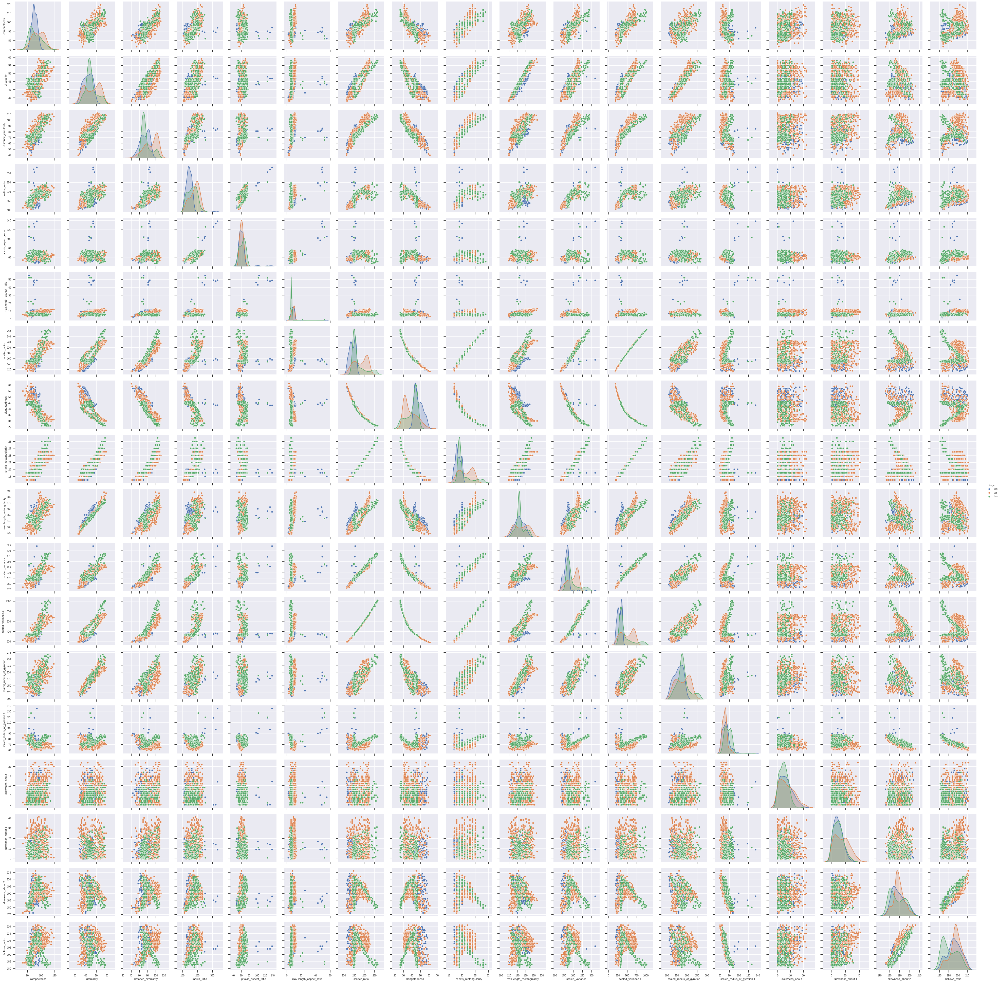

In [33]:
sns.pairplot(imputed_df, height=3,diag_kind='kde', hue='target')

###### Like observed from correlation computation - there are several features with linear pattern of correlation, we will inspect few top correlation features bit more closer in upcoming EDA steps 

In [34]:
#define a plot function of bivariate analysis - Scatter plot

def plot_scatter (graph_df, x_axis, y_axis, target=None):
    
    sns.FacetGrid(graph_df, hue=target, size=5) \
    .map(plt.scatter, x_axis, y_axis) \
    .add_legend()
    
    return;

In [35]:
### Defining KDE plot 

def plot_kde (graph_df, axis, target=None):
    
    sns.FacetGrid(graph_df, hue=target, size=5) \
    .map(sns.kdeplot, axis) \
    .add_legend()
    
    return;

In [36]:
### Defining Boxen Plot for categorical analysis

def plot_boxen(graph_df, x_axis, y_axis):
    
    sns.catplot(x=x_axis, y=y_axis, kind="boxen", data=graph_df)
    return;

In [37]:
#########################################################################################################################
##### BOXEN PLOT -  It is similar to a BOX plot in plotting a nonparametric representation of a distribution ############
#########in which all features correspond to actual observations. By plotting more quantiles, it provides ###############
##################more information about the shape of the distribution, particularly in the tails. ######################
############################For a more extensive explanation : please refer official doc ################################
#################################  https://seaborn.pydata.org/generated/seaborn.boxenplot.html   ########################
#########################################################################################################################
def boxen_plot_series(train_df, total_feature_list, number_of_graphs=2, category=None):

    number_of_graphs = number_of_graphs
    grid_x = int(len(total_feature_list)/number_of_graphs)

    f, axes = plt.subplots(grid_x, number_of_graphs, figsize=(16, 16), sharex=False)
    axis_y = 0
    axis_x = 0
    
    for feature in total_feature_list:
        
        sns.catplot(x=category, y=feature, kind="boxen", data=train_df,
                    ax=axes[axis_x,axis_y])
        
        axes[axis_x,axis_y].set_title("BOX plot for " + feature)
        axis_x += 1
        axis_y += 1
        if(axis_y == number_of_graphs):
            axis_y = 0;
        if(axis_x == grid_x):
            axis_x = 0; 
        
        plt.close(2) 
        
    
        ## to hide the empty graphs, issue reference : https://github.com/mwaskom/seaborn/issues/1514

In [38]:
### Taking the top positive strong correlations ####

corr_df.query('corr_value != 1 and corr_value > 0.5 or corr_value < -0.5 ') \
.sort_values(by=['corr_value'], ascending=False).head(10)

,corr_value
corr_pair,
"(scaled_variance.1, scatter_ratio)",0.996328
"(pr.axis_rectangularity, scaled_variance.1)",0.992316
"(pr.axis_rectangularity, scatter_ratio)",0.992078
"(circularity, max.length_rectangularity)",0.965729
"(scaled_variance, scatter_ratio)",0.951672
"(scaled_variance, scaled_variance.1)",0.949766
"(pr.axis_rectangularity, scaled_variance)",0.938182
"(circularity, scaled_radius_of_gyration)",0.935950
"(distance_circularity, scatter_ratio)",0.907949


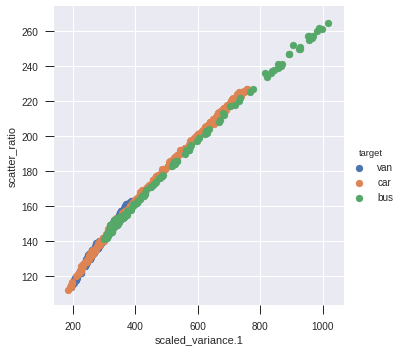

In [39]:
#### Ploting the first strong correlation feature pair - Scaled variance 1 Vs Scatter ration - 0.99#####
################## Like you see below in the graph plot, they are very strongly having linear pattern###
########################################################################################################
plot_scatter(imputed_df,"scaled_variance.1", "scatter_ratio", "target")

#### scaled_variance 1 and scatter_ratio needs to be transformed either as interactive feature or, reduced in dimension through dimension/collinearity reduction techniques like PCA. If they exist together in feature space for a model, evaluation of model might show high enough but will not generalize well when exposed to real time data

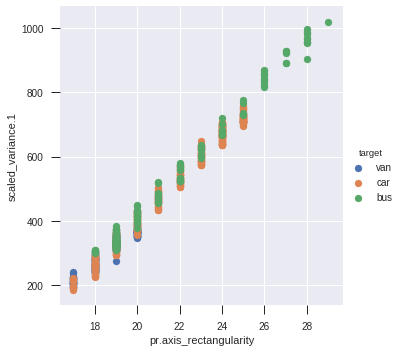

In [40]:
#### pr.axis_rectangularity Vs scaled_variance.1 - VERY STRONG LINEAR RELATION ####
###################################################################################
plot_scatter(imputed_df,"pr.axis_rectangularity", "scaled_variance.1", "target")

#### pr.axis_rectangularity and scaled_variance.1 need to be transformed/reduced through feature interaction techniques or, dimension reductionality techniques like PCA.

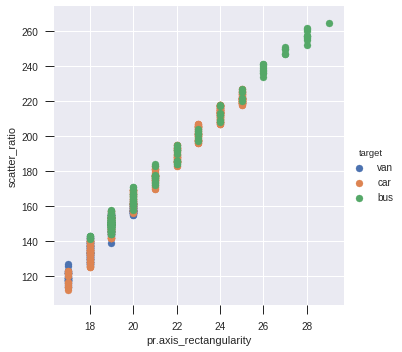

In [41]:
### ANOTHER STRONG LINEAR CORRELATION ######

plot_scatter(imputed_df,"pr.axis_rectangularity", "scatter_ratio", "target")

#### Looks like scatter_ratio, axis_rectangularity and scaled_variance are influencing each other strongly with strong correlation between them - Definitely symptoms of eliminating these 3 features into ONE new feature extracting relevant information from all three. Easy candidates for dimensionalty reduction through PCA.

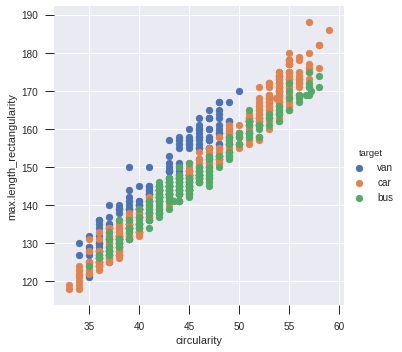

In [42]:
###### INSPECTING OTHER COLLINEAR FEATURES - Strong correlation between them ######

plot_scatter(imputed_df,"circularity", "max.length_rectangularity", "target")

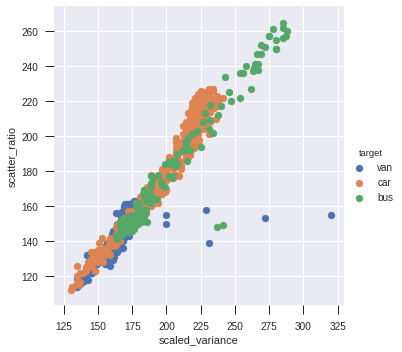

In [43]:
###### INSPECTING OTHER COLLINEAR FEATURES - Strong correlation between them ######

plot_scatter(imputed_df,"scaled_variance", "scatter_ratio", "target")

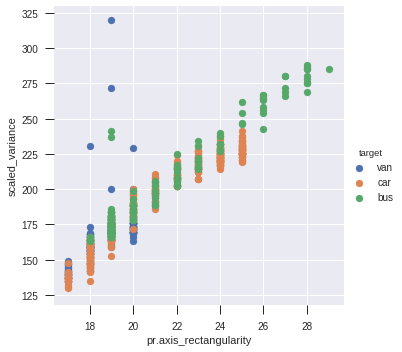

In [44]:
###### INSPECTING OTHER COLLINEAR FEATURES - Strong correlation between them ######

plot_scatter(imputed_df,"pr.axis_rectangularity", "scaled_variance", "target")

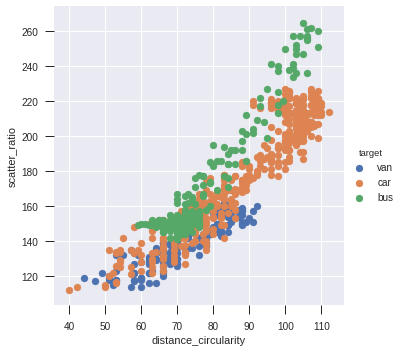

In [45]:
###### INSPECTING OTHER COLLINEAR FEATURES - Strong correlation between them ######

plot_scatter(imputed_df,"distance_circularity", "scatter_ratio", "target")

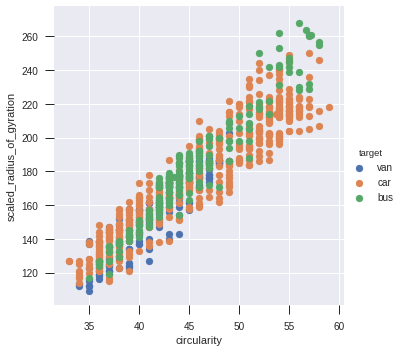

In [46]:
###### INSPECTING OTHER COLLINEAR FEATURES - Strong correlation between them ######

plot_scatter(imputed_df,"circularity", "scaled_radius_of_gyration", "target")

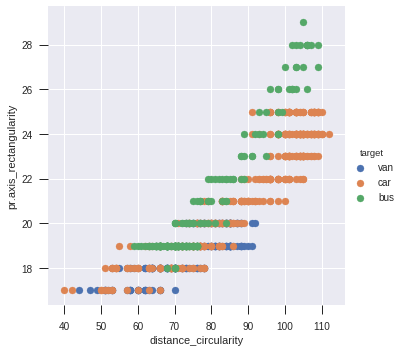

In [47]:
###### INSPECTING OTHER COLLINEAR FEATURES - Strong correlation between them ######

plot_scatter(imputed_df,"distance_circularity", "pr.axis_rectangularity", "target")

#### Repeatedly distance_circularity, axis_rectangularity, circularity, scatter_ratio,scaled_variance, scaled_variance 1, scatter ration appear very strongly correlating each other in this feature space - these would contribute to very poor model with deceptive high scores during model evaluation. All these features need to be reduced in dimension only with relevant information as new feature - ring a bell for PCA? YES!

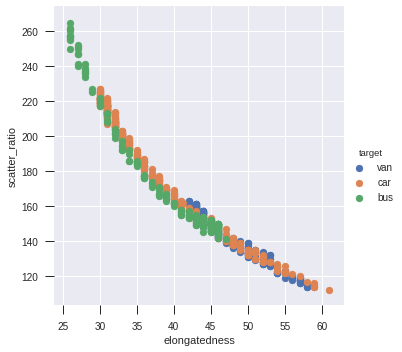

In [48]:
###### INSPECTING OTHER COLLINEAR FEATURES - Strong correlation between them ######
plot_scatter(imputed_df,"elongatedness", "scatter_ratio", "target")

#### Elongatedness is having negative correlation with scatter ratio, which was already having positive correlation with respect to other collinear features that we saw above. This also could potentially imply negative linear pattern of elongatedness while interacting with other features  that had positive correlation with scatter_ratio - LET US FIND OUT!!

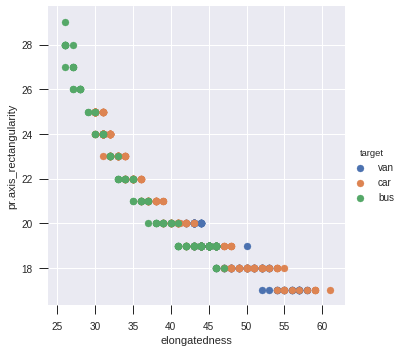

In [49]:
###### INSPECTING OTHER COLLINEAR FEATURES - Strong correlation between them ######

plot_scatter(imputed_df,"elongatedness", "pr.axis_rectangularity", "target")

#### Like suspected, axis_rectangularity is also showing negatively linear effect with elongatedness. "axis_rectangularity" did have strong positive correlation with scatter ratio and now all  these 3 - elongatedness, axis_rectangularity, scatter ration all seem to influence each other strongly either in positive or negative manner

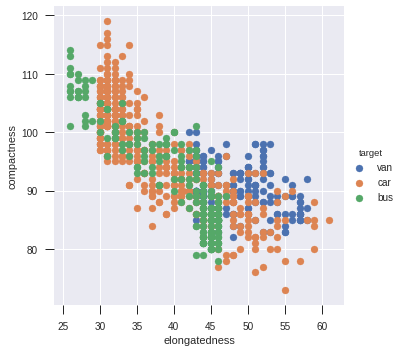

In [50]:
###### INSPECTING OTHER COLLINEAR FEATURES - Strong correlation between them ######
plot_scatter(imputed_df,"elongatedness", "compactness", "target")

#### seems like elongatedness is negatively influencing multiple features injecting strong collinearity. All these needing feature transformation before model development

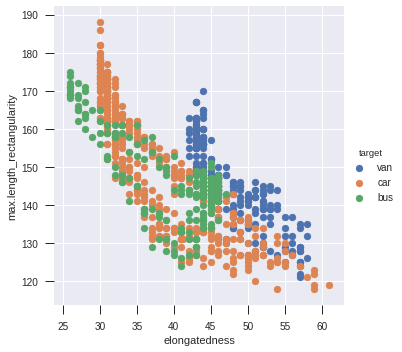

In [51]:
###### INSPECTING OTHER COLLINEAR FEATURES - Strong correlation between them ######

plot_scatter(imputed_df,"elongatedness", "max.length_rectangularity", "target")

#### Negative and strong correlation of elongatedness continues...

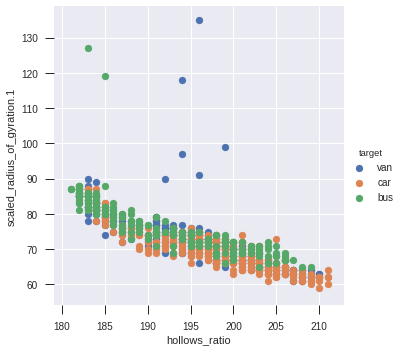

In [52]:
###### INSPECTING OTHER COLLINEAR FEATURES - Strong correlation between them ######

plot_scatter(imputed_df,"hollows_ratio", "scaled_radius_of_gyration.1", "target")

##### OVERALL - WITHOUT ANY DOUBTS, THERE ARE MULTIPLE COLLINEAR FEATURES WHICH NEEDS TO BE TRANSFORMED AND REMOVED AFTER EXTRACTING RELEVANT FEATURE INFORMATION & BEFORE MODEL DEVELOPMENT

In [53]:
############################################################################################
####### Like observed in above plots, you can see below that elongatedness #################
################ is having several strong NEGATIVE correlation with other features #########
############################################################################################
corr_df.query('corr_value != 1 and corr_value > 0.5 or corr_value < -0.5 ') \
.sort_values(by=['corr_value'], ascending=False).tail(10)

,corr_value
corr_pair,
"(elongatedness, max.length_rectangularity)",-0.776150
"(compactness, elongatedness)",-0.788736
"(elongatedness, radius_ratio)",-0.792946
"(hollows_ratio, scaled_radius_of_gyration.1)",-0.804793
"(circularity, elongatedness)",-0.827246
"(distance_circularity, elongatedness)",-0.913020
"(elongatedness, scaled_variance)",-0.938313
"(elongatedness, pr.axis_rectangularity)",-0.950405
"(elongatedness, scaled_variance.1)",-0.956488


In [54]:
#### Let us try to detect the outliers ########################################
######## Small util function to return the list of outlier features ###########
###############################################################################

def get_feature_names(train_df, column_index):
    outlier_features = []
    index_list = np.unique(column_index).tolist()
    
    for i,element in enumerate(index_list):
        outlier_features = outlier_features +[train_df.iloc[:,element].name]
    return outlier_features      

In [55]:
from scipy import stats
#######################################################################
######### We are going to rely on Z Score to detect the outliers ######
################ Small utility function to take input feature #########
########################## & return the list of outliers ##############
#######################################################################
def detect_outliers(X, train_df):

    z_score = np.abs(stats.zscore(X))
    row_index,column_index = np.where(z_score > 3)
    outlier_features = get_feature_names(train_df, column_index)
    return row_index, column_index, outlier_features
    

### Detecting and Treating Outliers

In [56]:
##### Determining outliers ########

row_index, column_index, outlier_features = detect_outliers(X, train_df)
print("****** Outliers are detected in ******\n")
print(outlier_features)
print("\n****** ************************ ******\n")

****** Outliers are detected in ******

['compactness', 'radius_ratio', 'pr.axis_aspect_ratio', 'max.length_aspect_ratio', 'pr.axis_rectangularity', 'scaled_variance', 'scaled_variance.1', 'scaled_radius_of_gyration.1', 'skewness_about', 'skewness_about.1']

****** ************************ ******



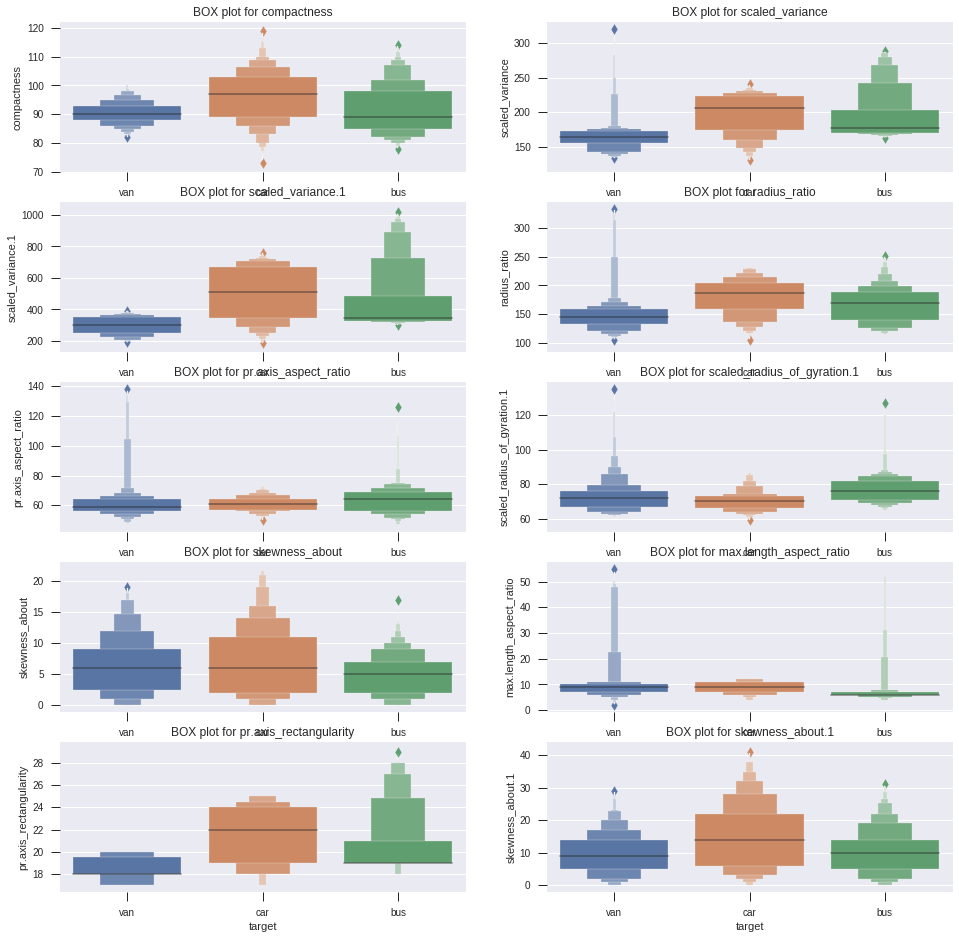

In [57]:
#### Let us plot the box plot for the outlier features that we just detected #####
##################################################################################

boxen_plot_series(imputed_df, outlier_features, 2, "target")

##### Like we found in outlier detection function, those features detected has evident outlier either below Q1-1.5 IQR or, above Q3+1.5 IQR which is very evident from the BOX plots above - CONFIRMS THE PRESENCE OF OUTLIERS.

In [58]:
##### START OUTLIER TREATMENT ##################
row_index, column_index, outlier_features

(array([  4,   4,   4,  37,  37,  37,  37,  44,  85, 100, 100, 100, 123,
        132, 135, 135, 135, 135, 291, 291, 321, 321, 388, 388, 388, 388,
        388, 391, 396, 513, 516, 523, 523, 623, 687, 687, 706, 706, 706,
        733, 761, 835, 835, 835]),
 array([ 4,  5, 13,  3,  4,  5, 13,  0, 11,  4,  5, 13, 14, 15,  3,  4,  5,
        13,  4,  5, 10, 11,  3,  4,  5, 10, 13,  5, 10, 15, 14,  4,  5, 14,
        10, 11,  4,  5, 13, 10, 14,  8, 10, 11]),
 ['compactness',
  'radius_ratio',
  'pr.axis_aspect_ratio',
  'max.length_aspect_ratio',
  'pr.axis_rectangularity',
  'scaled_variance',
  'scaled_variance.1',
  'scaled_radius_of_gyration.1',
  'skewness_about',
  'skewness_about.1'])

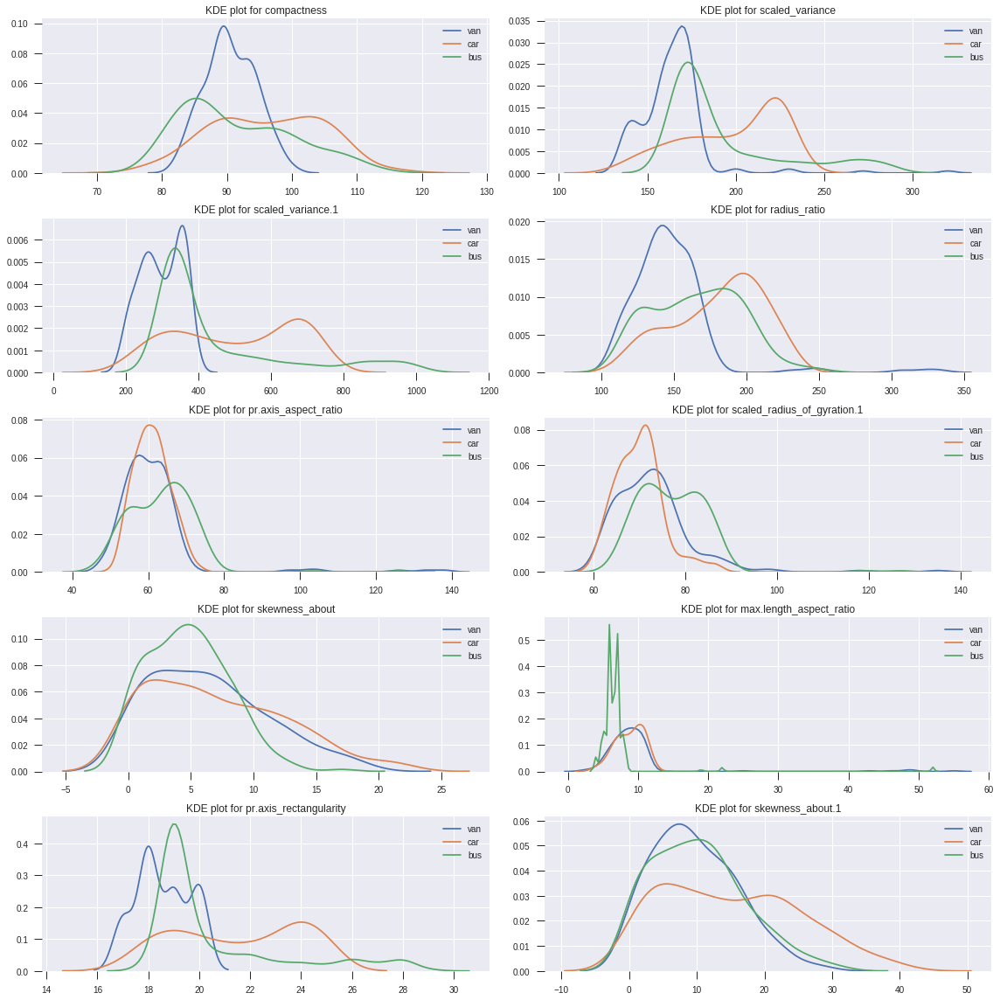

In [59]:
################################################################
######## Inspecting the distribution of outlier features #######
################################################################
dist_plot_series(imputed_df,outlier_features, 2, "target")
plt.tight_layout()
plt.show()

#### Immediate Observation : 
Atleast one of the target variables is right or left skewed for each of the outliers features, very evident outliers impact to the feature space - let us proceed further and see how to treat these outliers

In [60]:
##### Small utility function to make outlier values as NAN #####

def make_outliers_null(X, row_index, column_index):
    for index, val in enumerate(row_index):        
       
        X[row_index[index]][column_index[index]] = np.nan
        
    return X;

In [61]:
###### OUTLIER IMPUTER ########################
###############################################
def treat_outliers(X, row_index, column_index) :
    X = make_outliers_null(X, row_index, column_index)
    outliers_imputer = IterativeImputer(random_state=0, estimator= KNeighborsRegressor(n_neighbors=3))
    X = outliers_imputer.fit_transform(X)
    imputed_df = pd.DataFrame(data=X, columns=numerical_features)
    return imputed_df, X;

### Above Outlier Imputer is designed to replace the outlier with nearest neighbor value like we did for NULL values. In this way, we can still retain other valuable information from that row of outlier. Since we only have 846 records, it is important for us to retain information as much as possible without dropping them

In [62]:
########## Replacing the NAN of outliers with value imputed from nearest neighbor ##########
imputed_df, X = treat_outliers(X, row_index, column_index) 
imputed_df = pd.concat([imputed_df, y_df], axis=1)
imputed_df.head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,target
0,95.0,48.0,83.0,178.0,72.000000,10.0,162.0,42.0,20.0,159.0,176.0,379.0,184.0,70.000000,6.0,16.0,187.0,197.0,van
1,91.0,41.0,84.0,141.0,57.000000,9.0,149.0,45.0,19.0,143.0,170.0,330.0,158.0,72.000000,9.0,14.0,189.0,199.0,van
2,104.0,50.0,106.0,209.0,66.000000,10.0,207.0,32.0,23.0,158.0,223.0,635.0,220.0,73.000000,14.0,9.0,188.0,196.0,car
3,93.0,41.0,82.0,159.0,63.000000,9.0,144.0,46.0,19.0,143.0,160.0,309.0,127.0,63.000000,6.0,10.0,199.0,207.0,van
4,85.0,44.0,70.0,205.0,72.666667,16.0,149.0,45.0,19.0,144.0,241.0,325.0,188.0,85.666667,9.0,11.0,180.0,183.0,bus


In [63]:
##### Post imputation - it does not shows ANY NULL, meaning outliers are treated ########
imputed_df[imputed_df.isnull().any(axis=1)].head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,target


In [64]:
row_index_new, column_index_new, outlier_features_new = detect_outliers(X, imputed_df)

#### VERIFYING whether outliers are gone after first round of imputation through nearest neighbors 
Hence calling the detect outliers routine iteratively till we get satisfactory results

In [65]:
print("############### BEGIN ITERATION 2 - Outliers Imputation #############")
outlier_features_new

############### BEGIN ITERATION 1 - Outliers Imputation #############


['max.length_aspect_ratio', 'scaled_variance.1', 'skewness_about']

#### Looks like, outlier features are reduced but still we find THREE more features with outlier values. Let us continue the SAME ABOVE steps in iteration fashion till outliers are completely GONE. This is very important, as ONLY one iteration may not be enough

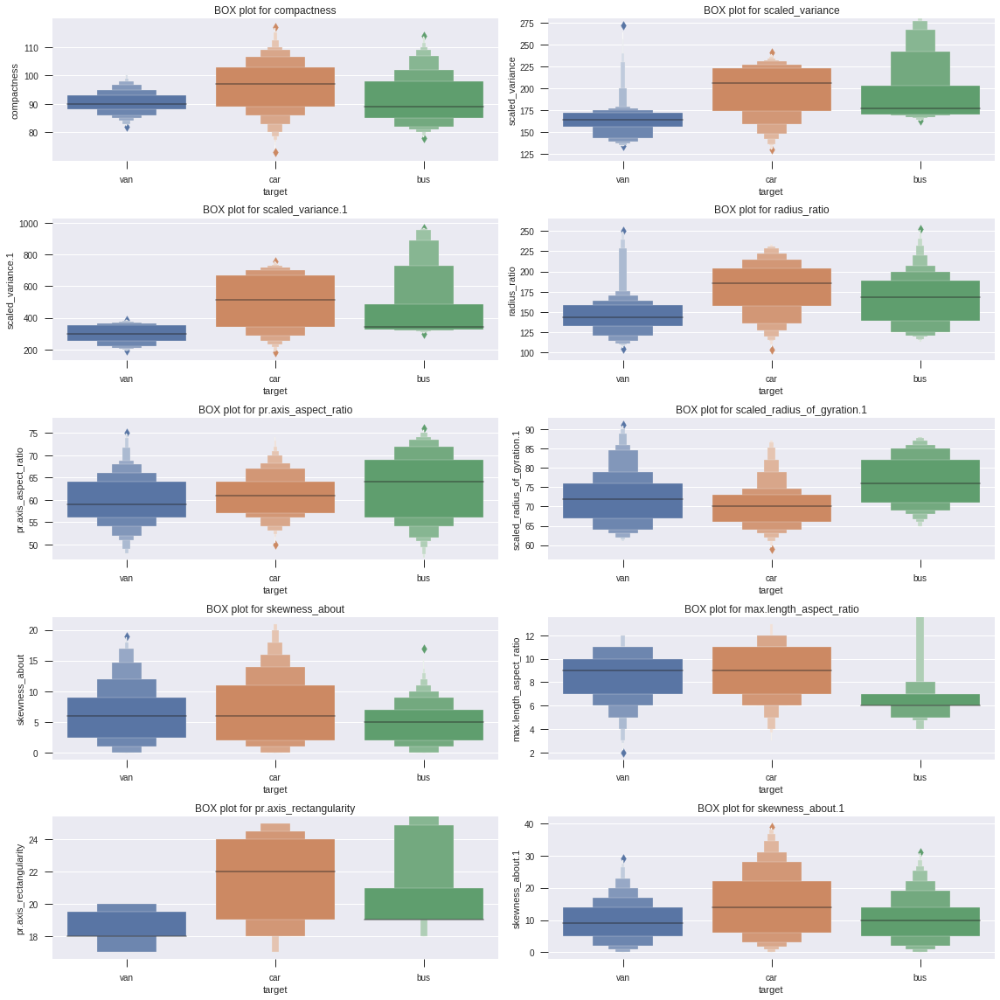

In [66]:
############################################################
#### BOX PLOT AFTER FIRST LEVEL OF OUTLIERS TREATEMENT #####
############################################################

boxen_plot_series(imputed_df, outlier_features, 2, "target")
plt.tight_layout()
plt.show()

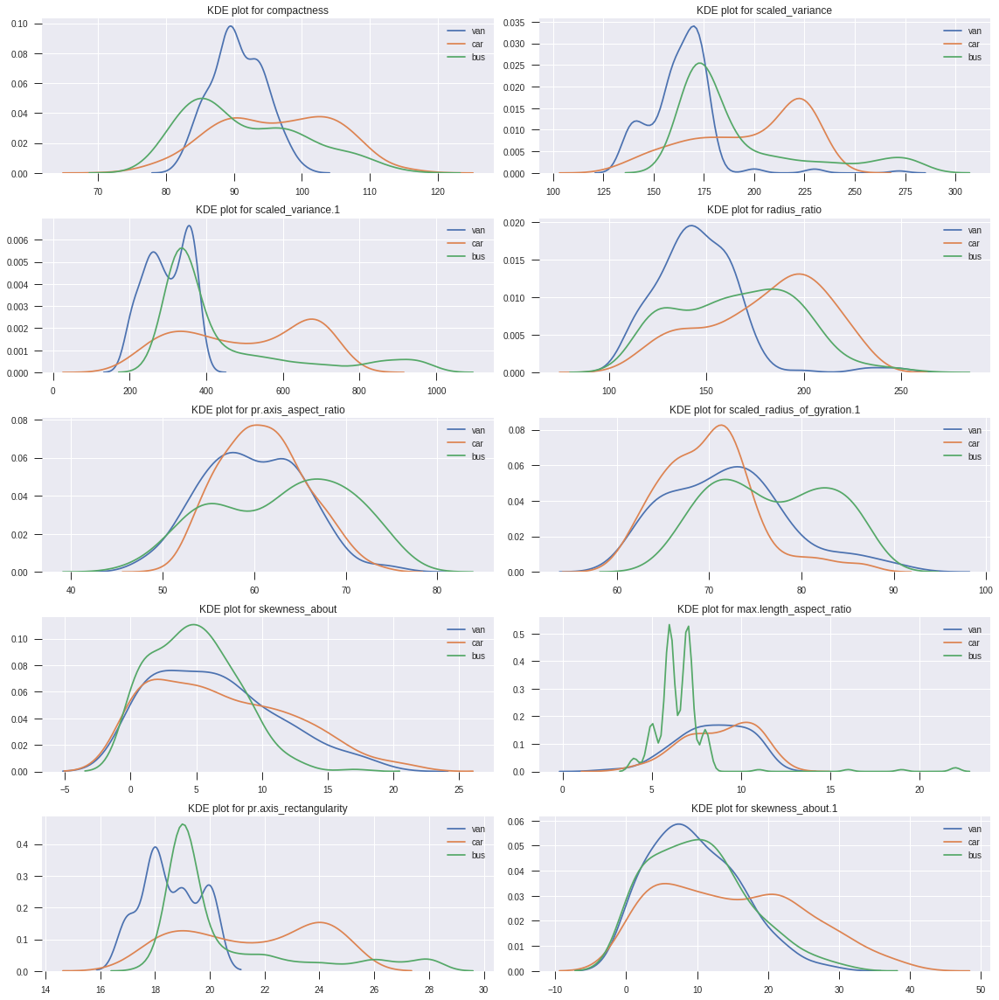

In [67]:
############################################################
#### KDE PLOT AFTER FIRST LEVEL OF OUTLIERS TREATEMENT #####
############################################################

dist_plot_series(imputed_df,outlier_features, 2, "target")
plt.tight_layout()
plt.show()

#### observation : 

Immediate observation from box plot is, outliers are getting reduced. This is also very evident from corresponding distribution plots where distribution curve gets lot better compared to original data (details of every outlier before vs after is explained in details below)


In [68]:
print("############### BEGIN ITERATION 2 - Outliers Imputation #############")
imputed_df, X = treat_outliers(X, row_index_new, column_index_new) 
imputed_df = pd.concat([imputed_df, y_df], axis=1)
row_index_new, column_index_new, outlier_features_new = detect_outliers(X, imputed_df)
print("############### Outliers after treating - SECOND iteration #############")
outlier_features_new

############### BEGIN ITERATION 2 - Outliers Imputation #############
############### Outliers after treating - SECOND iteration #############


[]

#### This is pefect - OUTLIERS ARE GONE!! DATA IS FREE FROM NULL AND OUTLIER VALUES!!

In [69]:
######################################################################################
#### Utility plot to compare a feature before and after outlier treatement ###########
######################################################################################
def compare_outliers_plot(before_train_df, imputed_train_df, before_target, after_target, feature ):
    
    f, axes = plt.subplots(2, 2, figsize=(14, 6), sharex=False)

    sns.catplot(x=before_target, y=feature, kind="boxen", data=before_train_df,
                        ax=axes[0,0])

    sns.catplot(x=after_target, y=feature, kind="boxen", data=imputed_train_df,
                        ax=axes[0,1])
    
    sns.FacetGrid(train_df, hue=before_target, size=5) \
        .map(sns.kdeplot, feature, ax=axes[1,0]) \
        .add_legend()
    
    sns.FacetGrid(imputed_train_df, hue=after_target, size=5) \
        .map(sns.kdeplot, feature, ax=axes[1,1]) \
        .add_legend()

    axes[0,0].set_title("Box BEFORE Outlier treatement for " + feature)
    axes[0,1].set_title("Box AFTER Outlier treatement for " + feature)
    axes[1,0].set_title("KDE BEFORE Outlier treatement for " + feature)
    axes[1,1].set_title("KDE AFTER Outlier treatement for " + feature)

    plt.close(2)
    plt.close(3)
    plt.close(4)
    plt.close(5)
    plt.tight_layout()

In [70]:
#### Recapping the Outlier Features #####
outlier_features

['compactness',
 'radius_ratio',
 'pr.axis_aspect_ratio',
 'max.length_aspect_ratio',
 'pr.axis_rectangularity',
 'scaled_variance',
 'scaled_variance.1',
 'scaled_radius_of_gyration.1',
 'skewness_about',
 'skewness_about.1']

##################################################################################################
############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for compactness ###################
##################################################################################################


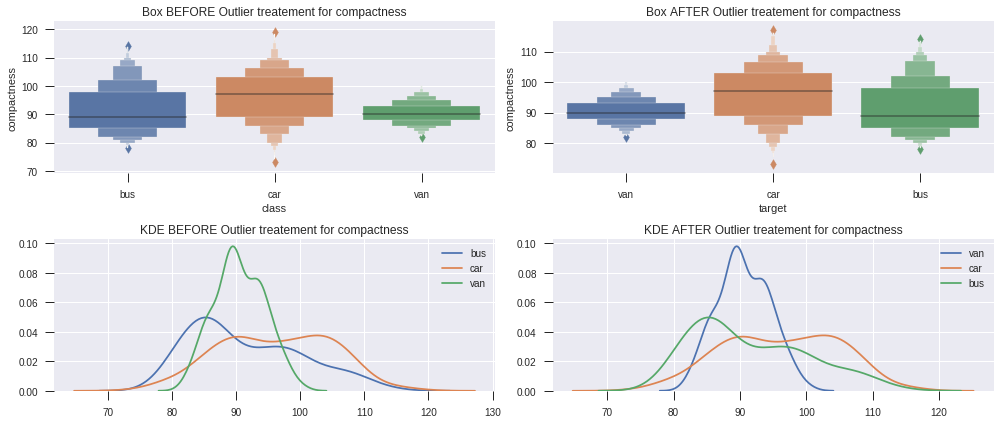

In [71]:
print("##################################################################################################")
print("############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for compactness ###################")
print("##################################################################################################")
compare_outliers_plot(train_df, imputed_df, "class", "target", "compactness")

1. Observation for van and car - outliers are lightly reduced, if you observe sharply on the tail to the right hand side of above distribution plot
2. Also, each of car, bus and van data seem to have atleast two different categories within them - from the observation of couple of peaks in each of those categories

##################################################################################################
############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for scaled_variance.1 #############
##################################################################################################


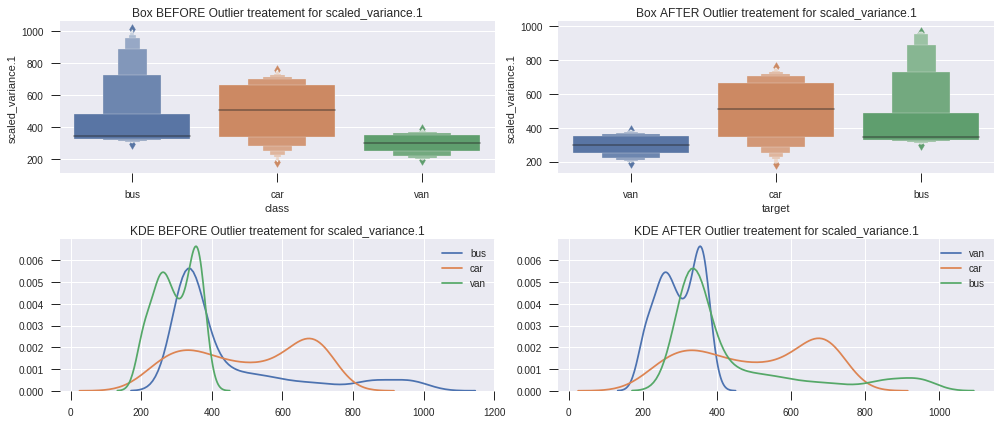

In [72]:
print("##################################################################################################")
print("############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for scaled_variance.1 #############")
print("##################################################################################################")
compare_outliers_plot(train_df, imputed_df, "class", "target", "scaled_variance.1")

1. outlier for class bus is reduced to small extent 
2. they still do not represent perfect normal distribution and this data also, like compactness represent multimodal peaks indicating the possibility of different categories(may be sub-classes) within each target variables

##################################################################################################
############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for skewness_about###### ##########
##################################################################################################


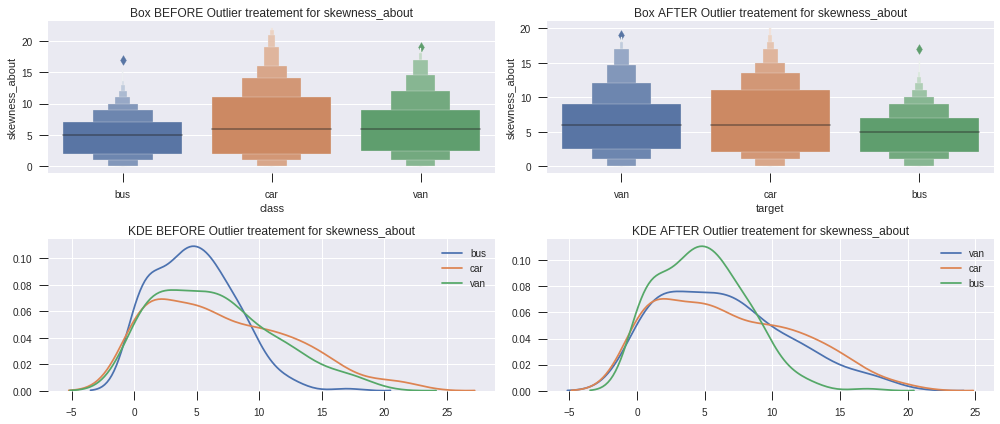

In [73]:
print("##################################################################################################")
print("############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for skewness_about###### ##########")
print("##################################################################################################")
compare_outliers_plot(train_df, imputed_df, "class", "target", "skewness_about")

outliers of both van and car are reduced relatively

##################################################################################################
############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for radius_ratio###################
##################################################################################################


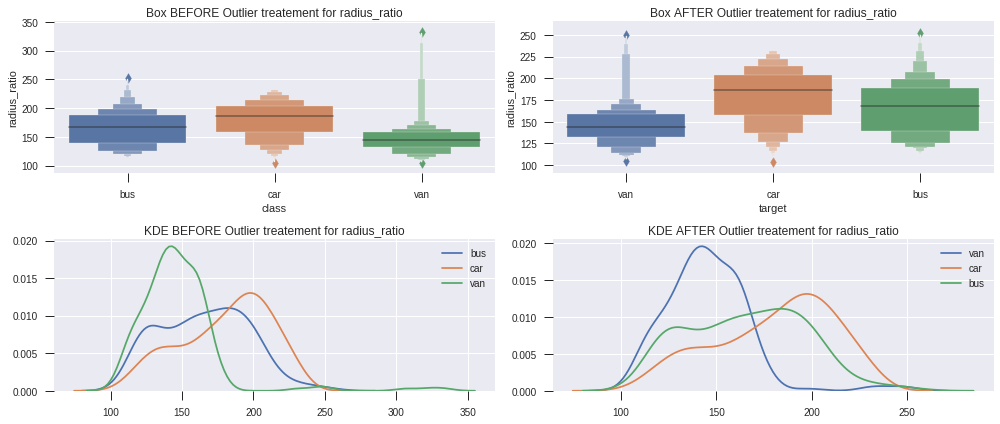

In [74]:
print("##################################################################################################")
print("############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for radius_ratio###################")
print("##################################################################################################")
compare_outliers_plot(train_df, imputed_df, "class", "target", "radius_ratio")

1. From the above plots, distribution of car and bus got definitely better
2. Outliers of both bus and van are very well reduced

##################################################################################################
############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for pr.axis_rectangularity#########
##################################################################################################


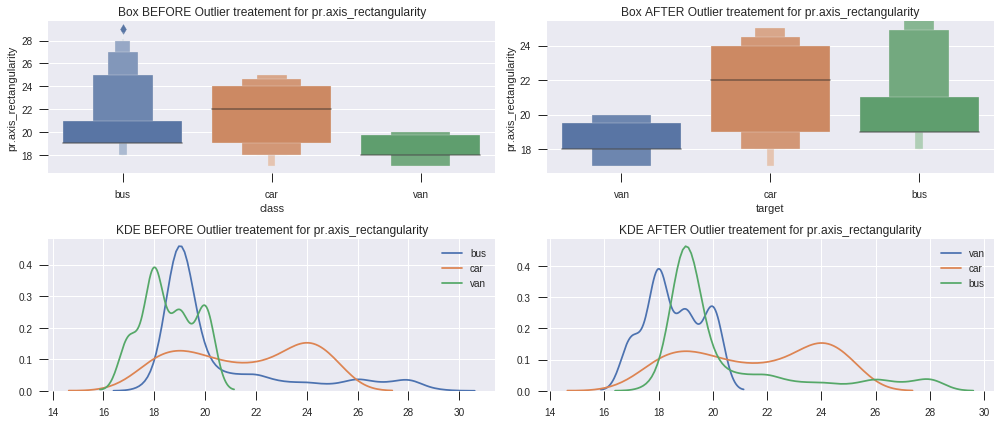

In [75]:
print("##################################################################################################")
print("############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for pr.axis_rectangularity#########")
print("##################################################################################################")
compare_outliers_plot(train_df, imputed_df, "class", "target", "pr.axis_rectangularity")

Outliers for bus is reduced to some extent

##################################################################################################
############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for pr.axis_aspect_ratio###########
##################################################################################################


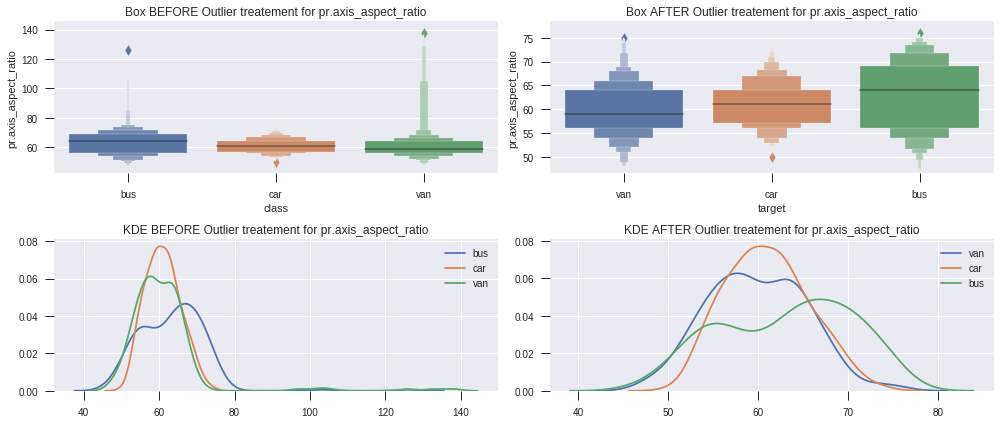

In [76]:
print("##################################################################################################")
print("############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for pr.axis_aspect_ratio###########")
print("##################################################################################################")
compare_outliers_plot(train_df, imputed_df, "class", "target", "pr.axis_aspect_ratio")

1. Of all the other features where this outlier treatment was applied, improvement in feature 'axis aspect ratio' is very significantly visible
2. Outliers of all the 3 classes - bus, van and car are reduced to great extent

##################################################################################################
############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for max.length_aspect_ratio########
##################################################################################################


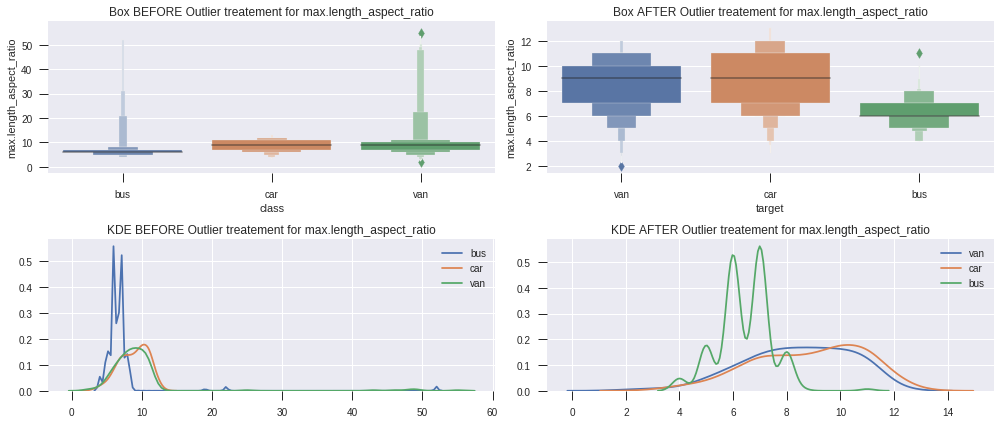

In [77]:
print("##################################################################################################")
print("############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for max.length_aspect_ratio########")
print("##################################################################################################")
compare_outliers_plot(train_df, imputed_df, "class", "target", "max.length_aspect_ratio")

1. Like axis_axpect_ratio, improvement in feature 'MAX length aspect ratio' is very significantly visible
2. Outliers of all the 3 classes - bus, van and car are reduced to great extent

##################################################################################################
############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for scaled_radius_of_gyration.1####
##################################################################################################


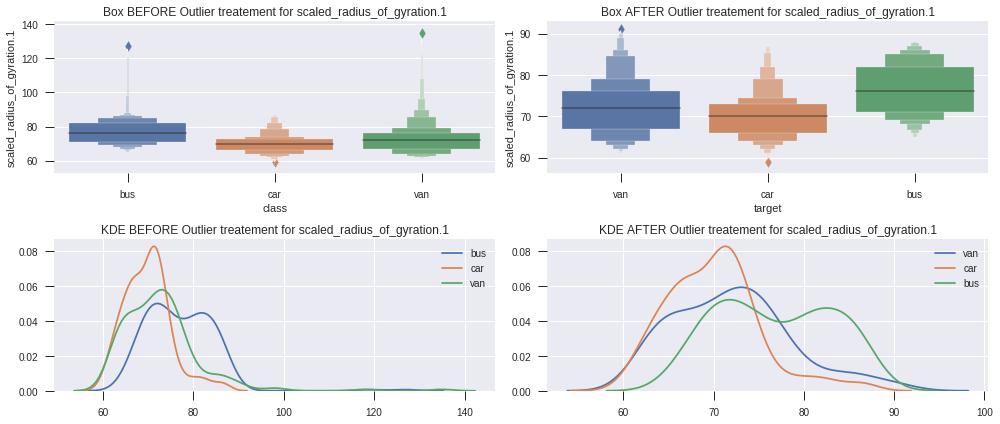

In [78]:
print("##################################################################################################")
print("############### COMPARISON BEFORE AND AFTER OUTLIER TREATEMENT for scaled_radius_of_gyration.1####")
print("##################################################################################################")
compare_outliers_plot(train_df, imputed_df, "class", "target", "scaled_radius_of_gyration.1")

Similar to axis_aspect_ratio and max_length_aspect_ratio, scaled radius of gyration is also showing very significant reduction of outliers with distribution getting better. Outliers seems to have reduced significantly, which is good

### CHECKPOINT : 
###### OUTLIERS TREATMENT COMPLETE, NULL VALUE TREATMENT COMPLETE & WE KNOW AT THIS POINT THAT WE HAVE COLLINEAR FEATURES TO GET RID OFF FOR BUILDING GENERALIZED MODEL

In [79]:
#### Putting together the cleansed data into Imputed dataframe object for further model development phase ####
##############################################################################################################

imputed_df['target'].unique()

array(['van', 'car', 'bus'], dtype=object)

In [80]:
#### Instead of text based targets, replacing with class numbers 0, 1, 2 #####

imputed_df.replace({'van': 0, 'car': 1, 'bus': 2}, inplace=True)
imputed_df.head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,target
0,95.0,48.0,83.0,178.0,72.000000,10.000000,162.0,42.0,20.0,159.0,176.0,379.0,184.0,70.000000,6.0,16.0,187.0,197.0,0
1,91.0,41.0,84.0,141.0,57.000000,9.000000,149.0,45.0,19.0,143.0,170.0,330.0,158.0,72.000000,9.0,14.0,189.0,199.0,0
2,104.0,50.0,106.0,209.0,66.000000,10.000000,207.0,32.0,23.0,158.0,223.0,635.0,220.0,73.000000,14.0,9.0,188.0,196.0,1
3,93.0,41.0,82.0,159.0,63.000000,9.000000,144.0,46.0,19.0,143.0,160.0,309.0,127.0,63.000000,6.0,10.0,199.0,207.0,0
4,85.0,44.0,70.0,205.0,72.666667,8.555556,149.0,45.0,19.0,144.0,241.0,325.0,188.0,85.666667,9.0,11.0,180.0,183.0,2


In [81]:
############### CHECK POINT - This dataframe 'imputed_df' now has cleansed data without null/outliers ########

In [ ]:
####################################################################################################
############ HIGH LEVEL SUMMARY ON STEPS - MODEL BUILDING ##########################################
####################################################################################################
############# 1) Feature selection, 2) Check for multi collinearity(vif) 3) Dimension reduction ####
### 4a) Vanilla Model 4b) Model with hyper parameters 4c) Ensemble of models #######################
#### 4d) Performance evaluation across every model in 4 a through c ################################
####################################################################################################
######################### BELOW ARE YET TO BE DONE #################################################
#### 5) Model serialization (pickle) 6) Model deployment(exposing as API) (5 & 6 YET TO BE DONE)####
####################################################################################################

In [82]:
#####################################################################################
#### Inspecting the Five Number Summary one more time ###############################
########## just to make sure we do not see anything incorrect post transformation####
#####################################################################################

imputed_df.describe().T

,count,mean,std,min,25%,50%,75%,max
compactness,846.0,93.668243,8.208284,73.0,87.00,93.000000,100.0,117.0
circularity,846.0,44.864362,6.170494,33.0,40.00,44.000000,49.0,59.0
distance_circularity,846.0,82.095745,15.771036,40.0,70.00,80.000000,98.0,112.0
radius_ratio,846.0,168.518519,32.314577,104.0,141.00,167.000000,195.0,252.0
pr.axis_aspect_ratio,846.0,61.262510,5.717645,47.0,57.00,61.000000,65.0,76.0
max.length_aspect_ratio,846.0,8.112950,2.083486,2.0,7.00,8.000000,10.0,13.0
scatter_ratio,846.0,168.840130,33.243577,112.0,146.25,157.000000,198.0,265.0
elongatedness,846.0,40.934102,7.811567,26.0,33.00,43.000000,46.0,61.0
pr.axis_rectangularity,846.0,20.581560,2.588521,17.0,19.00,20.000000,23.0,28.0
max.length_rectangularity,846.0,147.998818,14.515652,118.0,137.00,146.000000,159.0,188.0


##### Very evident that outlier values that we saw in MAX has been brought down near IQR and this is important for us to keep data clean without outliers and null values to prevent poor model fits 

In [83]:
### Inspecting Numerical Features ####
numerical_features

['compactness',
 'circularity',
 'distance_circularity',
 'radius_ratio',
 'pr.axis_aspect_ratio',
 'max.length_aspect_ratio',
 'scatter_ratio',
 'elongatedness',
 'pr.axis_rectangularity',
 'max.length_rectangularity',
 'scaled_variance',
 'scaled_variance.1',
 'scaled_radius_of_gyration',
 'scaled_radius_of_gyration.1',
 'skewness_about',
 'skewness_about.1',
 'skewness_about.2',
 'hollows_ratio']

In [84]:
#### Splitting the train data into X and Y ###########
X = imputed_df.loc[:, numerical_features+categorical_features]
y = np.array(imputed_df.loc[:, ['target']]).reshape(-1,1)
X.shape, y.shape

((846, 18), (846, 1))

In [85]:
### CONFIGURING THE BASE MODELS TO TRAIN ###

dict_classifiers = {
    "Logistic Regression": LogisticRegression(n_jobs=-1),    
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(n_jobs=-1),       
    "AdaBoostClassifier": AdaBoostClassifier(),
    "GradientBoostingClassifier": GradientBoostingClassifier(),
    "knn": KNeighborsClassifier(n_jobs=-1),
    "Support Vector": svm.SVC()
    }

In [86]:
######################################################
###### BASE MODEL TRAINING LOGIC #####################
######################################################
def bulk_train(X_train, Y_train, X_test, Y_test, no_classifiers = 5, verbose = True):
    model_list_pickle = {}
    
    for classifier_name, classifier in list(dict_classifiers.items())[:no_classifiers]:
        start_time = time.clock()
        if verbose:
            print("Training {c} - Start ".format(c=classifier_name))       
        classifier.fit(X_train, np.ravel(Y_train,order='C'))
        end_time = time.clock()        
        total_time_to_train = end_time - start_time
        train_score = classifier.score(X_train, Y_train)
        test_score = classifier.score(X_test, Y_test)
        if verbose:
            print(train_score, test_score)
        
        ############# Also GOING TO CROSS VALIDATE ##############
        from sklearn.model_selection import cross_val_score
        accuracies_cv= cross_val_score(estimator = classifier, X = X_train, y = Y_train, cv = 10)
        accuracies_cv_mean=accuracies_cv.mean()*100
        print("%s : Mean Accuracy from CV is %s %%"%(classifier_name,accuracies_cv_mean))
        accuracies_cv_std=accuracies_cv.std()*100
        print("%s : Standard Deviation from CV %s %%"%(classifier_name,accuracies_cv_std))
        ################# END OF CROSS VALIDATE #################
        
        model_list_pickle[classifier_name] = {'model': classifier, 
                                              'train_score': train_score, 
                                              'test_score': test_score, 
                                              'train_time': total_time_to_train,
                                              'crossval_avg_accuracy': accuracies_cv_mean,
                                              'crossval_std': accuracies_cv_std
                                             }
        
        if verbose:
            print("trained {c} in {f:.2f} s".format(c=classifier_name, f=total_time_to_train))
            
    return model_list_pickle

In [87]:
######################################################
#### FUNCTION TO RECORD MODEL METRICS AS DATAFRAME ###
######################################################
def print_confusion_matrix(model_list, X_test):
    cls_key = [key for key in model_list.keys()]
    cm_df_values = [[]]
    cm_df_cols = ['classifer', 'True_Positive', 'True_Negative', 'False_Postive', 'False_Negative',
                  'Train_AccuracyScore','Test_AccuracyScore', 'CrossVal_Accuracy%', 'CrossVal_STD']
    for i in range(0, len(cls_key)):
        predictions = model_list[cls_key[i]]['model'].predict(X_test)
        cm = confusion_matrix(y_test, predictions)
        cr = classification_report(y_test, predictions)
        print("\n###### Confusion Matrix Summary for [%s] ######\n"%(cls_key[i]))
        print(cm)
        print("\n###### Classification Report for [%s] ######\n"%(cls_key[i]))
        print(cr)
        if (i == 0) :
            cm_df_values = [[cls_key[i], cm[1,1], cm[0,0], cm[0,1], cm[1,0],
                            model_list[cls_key[i]]['train_score'], model_list[cls_key[i]]['test_score'],
                            model_list[cls_key[i]]['crossval_avg_accuracy'], model_list[cls_key[i]]['crossval_std']]]
        else :            
            cm_df_values = cm_df_values + [[cls_key[i], cm[1,1], cm[0,0], cm[0,1], cm[1,0],
                                           model_list[cls_key[i]]['train_score'], model_list[cls_key[i]]['test_score'],
                                           model_list[cls_key[i]]['crossval_avg_accuracy'], model_list[cls_key[i]]['crossval_std']]]
       
    cm_df = pd.DataFrame(data=cm_df_values, columns=cm_df_cols)
    print("\n###### Exiting Confusion Matrix Summary ######\n")
    return cm_df

In [88]:
#################################################
### Function to summary the model training ######
#################################################

def log_train_summary(model_list, sort_by='test_score'):
    cls_key = [key for key in model_list.keys()]
    test_local = [model_list[key]['test_score'] for key in cls_key]
    training_local = [model_list[key]['train_score'] for key in cls_key]
    training_time_local = [model_list[key]['train_time'] for key in cls_key]
    
    df_ = pd.DataFrame(data=np.zeros(shape=(len(cls_key),4)), columns = ['classifier', 'train_score', 'test_score', 'train_time'])
    for i in range(0,len(cls_key)):
        df_.loc[i, 'classifier'] = cls_key[i]
        df_.loc[i, 'train_score'] = training_local[i]
        df_.loc[i, 'test_score'] = test_local[i]
        df_.loc[i, 'train_time'] = training_time_local[i]
    
    #overriding the sort clause passed in function to get list of sort criteria for now
    print(df_.sort_values(by=['test_score','train_score'], ascending=False))

In [89]:
######################################################
################ Util Function for AUC ROC Curve #####
######################################################

from sklearn.metrics import f1_score, roc_auc_score, roc_curve
def generate_auc_roc_curve(clf, X_test):
    y_pred_proba = clf.predict_proba(X_test)[:, 1]
    fpr, tpr, thresholds = roc_curve(y_test,  y_pred_proba)
    auc = roc_auc_score(y_test, y_pred_proba)
    plt.plot(fpr,tpr,label="AUC ROC Curve with Area Under the curve ="+str(auc))
    plt.legend(loc=4)
    plt.show()
    pass

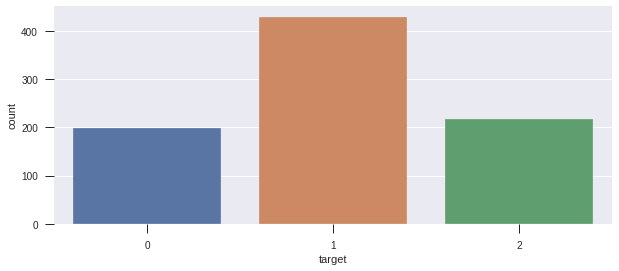

In [90]:
# Visualizing population of target

plt.figure(figsize=(10, 4))
sns.countplot(imputed_df['target'])
plt.show()

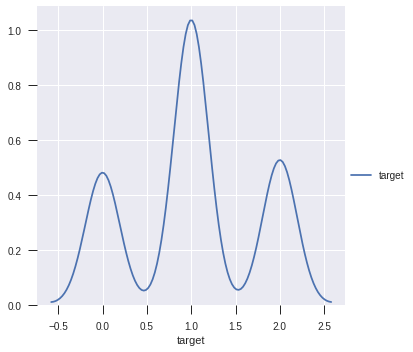

In [91]:
# Distribution of Target for each of the class - bus, van and car
plot_kde (imputed_df, "target")

##### All the three classes seem okay at glance in terms of distribution near to uniform distribution within each class i.e. mean being close to median for the datapoints of each of those class labels 0, 1 and 2 corresponding to 3 modal peaks overall

In [92]:
################# Get Ready for the Model Training ##########
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=42)

In [93]:
### Training with Different BASE Models #######################################
###############################################################################

models_list = bulk_train(X_train, y_train, X_test, y_test, no_classifiers = 7, verbose=False)
print("\n")
print("############ CONSOLIDATED MODEL TRAINING SUMMARY ############")
print("############### ######################## ###################")
log_train_summary(models_list)
print("############### ######################## ###################")

Logistic Regression : Mean Accuracy from CV is 95.43484301194776 %
Logistic Regression : Standard Deviation from CV 2.1569868174049867 %
Decision Tree : Mean Accuracy from CV is 89.51931091969992 %
Decision Tree : Standard Deviation from CV 4.220904926638989 %
Random Forest : Mean Accuracy from CV is 93.73437065851626 %
Random Forest : Standard Deviation from CV 3.800467798894 %
AdaBoostClassifier : Mean Accuracy from CV is 81.55876632397889 %
AdaBoostClassifier : Standard Deviation from CV 8.318265193107848 %
GradientBoostingClassifier : Mean Accuracy from CV is 93.5871075298694 %
GradientBoostingClassifier : Standard Deviation from CV 3.441585603902149 %
knn : Mean Accuracy from CV is 84.1233676021117 %
knn : Standard Deviation from CV 2.8413628054293225 %
Support Vector : Mean Accuracy from CV is 52.534037232564614 %
Support Vector : Standard Deviation from CV 0.02500694637399326 %


############ CONSOLIDATED MODEL TRAINING SUMMARY ############
############### ######################

In [94]:
print("############### ######################## ###################")
#### Printing Confusion Matrix #####
confusion_matrix_df = print_confusion_matrix(models_list, X_test)


############### ######################## ###################

###### Confusion Matrix Summary for [Logistic Regression] ######

[[ 56   2   0]
 [  2 111   5]
 [  2   0  76]]

###### Classification Report for [Logistic Regression] ######

              precision    recall  f1-score   support

           0       0.93      0.97      0.95        58
           1       0.98      0.94      0.96       118
           2       0.94      0.97      0.96        78

    accuracy                           0.96       254
   macro avg       0.95      0.96      0.96       254
weighted avg       0.96      0.96      0.96       254


###### Confusion Matrix Summary for [Decision Tree] ######

[[ 50   7   1]
 [  3 110   5]
 [  0   3  75]]

###### Classification Report for [Decision Tree] ######

              precision    recall  f1-score   support

           0       0.94      0.86      0.90        58
           1       0.92      0.93      0.92       118
           2       0.93      0.96      0.94        78

In [95]:
confusion_matrix_df

,classifer,True_Positive,True_Negative,False_Postive,False_Negative,Train_AccuracyScore,Test_AccuracyScore,CrossVal_Accuracy%,CrossVal_STD
0,Logistic Regression,111,56,2,2,0.969595,0.956693,95.434843,2.156987
1,Decision Tree,110,50,7,3,1.000000,0.925197,89.519311,4.220905
2,Random Forest,113,53,5,4,0.996622,0.937008,93.734371,3.800468
3,AdaBoostClassifier,110,50,7,4,0.888514,0.850394,81.558766,8.318265
4,GradientBoostingClassifier,116,52,5,2,1.000000,0.940945,93.587108,3.441586
5,knn,106,49,5,7,0.902027,0.834646,84.123368,2.841363
6,Support Vector,118,1,57,0,1.000000,0.468504,52.534037,0.025007


### Summary of Base Model - RAW DATA, NO PCA, NO SCALING, NO HYPER PARAMETERS

##### Evaluation Criteria : F1 Score to identify individual vehicle types - Car, Bus, Van

1. Logistics Regression - Class 1 (0.96), Class 2 (0.97), class 3 (0.96)
2. Decision Tree - Class 1 (0.91), Class 2 (0.93), Class 3 (0.95)
3. Random Forest - Class 1 (0.91), Class 2 (0.95), Class 3 (0.97)
4. AdaBoost - Class 1 (0.82), Class 2 (0.83), Class 3 (0.78)
5. Gradient Boost - Class 1 (0.93), Class 2 (0.94), Class 3 (0.94)
6. KNN - Class 1 (0.84), Class 2 (0.85), Class 3 (0.79)
7. SVM - Class 1 (0.03), Class 2(0.64), Class 3 (0.00)

##### Conclusion :- some models even though they show high/better F1 score like Logistics Regression which is having > 96% of identifying the vehicles, these are deceptive scores. Remember the collinearity which we saw in our EDAs? Those have to be treated to get better generalized model. We will go ahead and start our model optimization.

In [96]:
#############################################################################
#### This function is dedicated for invoking post grid search ###############
####### will print confusion matrix, classification report in F1 scores #####
#############################################################################

def print_confusion_classification_gridsearch(best_estimator, X_train, y_train, X_test, y_test, models_trained=[], scaled=False, pca=False, verbose=True):
    
    model_index = 0
    if(scaled == True and pca == True):
        if(verbose == True):
            print("Inside PCA and Scaler included in grid search <%s, %s>"%(scaled, pca))
        transformed_X_train = best_estimator[1].transform(best_estimator[0].transform(X_train))
        transformed_X_test = best_estimator[1].transform(best_estimator[0].transform(X_test))
        if(verbose == True):
            print("Features reduced to : [%s]"%(transformed_X_train.shape[1]))
        model_index = 2
    
    if(scaled == True and pca == False):
        if(verbose == True):
            print("Inside ONLY Scaler included in grid search <%s, %s>"%(scaled, pca))
        transformed_X_train = best_estimator[0].transform(X_train)
        transformed_X_test = best_estimator[0].transform(X_test)
        model_index = 1
    
    if(scaled == False and pca == False):
        if(verbose == True):
            print("Inside ONLY model parameters in grid search - NO scaler and NO PCA <%s, %s>"%(scaled, pca))
        transformed_X_train = X_train
        transformed_X_test = X_test
        
    temp_model = best_estimator[model_index].fit(transformed_X_train, y_train)
    temp_pred = temp_model.predict(transformed_X_test)
    
    cm = confusion_matrix(y_test, temp_pred)
    cr = classification_report(y_test, temp_pred)
    if(verbose == True):
        print("\n###### Confusion Matrix Summary for UNSEEN Test Data ######\n")
        print(cm)
        print("\n###### Classification Report for UNSEEN Test Data ######\n")
        print(cr)
    
    return (models_trained + [best_estimator[model_index]]), transformed_X_train, transformed_X_test

In [97]:
###########################################################################################################
##### Utility function to plot PCA - describing the covered explained variance with each feature steps ####
###########################################################################################################
def plot_PCA(pca_component):
    
    tuned_pca = pca_component
    variance_sum = np.cumsum(tuned_pca.explained_variance_ratio_)*100
    steps = [n for n in range(len(variance_sum))]
    plt.figure(figsize=(6, 6))
    plt.plot(steps,variance_sum, color = 'green',label='cumulative explained variance')
    plt.title('###### PCA PLOT OF [%s] FEATURE COMPONENTS ######\n'%(len(variance_sum)))
    plt.ylabel('Cumulative Explained variance')
    plt.xlabel('Principal components')
    plt.axhline(y = 95, color='k', linestyle='--', label = '95% Explained Variance')
    plt.legend(loc='best')
    
    return variance_sum, len(variance_sum)

In [98]:
def pca_scatter_plot(X, Y, target, data, seaborn_flag=False, size=6):
    
    if(seaborn_flag==True):
        sns.FacetGrid(data, hue=target, size=size) \
            .map(plt.scatter, X, Y) \
            .add_legend()

    else :
        
        plt.scatter(data[X].values, data[Y].values,
                c=data[target].values, edgecolor='none', alpha=0.5,
                cmap=plt.cm.get_cmap('brg', 3))
        plt.xlabel('principal component 1')
        plt.ylabel('principal component 2')
        plt.colorbar();
    
    return

In [99]:
############################################
##### Visualizing PCA as scatter plot ######
############################################
def visualize_pca(X, y, seaborn_flag=False,size=6):
    
    temp_1 = pd.DataFrame(X)
    temp_1 = temp_1.add_prefix('Dim_')
    temp_2 = pd.DataFrame(y, columns=['target'])
    temp_3 = pd.concat([temp_1, temp_2], axis=1)
    
    pca_scatter_plot("Dim_0", "Dim_1", "target", temp_3, seaborn_flag, size=size)
    
    return temp_3;

In [100]:
############################################
##### Visualizing PCA as 3D plot ###########
### Inputs require 3 dimensional feature ###
############################################
from mpl_toolkits.mplot3d import Axes3D
def visualize_pca3D(X, y):
    
    temp_1 = pd.DataFrame(X)
    temp_1 = temp_1.add_prefix('Dim_')
    temp_2 = pd.DataFrame(y, columns=['target'])
    temp_3 = pd.concat([temp_1, temp_2], axis=1)
    ax = plt.figure(figsize=(14,8)).gca(projection='3d')
    ### Making 3D plot work even for 2D feature space ###
    z = [0]
    if (X.shape[1] > 2):
        z = temp_3['Dim_2'].values
    
    ax.scatter(
        xs=temp_3['Dim_0'].values, 
        ys=temp_3['Dim_1'].values, 
        zs=z, 
        c=temp_3['target'], 
        cmap='tab10'
    )
    ax.set_xlabel('first PCA component')
    ax.set_ylabel('second PCA component')
    ax.set_zlabel('third PCA component')
    plt.show()

In [101]:
###############################################################################################################
## Utility function to fetch already trained estimator details in grid search without having to retrain #######
###############################################################################################################
def get_X_Transformed_traintest_gridsearch(grid_estimator, X_train, y_train, X_test, y_test, scaled_flag=True, pca_flag=True, verbose=True):
    grid_model=[]
    if(verbose == True):
        print(scaled_flag, pca_flag)
    grid_model, X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(grid_estimator.best_estimator_, \
                                          X_train, y_train, X_test, y_test, grid_model, scaled_flag, pca_flag, verbose)
    
    return grid_model, X_train_transformed, X_test_transformed

In [102]:
def plot_crossval_graph(best_grid_search_model, x_range) :
    ### Extract mean score, standard deviation from the best fit model ###
    scores_avg = np.array(best_grid_search_model.cv_results_['mean_test_score'])
    scores_std = best_grid_search_model.cv_results_['std_test_score']
    ### This is masked array, hence we need to use filled to convert this to normal array
    x_crange = best_grid_search_model.cv_results_[x_range].filled()
    std_error = scores_std / np.sqrt(n_folds)
    
    scores_avg = np.array(best_grid_search_model.cv_results_['mean_test_score'])
    #print(scores_avg.shape)
    scores_std = best_grid_search_model.cv_results_['std_test_score']
    ### This is masked array, hence we need to use filled to convert this to normal array
    x_crange = best_grid_search_model.cv_results_[x_range].filled()
    #print(x_crange.shape)
    std_error = scores_std / np.sqrt(n_folds)
    plt.figure().set_size_inches(12, 10)
    plt.semilogx(x_crange, scores_avg)
    
    plt.semilogx(x_crange, scores_avg + std_error, 'r--')
    plt.semilogx(x_crange, scores_avg - std_error, 'r--')
    plt.ylabel('CV score +/- std error')
    plt.xlabel('Range of C - Plotting GridSearch CV')
    plt.axhline(np.max(scores_avg), linestyle='--', color='green')
    plt.xlim([x_crange[0], x_crange[-1]])

### MODEL 1 - HYPER PARAMETER TUNING OF LOGISTICS REGRESSION AND SVM ####

In [103]:
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
n_folds = 5
pipe = Pipeline([
    ('model_gs' , LogisticRegression())
])

param_grid_models = [
    {'model_gs' : [LogisticRegression(class_weight='balanced')],
     'model_gs__penalty' : ['l2'],
     'model_gs__C' : [0.001, 0.01, 0.1, 
                      1, 10, 40, 50, 200],
    'model_gs__solver' : ['liblinear']
    },
    {'model_gs' : [svm.SVC()],
    'model_gs__C': [0.01, 0.05, 0.5, 1],
    'model_gs__gamma': [0.001, 0.01, 0.1, 1],
    'model_gs__kernel': ['linear', 'poly', 'rbf']}
]

#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)

In [104]:
best_clf_1 = grid.fit(X_train, y_train)

Fitting 5 folds for each of 56 candidates, totalling 280 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 280 out of 280 | elapsed:    3.2s finished


In [105]:
best_clf_1.best_estimator_

Pipeline(memory=None,
         steps=[('model_gs',
                 SVC(C=0.01, cache_size=200, class_weight=None, coef0=0.0,
                     decision_function_shape='ovr', degree=3, gamma=0.001,
                     kernel='poly', max_iter=-1, probability=False,
                     random_state=None, shrinking=True, tol=0.001,
                     verbose=False))],
         verbose=False)

In [106]:
best_clf_1.best_score_

0.9611486486486487

#### Plotting the graph for grid search - Average of Test Scores +/- Standard Deviation : 
This would give a rough idea about the test scores across all the iterations. Would give an idea on how best the model is able to fit in test iterations for unseen data

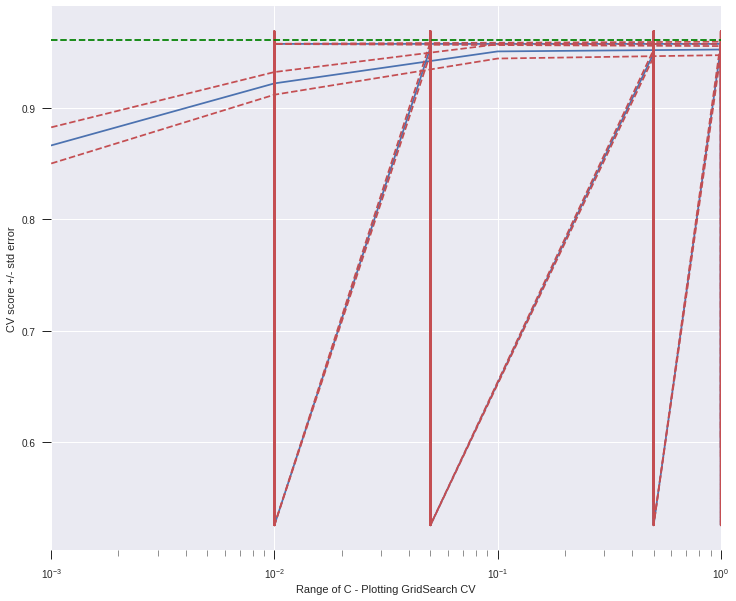

In [107]:
plot_crossval_graph(best_clf_1, 'param_model_gs__C')

#### Evaluation of Model 1 - Confusion Matrix, Classification Reports, F1 score assessment :

In [108]:
tuned_models_list = []
tuned_models_list, \
X_train_transformed, X_test_transformed = print_confusion_classification_gridsearch(best_clf_1.best_estimator_, \
                                          X_train, y_train, X_test, y_test, \
                                          tuned_models_list, scaled=False, pca=False )

Inside ONLY model parameters in grid search - NO scaler and NO PCA <False, False>

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 55   2   1]
 [  2 114   2]
 [  2   2  74]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.93      0.95      0.94        58
           1       0.97      0.97      0.97       118
           2       0.96      0.95      0.95        78

    accuracy                           0.96       254
   macro avg       0.95      0.95      0.95       254
weighted avg       0.96      0.96      0.96       254



In [109]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list

[SVC(C=0.01, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovr', degree=3, gamma=0.001, kernel='poly',
     max_iter=-1, probability=False, random_state=None, shrinking=True,
     tol=0.001, verbose=False)]

### Model 2 - ONLY Logistics Regression Hyper parameter tuning of Logistic Regression (NO scaling, NO PCA)

In [110]:
n_folds = 5
pipe = Pipeline([
    
    ('model_gs' , LogisticRegression())
])

param_grid_models = [
    {'model_gs' : [LogisticRegression(class_weight='balanced')],
     'model_gs__penalty' : ['l2'],
     'model_gs__C' : [0.001, 0.01, 0.1, 
                      1, 10, 40, 50, 200],
    'model_gs__solver' : ['newton-cg', 'sag', 'saga', 'lbfgs'],
     'model_gs__multi_class': ['multinomial']
    }
]

#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)

In [111]:
best_clf_2 = grid.fit(X_train, y_train)

Fitting 5 folds for each of 32 candidates, totalling 160 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done 160 out of 160 | elapsed:    2.4s finished


In [112]:
best_clf_2.best_estimator_

Pipeline(memory=None,
         steps=[('model_gs',
                 LogisticRegression(C=0.1, class_weight='balanced', dual=False,
                                    fit_intercept=True, intercept_scaling=1,
                                    l1_ratio=None, max_iter=100,
                                    multi_class='multinomial', n_jobs=None,
                                    penalty='l2', random_state=None,
                                    solver='newton-cg', tol=0.0001, verbose=0,
                                    warm_start=False))],
         verbose=False)

In [113]:
best_clf_2.best_score_

0.9527027027027027

#### Plotting the graph for grid search - Average of Test Scores +/- Standard Deviation :
This would give a rough idea about the test scores across all the iterations. Would give an idea on how best the model is able to fit in test iterations for unseen data

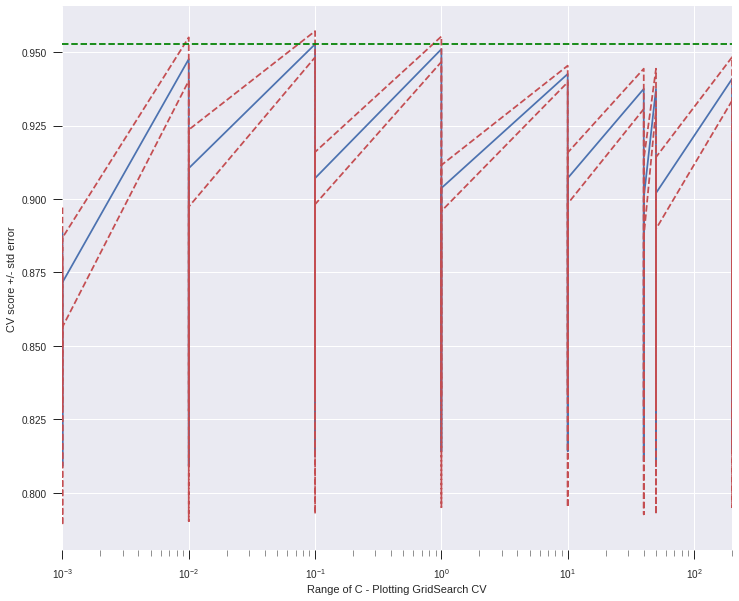

In [114]:
plot_crossval_graph(best_clf_2, 'param_model_gs__C')

#### Evaluation of Model 2 - Confusion Matrix, Classification Reports, F1 score assessment

In [115]:
tuned_models_list, \
X_train_transformed, X_test_transformed = print_confusion_classification_gridsearch(best_clf_2.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=False, pca=False)

Inside ONLY model parameters in grid search - NO scaler and NO PCA <False, False>

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 56   2   0]
 [  1 111   6]
 [  0   0  78]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.98      0.97      0.97        58
           1       0.98      0.94      0.96       118
           2       0.93      1.00      0.96        78

    accuracy                           0.96       254
   macro avg       0.96      0.97      0.97       254
weighted avg       0.97      0.96      0.96       254



In [116]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list

[SVC(C=0.01, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovr', degree=3, gamma=0.001, kernel='poly',
     max_iter=-1, probability=False, random_state=None, shrinking=True,
     tol=0.001, verbose=False),
 LogisticRegression(C=0.1, class_weight='balanced', dual=False,
                    fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                    max_iter=100, multi_class='multinomial', n_jobs=None,
                    penalty='l2', random_state=None, solver='newton-cg',
                    tol=0.0001, verbose=0, warm_start=False)]

In [117]:
#### TO BE NOTED - WE HAVE NOT SCALED ANY OF THE FEATURES YET!! #####
X_train.head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio
300,106.0,53.0,98.0,193.0,60.0,10.0,215.0,31.0,24.0,169.0,224.0,681.0,218.0,73.0,8.0,21.0,188.0,197.0
73,73.0,37.0,53.0,111.0,54.0,6.0,126.0,55.0,18.0,128.0,135.0,227.0,147.0,82.0,1.0,15.0,176.0,184.0
586,98.0,55.0,108.0,168.0,53.0,11.0,224.0,30.0,25.0,178.0,231.0,737.0,217.0,73.0,8.0,30.0,187.0,198.0
753,91.0,36.0,72.0,162.0,60.0,8.0,150.0,44.0,19.0,133.0,166.0,334.0,121.0,63.0,2.0,22.0,196.0,205.0
405,88.0,40.0,73.0,173.0,68.0,7.0,150.0,44.0,19.0,137.0,174.0,341.0,151.0,69.0,2.0,20.0,196.0,200.0


### Model 3 - Hyper Parameter tuning of scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models :

In [118]:
from sklearn.preprocessing import StandardScaler, RobustScaler, QuantileTransformer

n_folds = 5
scaling_options = [StandardScaler(), RobustScaler(), QuantileTransformer()]
pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('model_gs' , LogisticRegression())
])

param_grid_models = [
    {'scaler': scaling_options,
     'model_gs' : [LogisticRegression(class_weight='balanced')],
     'model_gs__penalty' : ['l2'],
     'model_gs__C' : [0.001, 0.01, 0.1, 
                      1, 10, 40, 50, 200],
    'model_gs__solver' : ['newton-cg', 'sag', 'saga', 'lbfgs'],
     'model_gs__multi_class': ['multinomial'],
     'model_gs__random_state': [42]
    },
    {'scaler': scaling_options,
     'model_gs' : [svm.SVC()],
    'model_gs__C': [0.01, 0.05, 0.5, 1],
    'model_gs__gamma': [0.001, 0.01, 0.1, 1],
    'model_gs__kernel': ['linear', 'poly', 'rbf'],
    'model_gs__degree': [1,2,3],
    'model_gs__decision_function_shape': ['ovo'],
    'model_gs__random_state': [42]}
]

#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)

In [119]:
best_clf_3 = grid.fit(X_train, y_train)

Fitting 5 folds for each of 528 candidates, totalling 2640 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  48 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1848 tasks      | elapsed:    4.5s
[Parallel(n_jobs=-1)]: Done 2640 out of 2640 | elapsed:    6.0s finished


In [120]:
best_clf_3.best_estimator_

Pipeline(memory=None,
         steps=[('scaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('model_gs',
                 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
                     decision_function_shape='ovo', degree=1, gamma=0.1,
                     kernel='rbf', max_iter=-1, probability=False,
                     random_state=42, shrinking=True, tol=0.001,
                     verbose=False))],
         verbose=False)

#### Plotting the graph for grid search - Average of Test Scores +/- Standard Deviation :
This would give a rough idea about the test scores across all the iterations. Would give an idea on how best the model is able to fit in test iterations for unseen data

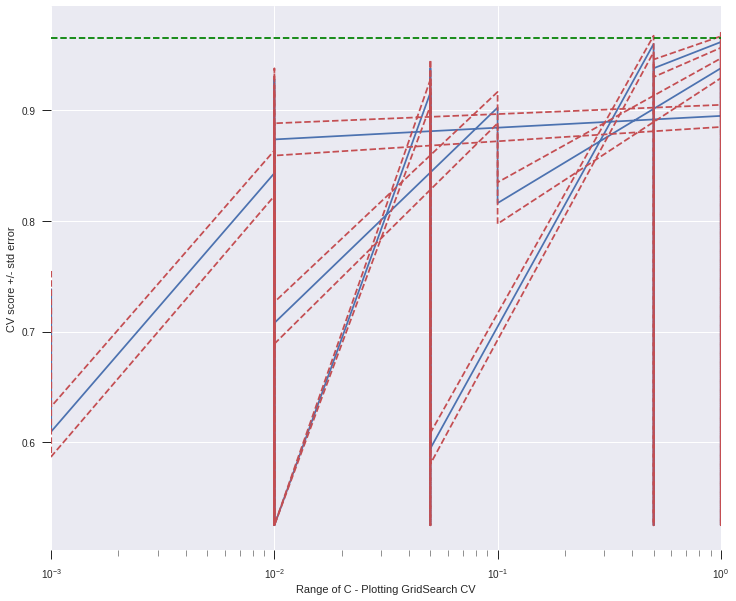

In [121]:
plot_crossval_graph(best_clf_3, 'param_model_gs__C')

#### Evaluation of Model 3 - Confusion Matrix, Classification Reports, F1 score assessment

In [122]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
######### NO PCA - TRAINING SVM WITHOUT PCA #################
#############################################################

tuned_models_list, \
X_train_transformed, X_test_transformed = print_confusion_classification_gridsearch(best_clf_3.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=True, pca=False)

Inside ONLY Scaler included in grid search <True, False>

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 54   4   0]
 [  1 116   1]
 [  2   1  75]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.95      0.93      0.94        58
           1       0.96      0.98      0.97       118
           2       0.99      0.96      0.97        78

    accuracy                           0.96       254
   macro avg       0.96      0.96      0.96       254
weighted avg       0.96      0.96      0.96       254



In [123]:
#### Inspecting whether transformed X we got, is scaled ######
X_train_transformed

array([[ 1.52092954,  1.33738104,  1.00011688, ...,  0.94448431,
        -0.15949954,  0.14652241],
       [-2.51889093, -1.2706118 , -1.8266637 , ...,  0.25885008,
        -2.08405961, -1.607189  ],
       [ 0.54157913,  1.66338014,  1.62829034, ...,  1.97293565,
        -0.31987955,  0.28142328],
       ...,
       [-1.41712171,  0.03338462, -0.88440351, ..., -1.45523548,
        -1.28215958, -1.607189  ],
       [-1.0498653 , -1.2706118 , -0.88440351, ...,  0.14457771,
         0.9631605 ,  0.95592767],
       [ 0.05190392, -0.45561404, -0.88440351, ..., -0.88387363,
         0.48202048,  0.01162153]])

In [124]:
best_clf_3.cv_results_

{'mean_fit_time': array([0.02025919, 0.01934543, 0.01706829, 0.00752573, 0.01023598,
        0.01589036, 0.01103096, 0.00987687, 0.02131314, 0.00958614,
        0.01004181, 0.01870503, 0.01873784, 0.0297174 , 0.02557135,
        0.01291895, 0.01887784, 0.0200839 , 0.01344213, 0.01609406,
        0.02400484, 0.01395583, 0.01347218, 0.02341475, 0.02996898,
        0.02971053, 0.03781395, 0.01446385, 0.01788087, 0.02697372,
        0.01706948, 0.01897025, 0.02098441, 0.02370477, 0.02196298,
        0.02948174, 0.03654013, 0.04029393, 0.04079599, 0.02842393,
        0.02683535, 0.03579555, 0.04493704, 0.04414692, 0.05650268,
        0.03896384, 0.0387536 , 0.04802918, 0.05247216, 0.0506948 ,
        0.05337782, 0.03637757, 0.04155717, 0.04797702, 0.04154954,
        0.05022874, 0.0508142 , 0.05125604, 0.05446811, 0.06076117,
        0.05157804, 0.05136704, 0.05383987, 0.03524709, 0.04012365,
        0.04497433, 0.04269233, 0.04524336, 0.05060678, 0.05008984,
        0.05469904, 0.06398373,

In [125]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list

[SVC(C=0.01, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovr', degree=3, gamma=0.001, kernel='poly',
     max_iter=-1, probability=False, random_state=None, shrinking=True,
     tol=0.001, verbose=False),
 LogisticRegression(C=0.1, class_weight='balanced', dual=False,
                    fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                    max_iter=100, multi_class='multinomial', n_jobs=None,
                    penalty='l2', random_state=None, solver='newton-cg',
                    tol=0.0001, verbose=0, warm_start=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001,
     verbose=False)]

### Model 4 - Hyper Parameter tuning of PCA(FINDING BEST NUMBER OF FEATURES BETWEEN 1 AND 15), parameter tuning of Scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models

In [126]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
######### TRAINING SVM WITH PCA ############################
#############################################################


from sklearn.decomposition import PCA

n_folds = 5
scaling_options = [StandardScaler(), RobustScaler(), QuantileTransformer()]
no_of_PCA_features = np.arange(1, 15)

pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('pca_reduction', PCA() ),
    ('model_gs' , LogisticRegression())
])

param_grid_models = [
    {'scaler': scaling_options,
     'pca_reduction': [PCA()],
     'pca_reduction__n_components': no_of_PCA_features,
     'model_gs' : [LogisticRegression(class_weight='balanced')],
     'model_gs__penalty' : ['l2'],
     'model_gs__C' : [0.001, 0.01, 0.1, 
                      1, 10, 40, 50, 200],
    'model_gs__solver' : ['newton-cg', 'sag', 'saga', 'lbfgs'],
     'model_gs__multi_class': ['multinomial'],
     'model_gs__random_state': [42]
    },
    {'scaler': scaling_options,
     'pca_reduction': [PCA()],
     'pca_reduction__n_components': no_of_PCA_features,
     'model_gs' : [svm.SVC()],
    'model_gs__C': [0.01, 0.05, 0.5, 1],
    'model_gs__gamma': [0.001, 0.01, 0.1, 1],
    'model_gs__kernel': ['linear', 'poly', 'rbf'],
    'model_gs__degree': [1,2,3],
    'model_gs__decision_function_shape': ['ovo'],
    'model_gs__random_state': [42]}
]

#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)

In [127]:
best_clf_4 = grid.fit(X_train, y_train)

Fitting 5 folds for each of 7392 candidates, totalling 36960 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  40 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1240 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 3240 tasks      | elapsed:    7.3s
[Parallel(n_jobs=-1)]: Done 6040 tasks      | elapsed:   16.6s
[Parallel(n_jobs=-1)]: Done 9640 tasks      | elapsed:   24.7s
[Parallel(n_jobs=-1)]: Done 14040 tasks      | elapsed:   34.1s
[Parallel(n_jobs=-1)]: Done 19240 tasks      | elapsed:   45.0s
[Parallel(n_jobs=-1)]: Done 25240 tasks      | elapsed:   58.6s
[Parallel(n_jobs=-1)]: Done 30640 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 34452 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done 36960 out of 36960 | elapsed:  3.9min finished


In [128]:
best_clf_4.best_estimator_

Pipeline(memory=None,
         steps=[('scaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('pca_reduction',
                 PCA(copy=True, iterated_power='auto', n_components=14,
                     random_state=None, svd_solver='auto', tol=0.0,
                     whiten=False)),
                ('model_gs',
                 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
                     decision_function_shape='ovo', degree=1, gamma=0.1,
                     kernel='rbf', max_iter=-1, probability=False,
                     random_state=42, shrinking=True, tol=0.001,
                     verbose=False))],
         verbose=False)

In [129]:
best_clf_4.best_score_

0.964527027027027

#### Plotting the graph for grid search - Average of Test Scores +/- Standard Deviation :
This would give a rough idea about the test scores across all the iterations. Would give an idea on how best the model is able to fit in test iterations for unseen data

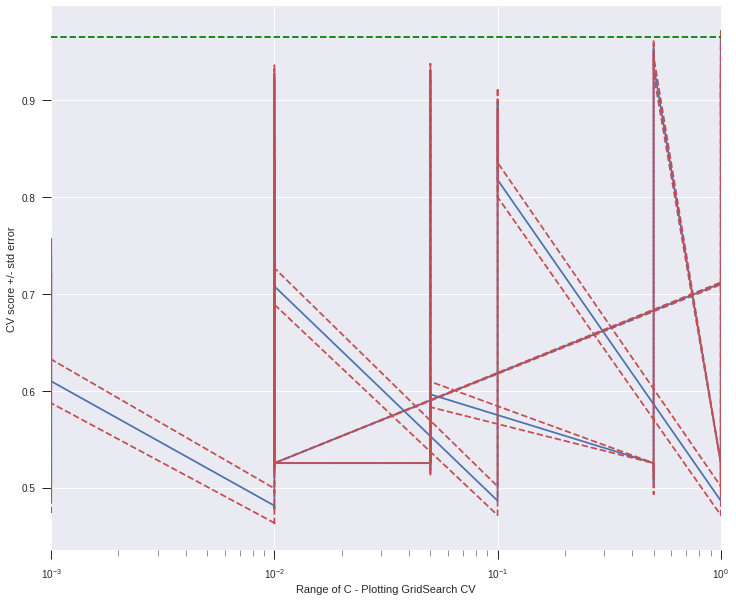

In [130]:
plot_crossval_graph(best_clf_4, 'param_model_gs__C')

#### Evaluation of Model 4 - Confusion Matrix, Classification Reports, F1 score assessment

In [131]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(best_clf_4.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=True, pca=True)

Inside PCA and Scaler included in grid search <True, True>
Features reduced to : [14]

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 54   4   0]
 [  1 116   1]
 [  2   1  75]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.95      0.93      0.94        58
           1       0.96      0.98      0.97       118
           2       0.99      0.96      0.97        78

    accuracy                           0.96       254
   macro avg       0.96      0.96      0.96       254
weighted avg       0.96      0.96      0.96       254



In [132]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list

[SVC(C=0.01, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovr', degree=3, gamma=0.001, kernel='poly',
     max_iter=-1, probability=False, random_state=None, shrinking=True,
     tol=0.001, verbose=False),
 LogisticRegression(C=0.1, class_weight='balanced', dual=False,
                    fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                    max_iter=100, multi_class='multinomial', n_jobs=None,
                    penalty='l2', random_state=None, solver='newton-cg',
                    tol=0.0001, verbose=0, warm_start=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001,
     verbose=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shri

###### Interesting, Hyper parameter tuning of models with & without PCA with scaled X is producing same outcome. Need to investigatge this further!!

In [133]:
#### Inspecting X transformation after Scaling and PCA ######
X_train_transformed, X_train_transformed.shape

(array([[-4.3169676 ,  0.86309799, -0.11519659, ...,  0.01162567,
         -0.0516722 , -0.07146037],
        [ 5.5396171 ,  2.64056989, -1.13556259, ...,  0.15191647,
          0.58315345,  0.11282031],
        [-4.73076795,  1.4721623 , -0.52002984, ..., -0.07427802,
          0.07431342,  0.1427789 ],
        ...,
        [ 2.27103359,  2.10855814,  0.40335673, ..., -0.21073789,
         -0.12234609, -0.03809532],
        [ 3.63501865, -2.23236784, -0.62925   , ...,  0.09807707,
          0.33725088,  0.05559474],
        [ 2.52909753, -1.0216811 ,  1.98597417, ...,  0.12830784,
         -0.01834938,  0.21520633]]), (592, 14))

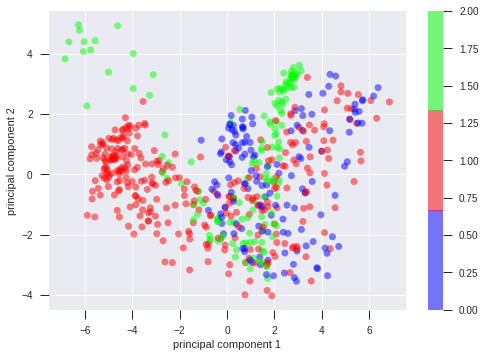

In [134]:
##### Visualizing PCA with respect to Target Class #####
########################################################
pca_df = visualize_pca(X_train_transformed, y_train)

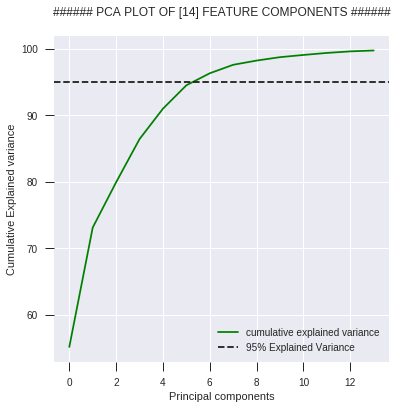

In [135]:
####### PLOT OF PCA ###########
variance_dist, no_of_pca_components = plot_PCA(best_clf_4.best_estimator_[1])

In [136]:
print("####### Coverage of Variance for [%s] components #######"%(no_of_pca_components))
variance_dist

####### Coverage of Variance for [14] components #######


array([55.16058331, 73.12916428, 79.95025493, 86.44683605, 91.02283275,
       94.5420829 , 96.35398295, 97.62906718, 98.26503679, 98.77861499,
       99.11006181, 99.41560869, 99.64748218, 99.78611739])

###### NOTE - this is interesting, seems like we can still reduce the number of components to 5-7 from 14

### Model 5 - Hyper Parameter tuning of PCA(FINDING BEST NUMBER OF FEATURES BETWEEN 1 AND 10), parameter tuning of Scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models

In [137]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
######### TRAINING SVM WITH PCA ############################
######################################################################################
#### LET US TUNE FURTHER - Adjusting number of features to 10 based on above PLOT ##
######################################################################################

n_folds = 5
scaling_options = [StandardScaler(), RobustScaler(), QuantileTransformer()]
no_of_PCA_features = np.arange(1, 10)

pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('pca_reduction', PCA() ),
    ('model_gs' , LogisticRegression())
])

param_grid_models = [
    {'scaler': scaling_options,
     'pca_reduction': [PCA()],
     'pca_reduction__n_components': no_of_PCA_features,
     'model_gs' : [LogisticRegression(class_weight='balanced')],
     'model_gs__penalty' : ['l2'],
     'model_gs__C' : [0.001, 0.01, 0.1, 
                      1, 10, 40, 50, 200],
    'model_gs__solver' : ['newton-cg', 'sag', 'saga', 'lbfgs'],
     'model_gs__multi_class': ['multinomial'],
     'model_gs__random_state': [42]
    },
    {'scaler': scaling_options,
     'pca_reduction': [PCA()],
     'pca_reduction__n_components': no_of_PCA_features,
     'model_gs' : [svm.SVC()],
    'model_gs__C': [0.01, 0.05, 0.5, 1],
    'model_gs__gamma': [0.001, 0.01, 0.1, 1],
    'model_gs__kernel': ['linear', 'poly', 'rbf'],
    'model_gs__degree': [1,2,3],
    'model_gs__decision_function_shape': ['ovo'],
    'model_gs__random_state': [42]}
]

#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)

In [138]:
best_clf_5 = grid.fit(X_train, y_train)

Fitting 5 folds for each of 4752 candidates, totalling 23760 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  52 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2152 tasks      | elapsed:    4.4s
[Parallel(n_jobs=-1)]: Done 5652 tasks      | elapsed:   11.6s
[Parallel(n_jobs=-1)]: Done 10552 tasks      | elapsed:   20.7s
[Parallel(n_jobs=-1)]: Done 16852 tasks      | elapsed:   34.2s
[Parallel(n_jobs=-1)]: Done 23026 tasks      | elapsed:   53.6s
[Parallel(n_jobs=-1)]: Done 23760 out of 23760 | elapsed:  3.3min finished


In [139]:
best_clf_5.best_estimator_

Pipeline(memory=None,
         steps=[('scaler',
                 RobustScaler(copy=True, quantile_range=(25.0, 75.0),
                              with_centering=True, with_scaling=True)),
                ('pca_reduction',
                 PCA(copy=True, iterated_power='auto', n_components=9,
                     random_state=None, svd_solver='auto', tol=0.0,
                     whiten=False)),
                ('model_gs',
                 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
                     decision_function_shape='ovo', degree=1, gamma=0.1,
                     kernel='rbf', max_iter=-1, probability=False,
                     random_state=42, shrinking=True, tol=0.001,
                     verbose=False))],
         verbose=False)

In [140]:
best_clf_5.best_score_

0.9510135135135135

#### Plotting the graph for grid search - Average of Test Scores +/- Standard Deviation :
This would give a rough idea about the test scores across all the iterations. Would give an idea on how best the model is able to fit in test iterations for unseen data

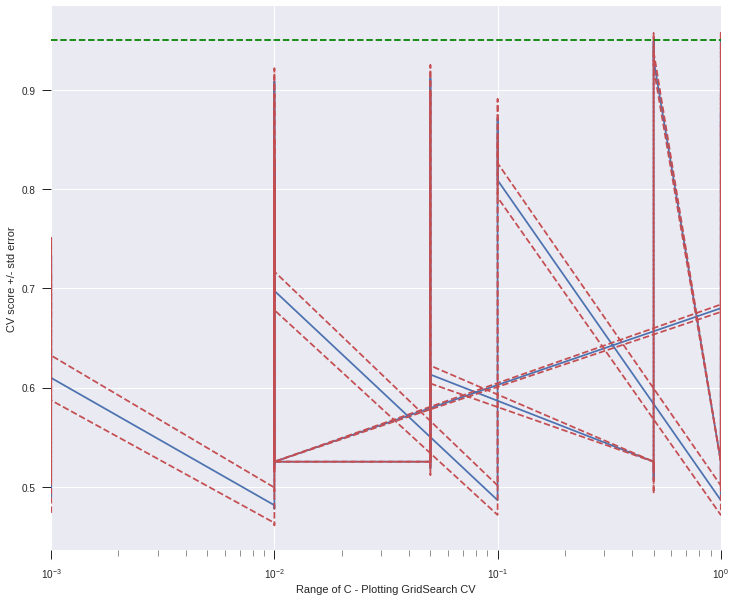

In [141]:
plot_crossval_graph(best_clf_5, 'param_model_gs__C')

#### Evaluation of Model 5 - Confusion Matrix, Classification Reports, F1 score assessment

In [142]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed = print_confusion_classification_gridsearch(best_clf_5.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=True, pca=True)

Inside PCA and Scaler included in grid search <True, True>
Features reduced to : [9]

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 51   3   4]
 [  2 115   1]
 [  2   1  75]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.93      0.88      0.90        58
           1       0.97      0.97      0.97       118
           2       0.94      0.96      0.95        78

    accuracy                           0.95       254
   macro avg       0.94      0.94      0.94       254
weighted avg       0.95      0.95      0.95       254



In [143]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list

[SVC(C=0.01, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovr', degree=3, gamma=0.001, kernel='poly',
     max_iter=-1, probability=False, random_state=None, shrinking=True,
     tol=0.001, verbose=False),
 LogisticRegression(C=0.1, class_weight='balanced', dual=False,
                    fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                    max_iter=100, multi_class='multinomial', n_jobs=None,
                    penalty='l2', random_state=None, solver='newton-cg',
                    tol=0.0001, verbose=0, warm_start=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001,
     verbose=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shri

In [144]:
##### Inspecting Transformed X after Scaling and PCA #######
X_train_transformed, X_train_transformed.shape

(array([[-2.77756374e+00,  6.51446026e-01,  2.61999970e-01, ...,
         -2.08627838e-01, -2.93158905e-01, -1.13338015e-04],
        [ 3.63919080e+00,  1.80610237e+00,  6.95464603e-01, ...,
         -2.05577454e-01,  3.80024596e-01, -1.22275143e-02],
        [-3.03745921e+00,  9.67785968e-01,  7.42409121e-01, ...,
         -6.70494487e-01,  2.87472054e-01,  4.45342244e-01],
        ...,
        [ 1.57876862e+00,  1.60497274e+00, -6.48275808e-01, ...,
         -2.17809336e-01,  2.55126354e-01, -2.74566394e-01],
        [ 2.25764895e+00, -1.72719433e+00,  3.91239919e-01, ...,
         -2.42011074e-01,  1.56990444e-01,  2.77074872e-03],
        [ 1.52797936e+00, -7.68517337e-01, -1.24153006e+00, ...,
         -3.77229218e-02, -3.82582635e-01, -3.52050998e-01]]), (592, 9))

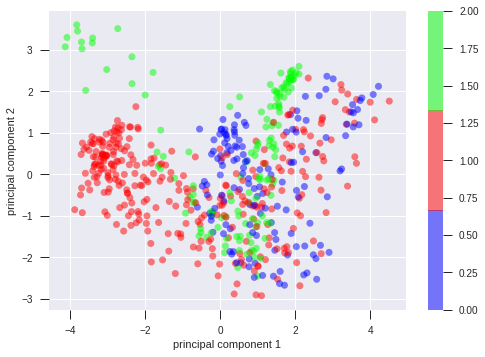

In [145]:
##### Visualizing PCA with respect to Target Class #####
########################################################
pca_df = visualize_pca(X_train_transformed, y_train)

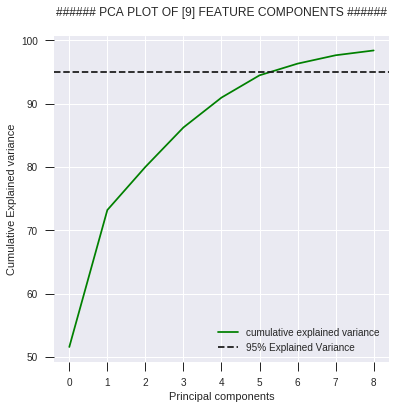

In [146]:
####### PLOT OF PCA ###########
variance_dist, no_of_pca_components = plot_PCA(best_clf_5.best_estimator_[1])

In [147]:
print("####### Coverage of Variance for [%s] components #######"%(no_of_pca_components))
variance_dist

####### Coverage of Variance for [9] components #######


array([51.56594114, 73.18677732, 79.99038458, 86.21795459, 90.93238774,
       94.44882081, 96.29403981, 97.61493863, 98.37227567])

### Model 6 - Hyper Parameter tuning of PCA(FINDING BEST NUMBER OF FEATURES BETWEEN 1 AND 12), parameter tuning of Scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models

In [148]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
######### TRAINING SVM WITH PCA ############################
######################################################################################
#### LET US TUNE FURTHER - Adjusting number of features to 12 based on above PLOT ####
############# Adding more hyper parameters for SVD SOLVER for PCA ####################
######################################################################################

n_folds = 5
scaling_options = [StandardScaler(), RobustScaler(), QuantileTransformer()]
no_of_PCA_features = np.arange(1, 12)

pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('pca_reduction', PCA() ),
    ('model_gs' , LogisticRegression())
])

param_grid_models = [
    {'scaler': scaling_options,
     'pca_reduction': [PCA()],
     'pca_reduction__n_components': no_of_PCA_features,
     'pca_reduction__svd_solver': ['full', 'arpack', 'randomized'],
     'model_gs' : [LogisticRegression(class_weight='balanced')],
     'model_gs__penalty' : ['l2'],
     'model_gs__C' : [0.001, 0.01, 0.1, 
                      1, 10, 40, 50, 200],
    'model_gs__solver' : ['newton-cg', 'sag', 'saga', 'lbfgs'],
     'model_gs__multi_class': ['multinomial'],
     'model_gs__random_state': [42]
    },
    {'scaler': scaling_options,
     'pca_reduction': [PCA()],
     'pca_reduction__n_components': no_of_PCA_features,
     'pca_reduction__svd_solver': ['full', 'arpack', 'randomized'],
     'model_gs' : [svm.SVC()],
    'model_gs__C': [0.01, 0.05, 0.5, 1],
    'model_gs__gamma': [0.001, 0.01, 0.1, 1],
    'model_gs__kernel': ['linear', 'poly', 'rbf'],
    'model_gs__degree': [1,2,3],
    'model_gs__decision_function_shape': ['ovo'],
    'model_gs__random_state': [42]}
]

#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)

In [149]:
best_clf_6 = grid.fit(X_train, y_train)
best_clf_6.best_estimator_, best_clf_6.best_score_

Fitting 5 folds for each of 17424 candidates, totalling 87120 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  52 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 2152 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-1)]: Done 5652 tasks      | elapsed:   10.9s
[Parallel(n_jobs=-1)]: Done 10552 tasks      | elapsed:   23.5s
[Parallel(n_jobs=-1)]: Done 16852 tasks      | elapsed:   40.9s
[Parallel(n_jobs=-1)]: Done 24552 tasks      | elapsed:   57.1s
[Parallel(n_jobs=-1)]: Done 33652 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 44152 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done 53497 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done 60147 tasks      | elapsed:  2.3min
[Parallel(n_jobs=-1)]: Done 67497 tasks      | elapsed:  2.5min
[Parallel(n_jobs=-1)]: Done 72037 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done 78200 tasks      | elapsed:  3.6min
[Parallel(n_jobs=-1)]: Done 87120 out of 87120 | elapsed:  7.7min finished


(Pipeline(memory=None,
          steps=[('scaler',
                  StandardScaler(copy=True, with_mean=True, with_std=True)),
                 ('pca_reduction',
                  PCA(copy=True, iterated_power='auto', n_components=11,
                      random_state=None, svd_solver='full', tol=0.0,
                      whiten=False)),
                 ('model_gs',
                  SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
                      decision_function_shape='ovo', degree=1, gamma=0.1,
                      kernel='rbf', max_iter=-1, probability=False,
                      random_state=42, shrinking=True, tol=0.001,
                      verbose=False))],
          verbose=False), 0.9527027027027027)

#### Plotting the graph for grid search - Average of Test Scores +/- Standard Deviation :
This would give a rough idea about the test scores across all the iterations. Would give an idea on how best the model is able to fit in test iterations for unseen data

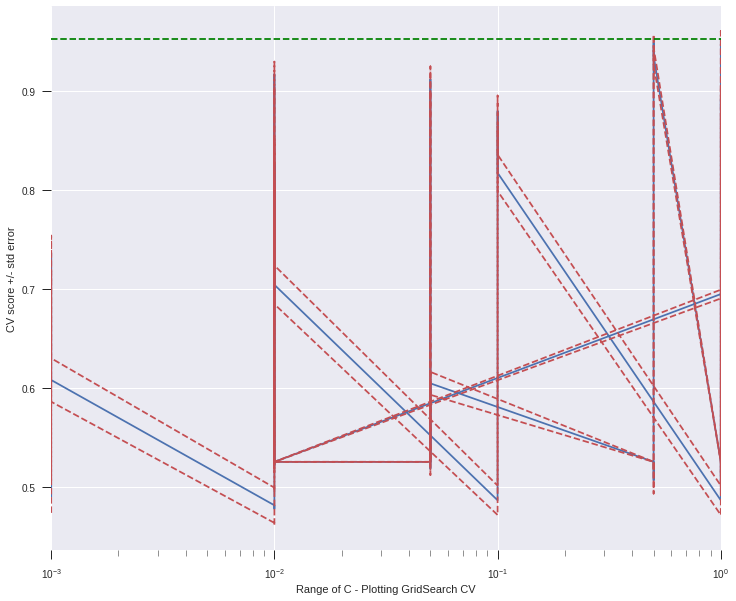

In [150]:
plot_crossval_graph(best_clf_6, 'param_model_gs__C')

#### Evaluation of Model 6 - Confusion Matrix, Classification Reports, F1 score assessment

In [151]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(best_clf_6.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=True, pca=True)

Inside PCA and Scaler included in grid search <True, True>
Features reduced to : [11]

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 55   3   0]
 [  2 114   2]
 [  1   3  74]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.95      0.95      0.95        58
           1       0.95      0.97      0.96       118
           2       0.97      0.95      0.96        78

    accuracy                           0.96       254
   macro avg       0.96      0.95      0.96       254
weighted avg       0.96      0.96      0.96       254



In [152]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list

[SVC(C=0.01, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovr', degree=3, gamma=0.001, kernel='poly',
     max_iter=-1, probability=False, random_state=None, shrinking=True,
     tol=0.001, verbose=False),
 LogisticRegression(C=0.1, class_weight='balanced', dual=False,
                    fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                    max_iter=100, multi_class='multinomial', n_jobs=None,
                    penalty='l2', random_state=None, solver='newton-cg',
                    tol=0.0001, verbose=0, warm_start=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001,
     verbose=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shri

In [153]:
##### Inspecting Transformed X after Scaling and PCA #######
X_train_transformed, X_train_transformed.shape

(array([[-4.31696760e+00,  8.63097992e-01, -1.15196587e-01, ...,
          5.40079795e-02,  2.97272358e-02, -2.28691095e-01],
        [ 5.53961710e+00,  2.64056989e+00, -1.13556259e+00, ...,
         -6.11469410e-02, -2.61220071e-01, -4.84021239e-01],
        [-4.73076795e+00,  1.47216230e+00, -5.20029836e-01, ...,
          6.19510856e-01, -3.50126887e-01,  2.84710210e-02],
        ...,
        [ 2.27103359e+00,  2.10855814e+00,  4.03356727e-01, ...,
         -3.27503449e-01, -4.80676000e-01,  5.50792236e-02],
        [ 3.63501865e+00, -2.23236784e+00, -6.29249999e-01, ...,
         -2.63730125e-03, -3.92910448e-01,  1.67194396e-01],
        [ 2.52909753e+00, -1.02168110e+00,  1.98597417e+00, ...,
         -4.16797365e-01, -6.80284581e-02,  2.48747971e-01]]), (592, 11))

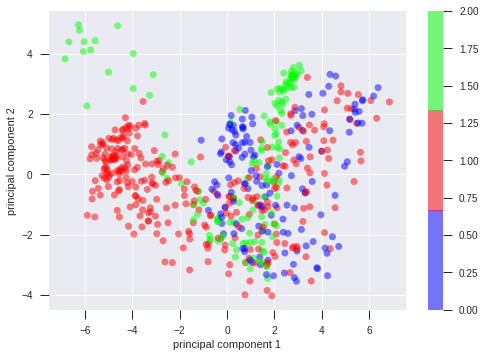

In [160]:
##### Visualizing PCA with respect to Target Class #####
########################################################
pca_df = visualize_pca(X_train_transformed, y_train)


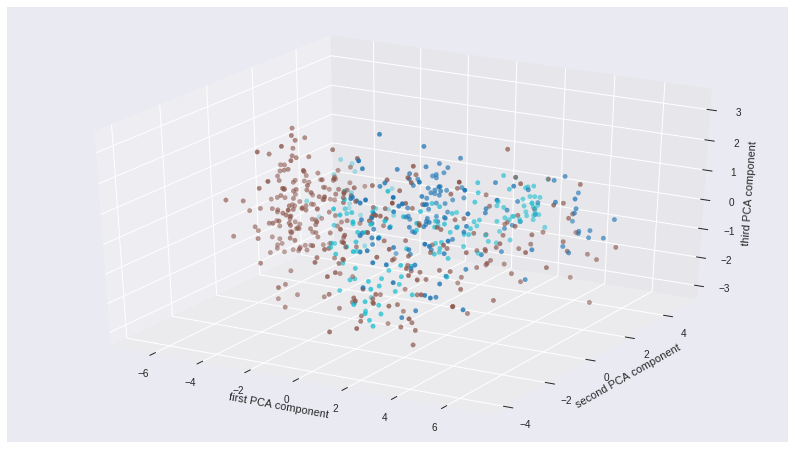

In [155]:
########################################################
##### Visualizing PCA with respect to Target Class #####
########################################################
visualize_pca3D(X_train_transformed, y_train)

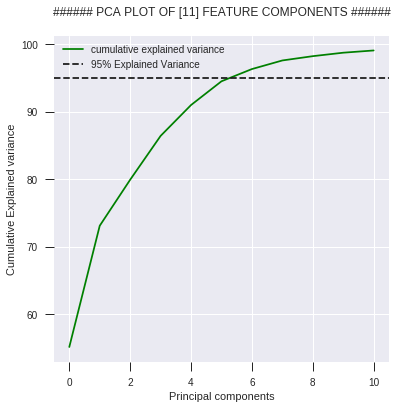

In [156]:
####### PLOT OF PCA ###########
variance_dist, no_of_pca_components = plot_PCA(best_clf_6.best_estimator_[1])

In [157]:
print("####### Coverage of Variance for [%s] components #######"%(no_of_pca_components))
variance_dist

####### Coverage of Variance for [11] components #######


array([55.16058331, 73.12916428, 79.95025493, 86.44683605, 91.02283275,
       94.5420829 , 96.35398295, 97.62906718, 98.26503679, 98.77861499,
       99.11006181])

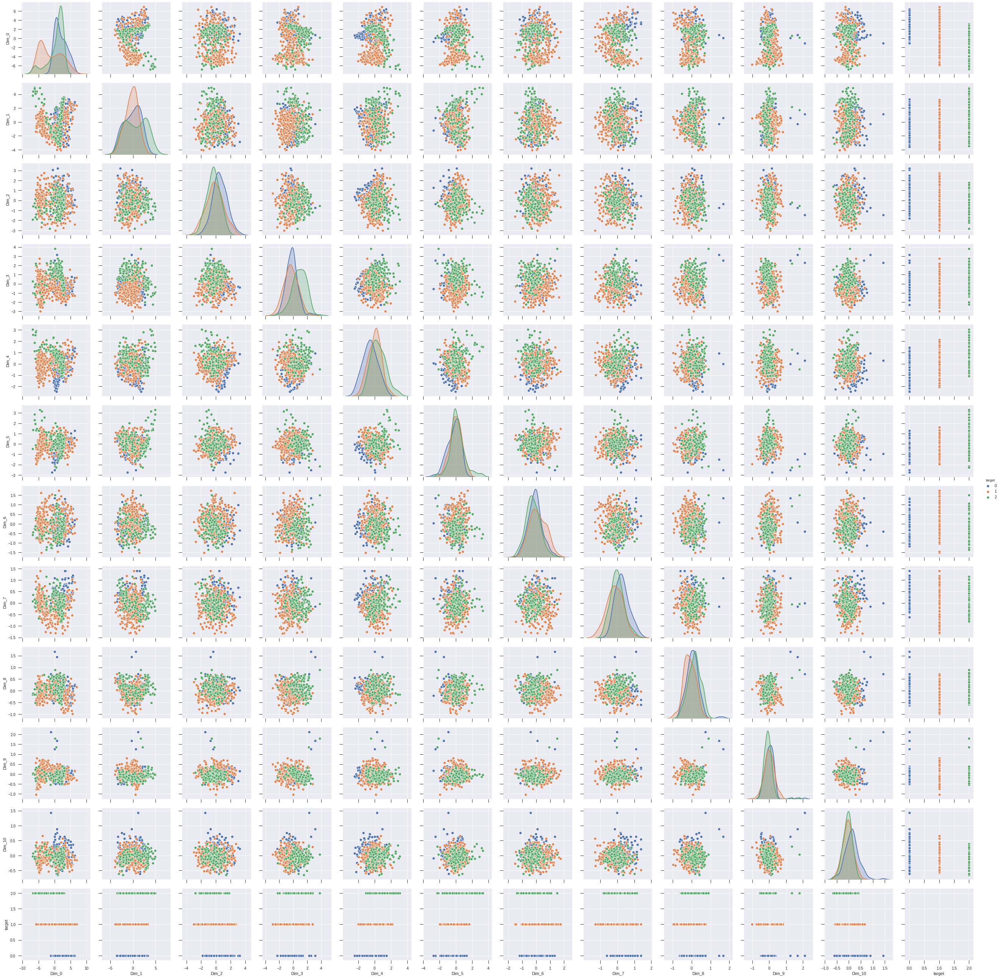

In [161]:
#########################################################################################
#### INSPECTING Whether corrleation has been removed POST PCA DIMENSION REDUCTION #######
#########################################################################################

sns.pairplot(pca_df, height=3,diag_kind='kde', hue='target')

##### It is very evident from above, that strong correlations has been removed post PCA and reduced features were indeed appropriate candidate for model building. All the plots look cloud shaped, meaning WEAK CORRELATION between independent variables as expected from outcome of PCA on our original strongly correlated features.

### Model 7 - Hyper Parameter tuning of FEATURE SELECTION USING ANOVA F-value and mutual_info_classif(Mutual information for a discrete target), parameter tuning of Scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models

In [162]:
###################################################################################
############# FEATURE SELECTION THROUGH ANOVA WITH HYPER PARAMETER TUNING #########
###################################################################################

from sklearn.feature_selection import SelectKBest, f_classif, mutual_info_classif, chi2

n_folds = 5
scaling_options = [StandardScaler(), RobustScaler(), QuantileTransformer()]
no_of_features = [2,4,6,8,9,10,11,12,13,14] 
################################################################################################
## since we have PCA upto 14 features of 99% variance covered, we will try to select among 
## top 14 features out of 18 in total
## through feature selection techniques
################################################################################################
pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('feature_selection', SelectKBest(f_classif)),
    ('model_gs' , LogisticRegression())
])
###############################################################################
### chi2 : Chi-squared stats of non-negative features for classification tasks
### f_classif : ANOVA F-value between label/feature for classification tasks
### mutual_info_classif : Mutual information for a discrete target
###############################################################################

param_grid_models = [
    {'scaler': scaling_options,
     'feature_selection': [SelectKBest(f_classif), SelectKBest(mutual_info_classif)],
     'feature_selection__k': no_of_features,
     'model_gs' : [LogisticRegression(class_weight='balanced')],
     'model_gs__penalty' : ['l2'],
     'model_gs__C' : [0.001, 0.01, 0.1, 
                      1, 10, 40, 50, 200],
    'model_gs__solver' : ['newton-cg', 'sag', 'saga', 'lbfgs'],
     'model_gs__multi_class': ['multinomial'],
     'model_gs__random_state': [42]
    },
    {'scaler': scaling_options,
     'feature_selection': [SelectKBest(f_classif), SelectKBest(mutual_info_classif)],
     'feature_selection__k': no_of_features,
     'model_gs' : [svm.SVC()],
    'model_gs__C': [0.01, 0.05, 0.5, 1],
    'model_gs__gamma': [0.001, 0.01, 0.1, 1],
    'model_gs__kernel': ['linear', 'poly', 'rbf'],
    'model_gs__degree': [1,2,3],
    'model_gs__decision_function_shape': ['ovo'],
    'model_gs__random_state': [42]}
]

#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)

In [163]:
best_clf_7 = grid.fit(X_train, y_train)
best_clf_7.best_estimator_, best_clf_7.best_score_

Fitting 5 folds for each of 10560 candidates, totalling 52800 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 1658 tasks      | elapsed:    6.1s
[Parallel(n_jobs=-1)]: Done 5535 tasks      | elapsed:   25.8s
[Parallel(n_jobs=-1)]: Done 6935 tasks      | elapsed:   44.6s
[Parallel(n_jobs=-1)]: Done 8735 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 11923 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done 17123 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done 23123 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done 29923 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done 34523 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done 38723 tasks      | elapsed:  3.8min
[Parallel(n_jobs=-1)]: Done 43323 tasks      | elapsed:  4.7min
[Parallel(n_jobs=-1)]: Done 48323 tasks      | elapsed:  5.8min
[Parallel(n_jobs=-1)]: Done 52800 out of 52800 | elapsed:  6.7min finished


(Pipeline(memory=None,
          steps=[('scaler',
                  QuantileTransformer(copy=True, ignore_implicit_zeros=False,
                                      n_quantiles=1000,
                                      output_distribution='uniform',
                                      random_state=None, subsample=100000)),
                 ('feature_selection',
                  SelectKBest(k=14,
                              score_func=<function f_classif at 0x7f2154d630d0>)),
                 ('model_gs',
                  SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
                      decision_function_shape='ovo', degree=3, gamma=1,
                      kernel='poly', max_iter=-1, probability=False,
                      random_state=42, shrinking=True, tol=0.001,
                      verbose=False))],
          verbose=False), 0.9476351351351351)

#### Plotting the graph for grid search - Average of Test Scores +/- Standard Deviation :
This would give a rough idea about the test scores across all the iterations. Would give an idea on how best the model is able to fit in test iterations for unseen data

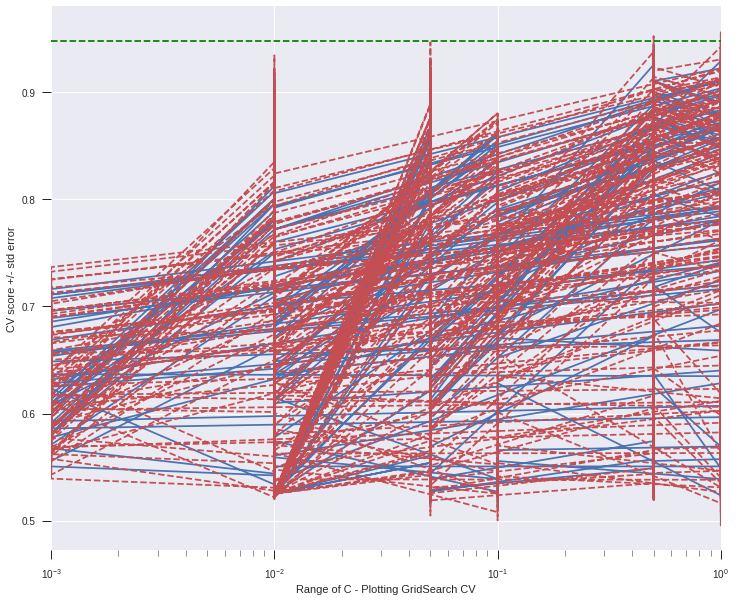

In [164]:
plot_crossval_graph(best_clf_7, 'param_model_gs__C')

### FEATURE SELECTION : ANOVA

14 features were considered, 4 features were ignored

Text(0.5, 0, 'Index of Features')

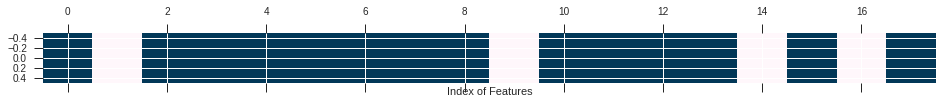

In [165]:
mask = best_clf_7.best_estimator_[1].get_support()
plt.matshow(mask.reshape(1,-1), cmap='PuBu')
plt.xlabel('Index of Features')

#### Evaluation of Model 7 - Confusion Matrix, Classification Reports, F1 score assessment

In [166]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed = print_confusion_classification_gridsearch(best_clf_7.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=True, pca=True)

Inside PCA and Scaler included in grid search <True, True>
Features reduced to : [14]

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 53   3   2]
 [  2 112   4]
 [  2   4  72]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.93      0.91      0.92        58
           1       0.94      0.95      0.95       118
           2       0.92      0.92      0.92        78

    accuracy                           0.93       254
   macro avg       0.93      0.93      0.93       254
weighted avg       0.93      0.93      0.93       254



In [167]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list

[SVC(C=0.01, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovr', degree=3, gamma=0.001, kernel='poly',
     max_iter=-1, probability=False, random_state=None, shrinking=True,
     tol=0.001, verbose=False),
 LogisticRegression(C=0.1, class_weight='balanced', dual=False,
                    fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                    max_iter=100, multi_class='multinomial', n_jobs=None,
                    penalty='l2', random_state=None, solver='newton-cg',
                    tol=0.0001, verbose=0, warm_start=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001,
     verbose=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shri

### Model 8 - Hyper Parameter tuning of FEATURE SELECTION USING RANDOM FOREST, DECISION TREE AND EXTRA TREE CLASSIFIERS, parameter tuning of Scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models

In [168]:
############################################################################################
############# FEATURE SELECTION THROUGH TREE BASED SELECTION WITH PARAMETER TUNING #########
############################################################################################

from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import ExtraTreesClassifier

n_folds = 5
scaling_options = [StandardScaler(), RobustScaler(), QuantileTransformer()]


feature_from_models = [SelectFromModel(RandomForestClassifier(n_estimators = 128, n_jobs=-1, criterion = 'entropy')),
                       SelectFromModel(ExtraTreesClassifier(n_estimators=250,random_state=0)),
                       SelectFromModel(DecisionTreeClassifier(criterion = 'entropy'))]

################################################################################################
########### COMBINING RANDOM FOREST, DECISION TREE, EXTRA TREE CLASSIFIER ######################
## TO SELECT FEATURES BY HYPER PARAMETER TUNING AND CHOOSE THE BEST FEATURE SELECTION ##########
################################################################################################
pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('feature_selection', SelectKBest(chi2)),
    ('model_gs' , LogisticRegression())
])

param_grid_models = [
    {'scaler': scaling_options,
     'feature_selection': feature_from_models,
     'model_gs' : [LogisticRegression(class_weight='balanced')],
     'model_gs__penalty' : ['l2'],
     'model_gs__C' : [0.001, 0.01, 0.1, 
                      1, 10, 40, 50, 200],
    'model_gs__solver' : ['newton-cg', 'sag', 'saga', 'lbfgs'],
     'model_gs__multi_class': ['multinomial'],
     'model_gs__random_state': [42]
    },
    {'scaler': scaling_options,
     'feature_selection': feature_from_models,
     'model_gs' : [svm.SVC()],
    'model_gs__C': [0.01, 0.05, 0.5, 1],
    'model_gs__gamma': [0.001, 0.01, 0.1, 1],
    'model_gs__kernel': ['linear', 'poly', 'rbf'],
    'model_gs__degree': [1,2,3],
    'model_gs__decision_function_shape': ['ovo'],
    'model_gs__random_state': [42]}
]

#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)

In [169]:
best_clf_8 = grid.fit(X_train, y_train)
best_clf_8.best_estimator_, best_clf_8.best_score_

Fitting 5 folds for each of 1584 candidates, totalling 7920 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 176 tasks      | elapsed:    8.3s
[Parallel(n_jobs=-1)]: Done 426 tasks      | elapsed:   20.2s
[Parallel(n_jobs=-1)]: Done 776 tasks      | elapsed:   32.6s
[Parallel(n_jobs=-1)]: Done 1763 tasks      | elapsed:   55.1s
[Parallel(n_jobs=-1)]: Done 2313 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 2963 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done 3713 tasks      | elapsed:  2.3min
[Parallel(n_jobs=-1)]: Done 4563 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done 5513 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done 7920 out of 7920 | elapsed:  3.6min finished


(Pipeline(memory=None,
          steps=[('scaler',
                  RobustScaler(copy=True, quantile_range=(25.0, 75.0),
                               with_centering=True, with_scaling=True)),
                 ('feature_selection',
                  SelectFromModel(estimator=ExtraTreesClassifier(bootstrap=False,
                                                                 class_weight=None,
                                                                 criterion='gini',
                                                                 max_depth=None,
                                                                 max_features='auto',
                                                                 max_leaf_nodes=None,
                                                                 min_impurity_decrease=0.0,
                                                                 min_impurity_split=Non...
                                                                 n_jobs=None,
   

#### Plotting the graph for grid search - Average of Test Scores +/- Standard Deviation :
This would give a rough idea about the test scores across all the iterations. Would give an idea on how best the model is able to fit in test iterations for unseen data

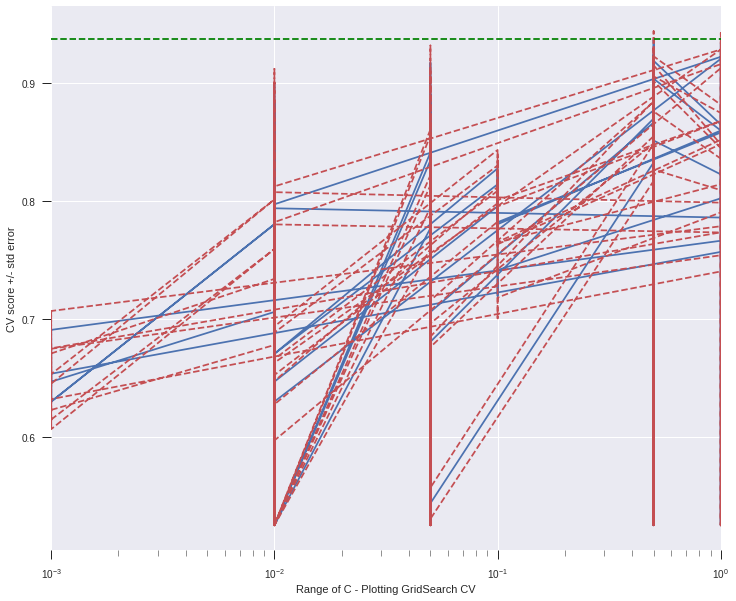

In [170]:
plot_crossval_graph(best_clf_8, 'param_model_gs__C')

### FEATURE SELECTION : ExtraTreesClassifier

9 features were considered, 9 features were ignored

Text(0.5, 0, 'Index of Features')

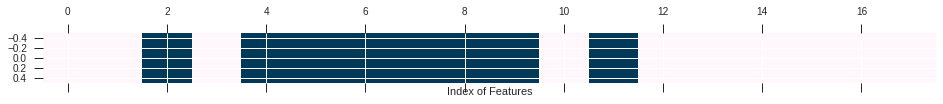

In [171]:
mask = best_clf_8.best_estimator_[1].get_support()
plt.matshow(mask.reshape(1,-1), cmap='PuBu')
plt.xlabel('Index of Features')

#### Evaluation of Model 8 - Confusion Matrix, Classification Reports, F1 score assessment

In [172]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed = print_confusion_classification_gridsearch(best_clf_8.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=True, pca=True)

Inside PCA and Scaler included in grid search <True, True>
Features reduced to : [8]

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 51   6   1]
 [  1 115   2]
 [  1   3  74]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.96      0.88      0.92        58
           1       0.93      0.97      0.95       118
           2       0.96      0.95      0.95        78

    accuracy                           0.94       254
   macro avg       0.95      0.93      0.94       254
weighted avg       0.95      0.94      0.94       254



In [173]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list

[SVC(C=0.01, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovr', degree=3, gamma=0.001, kernel='poly',
     max_iter=-1, probability=False, random_state=None, shrinking=True,
     tol=0.001, verbose=False),
 LogisticRegression(C=0.1, class_weight='balanced', dual=False,
                    fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                    max_iter=100, multi_class='multinomial', n_jobs=None,
                    penalty='l2', random_state=None, solver='newton-cg',
                    tol=0.0001, verbose=0, warm_start=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001,
     verbose=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shri

### Model 9 - Hyper Parameter tuning of FEATURE SELECTION USING LINEAR SVC, LIGHTGBM, LOGISTIC REGRESSION CLASSIFIERS, parameter tuning of Scaler methods - Standard, Robust, Quantile with Logistic Regression and SVC models

In [174]:
################################################################################################
############# FEATURE SELECTION THROUGH OTHER MODEL BASED SELECTION WITH PARAMETER TUNING ######
################################################################################################

from sklearn.feature_selection import SelectFromModel
from lightgbm import LGBMClassifier
from sklearn.svm import LinearSVC

n_folds = 5
scaling_options = [StandardScaler(), RobustScaler(), QuantileTransformer()]


feature_from_models = [SelectFromModel(LinearSVC(penalty="l1", dual=False,tol=1e-3)),
                       SelectFromModel(LogisticRegression(C=0.1, class_weight='balanced', dual=False,
                                                          fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                                                          max_iter=100, multi_class='multinomial', n_jobs=None,
                                                          penalty='l2', random_state=None, solver='newton-cg',
                                                          tol=0.0001, verbose=0, warm_start=False)),
                      SelectFromModel(LGBMClassifier(n_estimators=128, learning_rate=0.01, num_leaves=64, 
                                                     colsample_bytree=0.2,
                                                     reg_alpha=3, reg_lambda=1, min_split_gain=0.01, 
                                                     min_child_weight=40))]

################################################################################################
########### COMBINING LOGISTICREGRESSION, LINEAR SVC, Light GBM ################################
## TO SELECT FEATURES BY HYPER PARAMETER TUNING AND CHOOSE THE BEST FEATURE SELECTION ##########
################################################################################################
pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('feature_selection', SelectKBest(chi2)),
    ('model_gs' , LogisticRegression())
])

param_grid_models = [
    {'scaler': scaling_options,
     'feature_selection': feature_from_models,
     'model_gs' : [LogisticRegression(class_weight='balanced')],
     'model_gs__penalty' : ['l2'],
     'model_gs__C' : [0.001, 0.01, 0.1, 
                      1, 10, 40, 50, 200],
    'model_gs__solver' : ['newton-cg', 'sag', 'saga', 'lbfgs'],
     'model_gs__multi_class': ['multinomial'],
     'model_gs__random_state': [42]
    },
    {'scaler': scaling_options,
     'feature_selection': feature_from_models,
     'model_gs' : [svm.SVC()],
    'model_gs__C': [0.01, 0.05, 0.5, 1],
    'model_gs__gamma': [0.001, 0.01, 0.1, 1],
    'model_gs__kernel': ['linear', 'poly', 'rbf'],
    'model_gs__degree': [1,2,3],
    'model_gs__decision_function_shape': ['ovo'],
    'model_gs__random_state': [42]}
]

#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)

In [175]:
best_clf_9 = grid.fit(X_train, y_train)
best_clf_9.best_estimator_, best_clf_9.best_score_

Fitting 5 folds for each of 1584 candidates, totalling 7920 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  28 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 328 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done 828 tasks      | elapsed:    8.0s
[Parallel(n_jobs=-1)]: Done 1528 tasks      | elapsed:   13.6s
[Parallel(n_jobs=-1)]: Done 2428 tasks      | elapsed:   23.5s
[Parallel(n_jobs=-1)]: Done 3528 tasks      | elapsed:   35.6s
[Parallel(n_jobs=-1)]: Done 4828 tasks      | elapsed:   41.8s
[Parallel(n_jobs=-1)]: Done 7770 tasks      | elapsed:   58.0s
[Parallel(n_jobs=-1)]: Done 7920 out of 7920 | elapsed:   59.0s finished


(Pipeline(memory=None,
          steps=[('scaler',
                  StandardScaler(copy=True, with_mean=True, with_std=True)),
                 ('feature_selection',
                  SelectFromModel(estimator=LinearSVC(C=1.0, class_weight=None,
                                                      dual=False,
                                                      fit_intercept=True,
                                                      intercept_scaling=1,
                                                      loss='squared_hinge',
                                                      max_iter=1000,
                                                      multi_class='ovr',
                                                      penalty='l1',
                                                      random_state=None,
                                                      tol=0.001, verbose=0),
                                  max_features=None, norm_order=1, prefit=False,
                     

#### Plotting the graph for grid search - Average of Test Scores +/- Standard Deviation :
This would give a rough idea about the test scores across all the iterations. Would give an idea on how best the model is able to fit in test iterations for unseen data

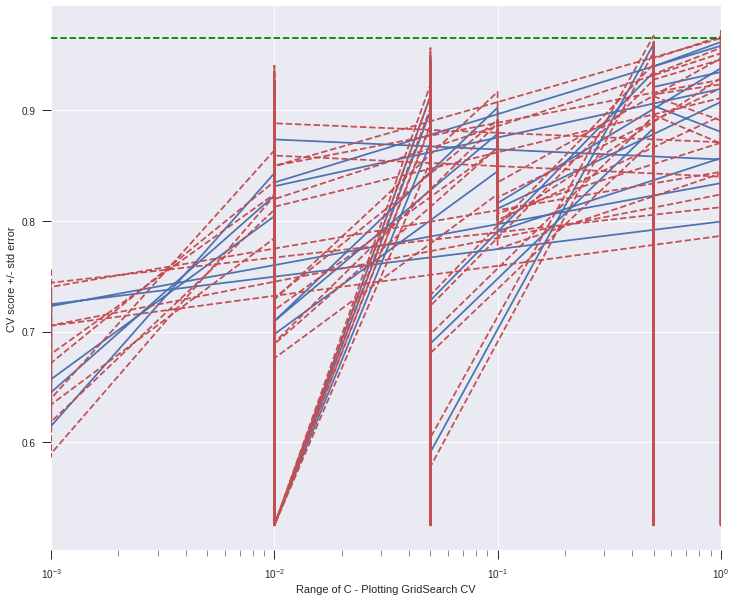

In [176]:
plot_crossval_graph(best_clf_9, 'param_model_gs__C')

### FEATURE SELECTION : LinearSVC

18 features were considered, 0 features were ignored

Text(0.5, 0, 'Index of Features')

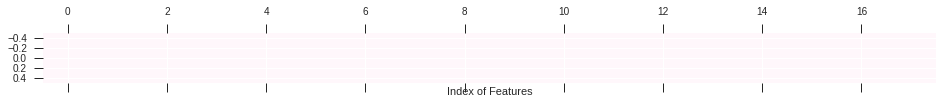

In [177]:
mask = best_clf_9.best_estimator_[1].get_support()
plt.matshow(mask.reshape(1,-1), cmap='PuBu')
plt.xlabel('Index of Features')

#### Evaluation of Model 9 - Confusion Matrix, Classification Reports, F1 score assessment

In [178]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed = print_confusion_classification_gridsearch(best_clf_9.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=True, pca=True)

Inside PCA and Scaler included in grid search <True, True>
Features reduced to : [18]

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 54   4   0]
 [  1 116   1]
 [  2   1  75]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.95      0.93      0.94        58
           1       0.96      0.98      0.97       118
           2       0.99      0.96      0.97        78

    accuracy                           0.96       254
   macro avg       0.96      0.96      0.96       254
weighted avg       0.96      0.96      0.96       254



In [179]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list

[SVC(C=0.01, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovr', degree=3, gamma=0.001, kernel='poly',
     max_iter=-1, probability=False, random_state=None, shrinking=True,
     tol=0.001, verbose=False),
 LogisticRegression(C=0.1, class_weight='balanced', dual=False,
                    fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                    max_iter=100, multi_class='multinomial', n_jobs=None,
                    penalty='l2', random_state=None, solver='newton-cg',
                    tol=0.0001, verbose=0, warm_start=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001,
     verbose=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shri

### Model 10 - Hyper Parameter tuning of RANDOM FOREST MODEL, PCA tuning and parameter tuning of Scaler methods - Standard, Robust, Quantile scalers

In [180]:
####################################################################
##### Random FOREST hyper parameter tuning WITH APPLICATION OF PCA
####################################################################

n_folds = 5
scaling_options = [StandardScaler(), RobustScaler(), QuantileTransformer()]
no_of_PCA_features = np.arange(1, 14)

pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('pca_reduction', PCA() ),
    ('model_gs' , RandomForestClassifier(class_weight='balanced'))
])

param_grid_models = [
    {'scaler': scaling_options,
     'pca_reduction': [PCA()],
     'pca_reduction__n_components': no_of_PCA_features,
     'pca_reduction__svd_solver': ['full', 'arpack', 'randomized'],
     'model_gs' : [RandomForestClassifier(class_weight='balanced')],
     'model_gs__max_depth': [24, 32, 40],     
     'model_gs__min_samples_leaf': [1, 2],
     'model_gs__n_estimators': [16, 32,64,80,128, 256], 
     'model_gs__n_jobs':[-1], 
     'model_gs__random_state':[42]
    }
]

#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)

In [181]:
best_clf_10 = grid.fit(X_train, y_train)
best_clf_10.best_estimator_, best_clf_10.best_score_

Fitting 5 folds for each of 4212 candidates, totalling 21060 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 176 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done 426 tasks      | elapsed:   10.0s
[Parallel(n_jobs=-1)]: Done 776 tasks      | elapsed:   17.8s
[Parallel(n_jobs=-1)]: Done 1226 tasks      | elapsed:   28.7s
[Parallel(n_jobs=-1)]: Done 1776 tasks      | elapsed:   41.5s
[Parallel(n_jobs=-1)]: Done 2426 tasks      | elapsed:   58.8s
[Parallel(n_jobs=-1)]: Done 3176 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done 4026 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done 4976 tasks      | elapsed:  2.5min
[Parallel(n_jobs=-1)]: Done 6026 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done 7176 tasks      | elapsed:  3.8min
[Parallel(n_jobs=-1)]: Done 8426 tasks      | elapsed:  4.3min
[Parallel(n_jobs=-1)]: Done 9776 tasks      | elapsed:  5.0min
[Parallel(n_jobs=-1)]: Done 11226 tasks      

(Pipeline(memory=None,
          steps=[('scaler',
                  StandardScaler(copy=True, with_mean=True, with_std=True)),
                 ('pca_reduction',
                  PCA(copy=True, iterated_power='auto', n_components=13,
                      random_state=None, svd_solver='full', tol=0.0,
                      whiten=False)),
                 ('model_gs',
                  RandomForestClassifier(bootstrap=True, class_weight='balanced',
                                         criterion='gini', max_depth=24,
                                         max_features='auto',
                                         max_leaf_nodes=None,
                                         min_impurity_decrease=0.0,
                                         min_impurity_split=None,
                                         min_samples_leaf=1, min_samples_split=2,
                                         min_weight_fraction_leaf=0.0,
                                         n_estimators=64, n_j

#### Plotting the graph for grid search - Average of Test Scores +/- Standard Deviation :
This would give a rough idea about the test scores across all the iterations. Would give an idea on how best the model is able to fit in test iterations for unseen data

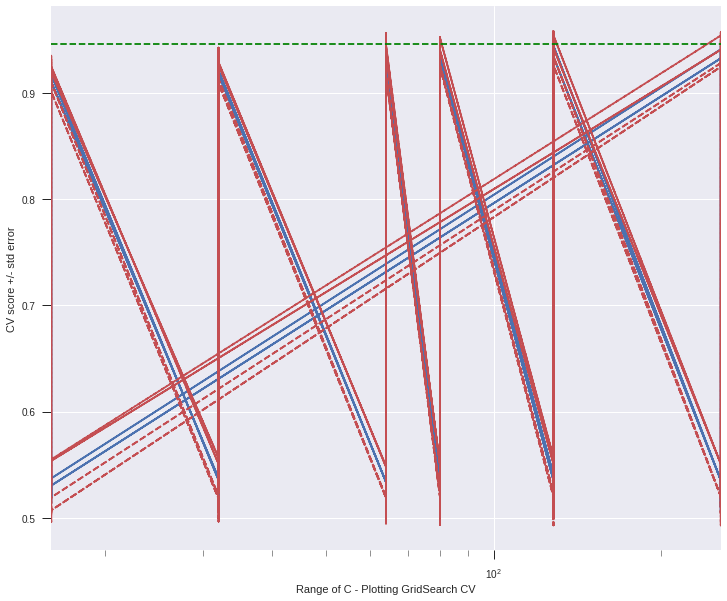

In [182]:
plot_crossval_graph(best_clf_10, 'param_model_gs__n_estimators')

#### Evaluation of Model 10 - Confusion Matrix, Classification Reports, F1 score assessment

In [183]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(best_clf_10.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=True, pca=True)

Inside PCA and Scaler included in grid search <True, True>
Features reduced to : [13]

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 50   8   0]
 [  1 116   1]
 [  1   5  72]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.96      0.86      0.91        58
           1       0.90      0.98      0.94       118
           2       0.99      0.92      0.95        78

    accuracy                           0.94       254
   macro avg       0.95      0.92      0.93       254
weighted avg       0.94      0.94      0.94       254



In [184]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list

[SVC(C=0.01, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovr', degree=3, gamma=0.001, kernel='poly',
     max_iter=-1, probability=False, random_state=None, shrinking=True,
     tol=0.001, verbose=False),
 LogisticRegression(C=0.1, class_weight='balanced', dual=False,
                    fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                    max_iter=100, multi_class='multinomial', n_jobs=None,
                    penalty='l2', random_state=None, solver='newton-cg',
                    tol=0.0001, verbose=0, warm_start=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001,
     verbose=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shri

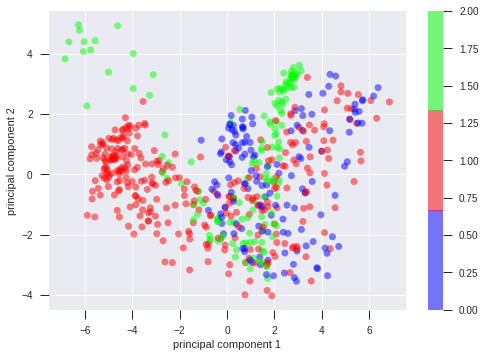

In [185]:
##### Visualizing PCA with respect to Target Class #####
########################################################
pca_df = visualize_pca(X_train_transformed, y_train)

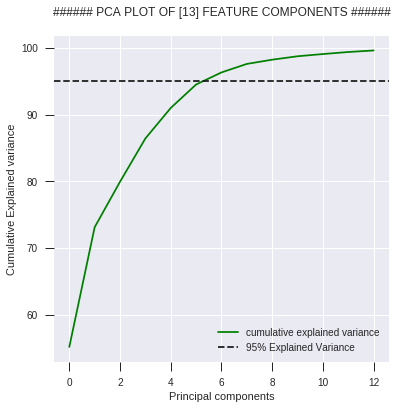

In [186]:
####### PLOT OF PCA ###########
variance_dist, no_of_pca_components = plot_PCA(best_clf_10.best_estimator_[1])

In [187]:
print("####### Coverage of Variance for [%s] components #######"%(no_of_pca_components))
variance_dist

####### Coverage of Variance for [13] components #######


array([55.16058331, 73.12916428, 79.95025493, 86.44683605, 91.02283275,
       94.5420829 , 96.35398295, 97.62906718, 98.26503679, 98.77861499,
       99.11006181, 99.41560869, 99.64748218])

### Model 11 - Hyper Parameter tuning of XGBOOST MODEL, PCA tuning and parameter tuning of Scaler methods - Standard, Robust, Quantile scalers

In [188]:
####################################################################
##### XGB hyper parameter tuning WITH APPLICATION OF PCA
####################################################################
from xgboost.sklearn import XGBClassifier

n_folds = 5
scaling_options = [StandardScaler(), RobustScaler(), QuantileTransformer()]
no_of_PCA_features = np.arange(1, 14)

pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('pca_reduction', PCA() ),
    ('model_gs' , XGBClassifier())
])

param_grid_models = [
    { 'scaler': scaling_options,
     'pca_reduction': [PCA()],
     'pca_reduction__n_components': no_of_PCA_features,
     'pca_reduction__svd_solver': ['full', 'arpack', 'randomized'],
     'model_gs' : [XGBClassifier(learning_rate =0.1, n_jobs=-1)],
     'model_gs__reg_alpha': [0, 0.001, 0.01, 0.05], 
     'model_gs__min_child_weight':[6,10,12],
     'model_gs__max_depth':[3,5,6],
     'model_gs__n_estimators':[32,64,96,128]
    }
]

#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)

In [189]:
best_clf_11 = grid.fit(X_train, y_train)
best_clf_11.best_estimator_, best_clf_11.best_score_

Fitting 5 folds for each of 16848 candidates, totalling 84240 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-1)]: Done 213 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 713 tasks      | elapsed:   11.2s
[Parallel(n_jobs=-1)]: Done 1413 tasks      | elapsed:   18.0s
[Parallel(n_jobs=-1)]: Done 2313 tasks      | elapsed:   26.9s
[Parallel(n_jobs=-1)]: Done 3413 tasks      | elapsed:   47.6s
[Parallel(n_jobs=-1)]: Done 4713 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 6213 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done 7779 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done 8729 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done 9779 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done 10929 tasks      | elapsed:  4.1min
[Parallel(n_jobs=-1)]: Done 12179 tasks      | elapsed:  4.4min
[Parallel(n_jobs=-1)]: Done 13529 tasks      | elapsed:  4.9min
[Parallel(n_jobs=-1)]: Done 14979 tasks  

(Pipeline(memory=None,
          steps=[('scaler',
                  RobustScaler(copy=True, quantile_range=(25.0, 75.0),
                               with_centering=True, with_scaling=True)),
                 ('pca_reduction',
                  PCA(copy=True, iterated_power='auto', n_components=13,
                      random_state=None, svd_solver='full', tol=0.0,
                      whiten=False)),
                 ('model_gs',
                  XGBClassifier(base_score=0.5, booster='gbtree',
                                colsample_bylevel=1, colsample_bytree=1, gamma=0,
                                learning_rate=0.1, max_delta_step=0, max_depth=3,
                                min_child_weight=6, missing=None,
                                n_estimators=128, n_jobs=-1, nthread=None,
                                objective='multi:softprob', random_state=0,
                                reg_alpha=0.01, reg_lambda=1, scale_pos_weight=1,
                               

#### Plotting the graph for grid search - Average of Test Scores +/- Standard Deviation :
This would give a rough idea about the test scores across all the iterations. Would give an idea on how best the model is able to fit in test iterations for unseen data

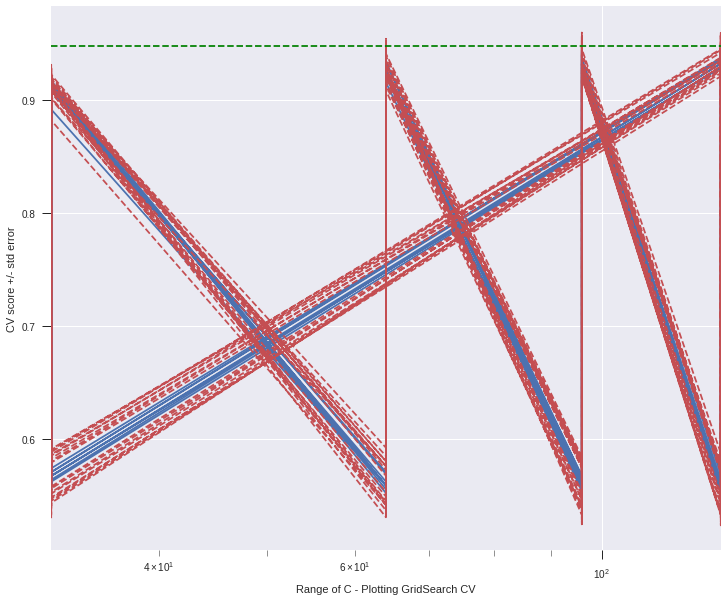

In [190]:
plot_crossval_graph(best_clf_11, 'param_model_gs__n_estimators')

#### Evaluation of Model 11 - Confusion Matrix, Classification Reports, F1 score assessment

In [191]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(best_clf_11.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=True, pca=True)

Inside PCA and Scaler included in grid search <True, True>
Features reduced to : [13]

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 51   6   1]
 [  1 115   2]
 [  2   5  71]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.94      0.88      0.91        58
           1       0.91      0.97      0.94       118
           2       0.96      0.91      0.93        78

    accuracy                           0.93       254
   macro avg       0.94      0.92      0.93       254
weighted avg       0.93      0.93      0.93       254



In [192]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list

[SVC(C=0.01, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovr', degree=3, gamma=0.001, kernel='poly',
     max_iter=-1, probability=False, random_state=None, shrinking=True,
     tol=0.001, verbose=False),
 LogisticRegression(C=0.1, class_weight='balanced', dual=False,
                    fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                    max_iter=100, multi_class='multinomial', n_jobs=None,
                    penalty='l2', random_state=None, solver='newton-cg',
                    tol=0.0001, verbose=0, warm_start=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001,
     verbose=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shri

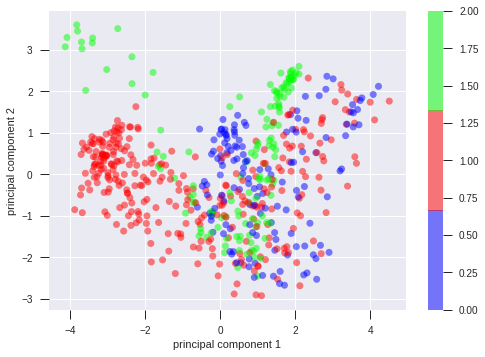

In [193]:
##### Visualizing PCA with respect to Target Class #####
########################################################
pca_df = visualize_pca(X_train_transformed, y_train)

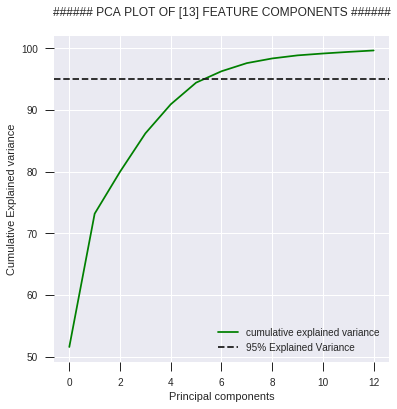

In [194]:
####### PLOT OF PCA ###########
variance_dist, no_of_pca_components = plot_PCA(best_clf_11.best_estimator_[1])

In [195]:
print("####### Coverage of Variance for [%s] components #######"%(no_of_pca_components))
variance_dist

####### Coverage of Variance for [13] components #######


array([51.56594114, 73.18677732, 79.99038458, 86.21795459, 90.93238774,
       94.44882081, 96.29403981, 97.61493863, 98.37227567, 98.87194562,
       99.17384002, 99.43343305, 99.66703691])

#### SUMMARY OF BEST CLASSIFIER FOR ALL 3 CLASSES ####
1. Total Hyper Parameter Tuned Grid Search Best Estimators - 11
2. Total Models Fitted - 324860


###### Based on F1 Score of ALL 3 Classes : BEST PIPELINE WITH PCA, Scaler and SVC Model

1. Scaler : Standard Scaler
2. PCA : 11 components, 99% variance explained
3. F1 Score of Test Data : Class 1 - 95%, Class 2 - 96%, Class 3 - 96%

###### Refer best_clf_6.best_estimator_ FROM ABOVE PARAMETER TUNING :
(Pipeline(memory=None,
          steps=[('scaler',
                  StandardScaler(copy=True, with_mean=True, with_std=True)),
                 ('pca_reduction',
                  PCA(copy=True, iterated_power='auto', n_components=11,
                      random_state=None, svd_solver='full', tol=0.0,
                      whiten=False)),
                 ('model_gs',
                  SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
                      decision_function_shape='ovo', degree=1, gamma=0.1,
                      kernel='rbf', max_iter=-1, probability=False,
                      random_state=42, shrinking=True, tol=0.001,
                      verbose=False))],
          verbose=False), accuracy: 0.9543918918918919)

###### Classification Report for UNSEEN TEST DATA for best_clf_6.best_estimator_: ######

              precision    recall  f1-score   support

           0       0.95      0.95      0.95        58
           1       0.95      0.97      0.96       118
           2       0.97      0.95      0.96        78



### Using ELBOW METHOD - Scale using MINMAX Scaler, Find Optimal clusters for KMeans, Fit Kmeans & Evaluate the confusion matrix and classification F1 Scores against the clusters predicted

In [196]:
#### Copying to separate dataframe to perform clustering, omiting the target variable ####
from sklearn.preprocessing import MinMaxScaler

### Let us scale it before clustering to treat numerical features in equal scale ######
scaled_minmax = MinMaxScaler().fit_transform(imputed_df.drop('target',axis=1))
cluster_df = pd.DataFrame(scaled_minmax, index=imputed_df.index, columns=imputed_df.columns[:-1])
cluster_df.head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio
0,0.500000,0.576923,0.597222,0.500000,0.862069,0.727273,0.326797,0.457143,0.272727,0.585714,0.306667,0.249361,0.471698,0.343750,0.30,0.410256,0.366667,0.533333
1,0.409091,0.307692,0.611111,0.250000,0.344828,0.636364,0.241830,0.542857,0.181818,0.357143,0.266667,0.186701,0.308176,0.406250,0.45,0.358974,0.433333,0.600000
2,0.704545,0.653846,0.916667,0.709459,0.655172,0.727273,0.620915,0.171429,0.545455,0.571429,0.620000,0.576726,0.698113,0.437500,0.70,0.230769,0.400000,0.500000
3,0.454545,0.307692,0.583333,0.371622,0.551724,0.636364,0.209150,0.571429,0.181818,0.357143,0.200000,0.159847,0.113208,0.125000,0.30,0.256410,0.766667,0.866667
4,0.272727,0.423077,0.416667,0.682432,0.885057,0.595960,0.241830,0.542857,0.181818,0.371429,0.740000,0.180307,0.496855,0.833333,0.45,0.282051,0.133333,0.066667


In [197]:
#### Checking the shape of cluster dataframe ####
cluster_df.shape

(846, 18)

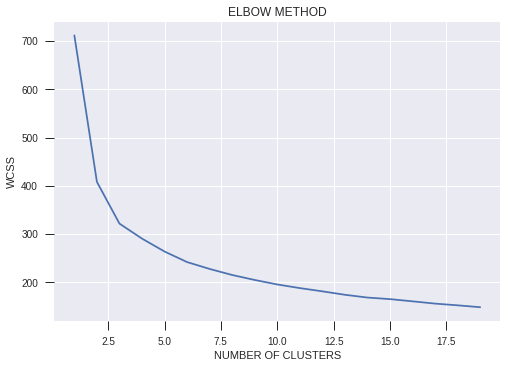

In [198]:
from sklearn.cluster import KMeans

wcss = []
for i in range(1, 20):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42, max_iter=300,n_init=10) 
    kmeans.fit(cluster_df)
    wcss.append(kmeans.inertia_) ## kmeans.inertia_ = helps to compute WCSS

    
plt.plot(range(1, 20), wcss)
plt.title('ELBOW METHOD')
plt.xlabel('NUMBER OF CLUSTERS')
plt.ylabel('WCSS')
plt.show()

In [199]:
############################################################################################
#### From above, there is no steep drop after cluster 3,4.  ################################
######## For our problem, we have 3 classes - hence we will stick with clusters = 3 ########
############################################################################################


cluster_k3 = KMeans(n_clusters=3, init='k-means++')
y_pred_k3 = cluster_k3.fit_predict(cluster_df)

In [200]:
##### Like our original data - we have now clustered this scaled data to 3 clusters like unsupervised ####
##########################################################################################################

np.unique(y_pred_k3), y_pred_k3.shape, y.shape

(array([0, 1, 2], dtype=int32), (846,), (846, 1))

In [201]:
###### Let us calculate the confusion matrix with predicted cluster Vs the actual class in data #####
#####################################################################################################

print(confusion_matrix(imputed_df['target'],y_pred_k3))
print(classification_report(imputed_df['target'],y_pred_k3))

[[  0  81 118]
 [214  76 139]
 [ 49  85  84]]
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       199
           1       0.31      0.18      0.23       429
           2       0.25      0.39      0.30       218

    accuracy                           0.19       846
   macro avg       0.19      0.19      0.18       846
weighted avg       0.22      0.19      0.19       846



In [202]:
##### Evaluation of K=3 is very low for Kmeans in F1 Score for class 0, 1, 2 (van, bus and car)######
######### Let us try one more attempt at Kmeans for PCA transformed features & see for difference ###
#####################################################################################################

#### Step 1 - Take the original imputed dataframe that is free from outliers and null values ######
#### Step 2 - Apply the Standard Scaler, as we have seen it performing well during tuning #########
#### Step 3 - Apply PCA to reduce to 11 dimensions, which has got better results in tuning ########
#### Step 4 - Copy to separate dataframe and repeat Kmeans step which we did above ################
###################################################################################################

scaled_pca = PCA(n_components=11).fit_transform(StandardScaler().fit_transform(imputed_df.drop('target',axis=1)))
cluster_df_pca = pd.DataFrame(scaled_pca, index=imputed_df.index)
cluster_df_pca.head()

,0,1,2,3,4,5,6,7,8,9,10
0,0.566956,-0.651382,0.236837,0.890885,-0.798927,1.750218,-0.256219,0.644173,-0.406360,-0.336338,-0.044689
1,-1.514829,-0.394390,0.566625,-1.151888,-0.333199,0.198702,0.206871,-0.129617,0.185117,0.267444,0.228762
2,3.894724,0.210067,1.229907,0.191934,0.872892,0.681880,0.784237,-0.185020,-0.297673,0.431376,0.021722
3,-1.543682,-3.031531,0.493781,-0.211096,-0.623432,-0.351465,0.119087,0.172039,0.301623,-0.361920,0.368894
4,-0.496197,2.062623,-0.222955,2.183080,0.817183,2.508063,0.946291,-0.064379,0.378162,1.206316,0.420429


### Using ELBOW METHOD - Scale using best PCA/Scaler obtained from best fits, Find Optimal clusters for KMeans, Fit Kmeans & Evaluate the confusion matrix and classification F1 Scores against the clusters predicted

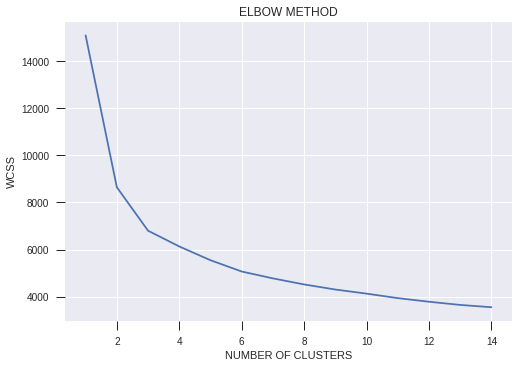

In [203]:
from sklearn.cluster import KMeans

wcss = []
for i in range(1, 15):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42, max_iter=300,n_init=10) 
    kmeans.fit(cluster_df_pca)
    wcss.append(kmeans.inertia_) ## kmeans.inertia_ = helps to compute WCSS

    
plt.plot(range(1, 15), wcss)
plt.title('ELBOW METHOD')
plt.xlabel('NUMBER OF CLUSTERS')
plt.ylabel('WCSS')
plt.show()

In [204]:
#### Let us try with 3 clusters like above #####

cluster_pca3 = KMeans(n_clusters=3, init='k-means++')
y_pred_pca3 = cluster_pca3.fit_predict(cluster_df_pca)

In [205]:
##### Like our original data - we have now clustered this scaled data to 3 clusters like unsupervised ####
##########################################################################################################

np.unique(y_pred_pca3), y_pred_pca3.shape, y.shape

(array([0, 1, 2], dtype=int32), (846,), (846, 1))

In [206]:
###### Let us calculate the confusion matrix with predicted cluster Vs the actual class in data #####
########################### PCA APPLIED DATA ########################################################
#####################################################################################################

print(confusion_matrix(imputed_df['target'],y_pred_pca3))
print(classification_report(imputed_df['target'],y_pred_pca3))

[[119   0  80]
 [140 214  75]
 [ 85  48  85]]
              precision    recall  f1-score   support

           0       0.35      0.60      0.44       199
           1       0.82      0.50      0.62       429
           2       0.35      0.39      0.37       218

    accuracy                           0.49       846
   macro avg       0.51      0.50      0.48       846
weighted avg       0.59      0.49      0.51       846



###### Comparing above confusion matrix with below Kmeans that we got without PCA,
 [  0 118  81]
 [214 140  75]
 [ 49  84  85]
 
Results are NOT satisfactory with clusters. F1 scores for class 0, 1, 2(Van, Car, Bus) is very week and this clearly needs more number of clusters beyond 3 to get accurately classify the data. With increase in cluster number, it is possible to capture more unique category specific to car types or van types or bus types.

In [207]:
#### Removing Duplicate from the list of models obtained in hyper parameter tuning #####
hyper_parameter_tuned_models = list(set(tuned_models_list))
len(tuned_models_list), len(hyper_parameter_tuned_models)

(11, 11)

In [208]:
#### 11 Unique Models - This will form inputs to Stacking ######
hyper_parameter_tuned_models

[RandomForestClassifier(bootstrap=True, class_weight='balanced',
                        criterion='gini', max_depth=24, max_features='auto',
                        max_leaf_nodes=None, min_impurity_decrease=0.0,
                        min_impurity_split=None, min_samples_leaf=1,
                        min_samples_split=2, min_weight_fraction_leaf=0.0,
                        n_estimators=64, n_jobs=-1, oob_score=False,
                        random_state=42, verbose=0, warm_start=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001,
     verbose=False),
 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
     decision_function_shape='ovo', degree=1, gamma=0.1, kernel='rbf',
     max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001,
     verbose=False),
 SVC(C=1, cache_size=200, class_weight=None,

In [209]:
##### SINCE WE CONCLUDED ABOVE that best_clf_6 is BEST CLASSIFIER FROM HYPERPARAMETER TUNING ########
################# We will take X train and X test from best_clf_6 classifer #########################

tuned_models_list, \
X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(best_clf_6.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=True, pca=True)

Inside PCA and Scaler included in grid search <True, True>
Features reduced to : [11]

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 55   3   0]
 [  2 114   2]
 [  1   3  74]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.95      0.95      0.95        58
           1       0.95      0.97      0.96       118
           2       0.97      0.95      0.96        78

    accuracy                           0.96       254
   macro avg       0.96      0.95      0.96       254
weighted avg       0.96      0.96      0.96       254



## STACKING - With 11 best fit hyper parameter tuned models, consolidating the learners together and perform stacking
For this use case, only Level 0 and Level 1 stacking has been accomplished though we could perform multiple levels of stacking

In [210]:
### STACKING STEPS ##############################################################################################
## Step 1 - We have 11 transformed/reduced features in X train and X test belonging to best estimator ###########
## Step 2 - We have 11 UNIQUE FINE TUNED models #################################################################
## Step 3 - For each of the model, we will train with X_train and validate with X_test and predict Y ############
## Step 4 - Combined prediction of all 12 will be STACKED TOGETHER for second level prediction ##################
## Step 5 - We will use one more SECOND level model to learn first level prediction and make final prediction ###
## TO BE NOTED - We can use multiple levels stacking, for simplicity we are sticking with 2 levels for now! #####
#################################################################################################################
X_train_transformed.shape, X_test_transformed.shape

((592, 11), (254, 11))

In [211]:
### Performing Stacking using vecstack package in python #######
from vecstack import stacking
from sklearn.metrics import accuracy_score

S_train, S_test = stacking(hyper_parameter_tuned_models, 
                           X_train_transformed, y_train, X_test_transformed, 
                           regression=False,
                           mode='oof_pred_bag', 
                           needs_proba=False, save_dir=None,
                           metric=accuracy_score, n_folds=4, stratified=True,
                           shuffle=True,
                           random_state=0, verbose=2)

task:         [classification]
n_classes:    [3]
metric:       [accuracy_score]
mode:         [oof_pred_bag]
n_models:     [11]

model  0:     [RandomForestClassifier]
    fold  0:  [0.91275168]
    fold  1:  [0.90540541]
    fold  2:  [0.89189189]
    fold  3:  [0.94557823]
    ----
    MEAN:     [0.91390680] + [0.01975692]
    FULL:     [0.91385135]

model  1:     [SVC]
    fold  0:  [0.96644295]
    fold  1:  [0.93243243]
    fold  2:  [0.95945946]
    fold  3:  [0.93877551]
    ----
    MEAN:     [0.94927759] + [0.01407456]
    FULL:     [0.94932432]

model  2:     [SVC]
    fold  0:  [0.96644295]
    fold  1:  [0.93243243]
    fold  2:  [0.95945946]
    fold  3:  [0.93877551]
    ----
    MEAN:     [0.94927759] + [0.01407456]
    FULL:     [0.94932432]

model  3:     [SVC]
    fold  0:  [0.92617450]
    fold  1:  [0.93243243]
    fold  2:  [0.89864865]
    fold  3:  [0.91836735]
    ----
    MEAN:     [0.91890573] + [0.01271265]
    FULL:     [0.91891892]

model  4:     [SVC]
    

In [212]:
##### STACKED PREDICTION FROM EVERY MODEL WE OBTAINED FROM HYPER PARAMETER TUNING #######
######## Total of 11 features, each feature per model AND values represent class 0,1,2 ##
################### which represents multi class - VAN, BUS and CAR #####################
#########################################################################################

S_train.shape, S_test.shape, np.unique(S_train), np.unique(S_test)

((592, 11), (254, 11), array([0, 1, 2]), array([0, 1, 2]))

### Second Level of Stacking :- Passing Level 0 Stacked model prediction to Level 1 model 

In [213]:
stack_level2_model = LogisticRegression(C=0.1, class_weight='balanced',multi_class='multinomial', 
                   n_jobs=-1, random_state=42, solver='newton-cg')
stack_level2_model = stack_level2_model.fit(S_train, y_train)

In [214]:
stack_level2_pred = stack_level2_model.predict(S_test)

In [215]:
######################################################################################
###### EVALUATING STACKING USING F1 SCORE FOR CLASS 0,1,2 (Van, bus, car) ############
######################################################################################

cm = confusion_matrix(y_test.reshape(-1), stack_level2_pred)
cr = classification_report(y_test.reshape(-1), stack_level2_pred)

print("\n###### Confusion Matrix Summary for UNSEEN Test Data - STACKING ######\n")
print(cm)
print("\n###### Classification Report for UNSEEN Test Data - STACKING ######\n")
print(cr)


###### Confusion Matrix Summary for UNSEEN Test Data - STACKING ######

[[ 57   1   0]
 [  2 115   1]
 [  1   2  75]]

###### Classification Report for UNSEEN Test Data - STACKING ######

              precision    recall  f1-score   support

           0       0.95      0.98      0.97        58
           1       0.97      0.97      0.97       118
           2       0.99      0.96      0.97        78

    accuracy                           0.97       254
   macro avg       0.97      0.97      0.97       254
weighted avg       0.97      0.97      0.97       254



#### STACKING OUTCOME : 

###### Stacking with 2 levels has produced HIGHEST MODEL PERFORMANCE FURTHER with, 
1. class 1's F1 score of 97% (+2% over the score of best fit model from hyperparameter tuning)
2. class 2's F1 Score of 97% (+1% over the score of best fit model from hyperparameter tuning)
3. class 3's F1 score of 97% (+1% over the score of best fit model from hyperparameter tuning)

###### i.e.on a reduced feature space of 11 feature dimensions without suffering from any collinearity. This is definitely significant for classification problems

In [216]:
n_folds = 5
scaling_options = [StandardScaler(), RobustScaler(), QuantileTransformer()]
no_of_features = np.arange(1, 16)
collinear_removal_techniques = [LinearDiscriminantAnalysis()]

pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('dimension_reduction', LinearDiscriminantAnalysis()),
    ('model_gs' , LogisticRegression())
])

param_grid_models = [
    {'scaler': scaling_options,
     'dimension_reduction': collinear_removal_techniques,
     'dimension_reduction__n_components': no_of_features,
     'dimension_reduction__solver': ['svd', 'eigen'],
     'model_gs' : [LogisticRegression(class_weight='balanced')],
     'model_gs__penalty' : ['l2'],
     'model_gs__C' : [0.001, 0.01, 0.1, 
                      1, 10, 40, 50, 200],
    'model_gs__solver' : ['newton-cg', 'sag', 'saga', 'lbfgs'],
     'model_gs__multi_class': ['multinomial'],
     'model_gs__random_state': [42]
    },
    {'scaler': scaling_options,
     'dimension_reduction': collinear_removal_techniques,
     'dimension_reduction__n_components': no_of_features,
     'model_gs' : [svm.SVC()],
    'model_gs__C': [0.01, 0.05, 0.5, 1],
    'model_gs__gamma': [0.001, 0.01, 0.1, 1],
    'model_gs__kernel': ['linear', 'poly', 'rbf'],
    'model_gs__degree': [1,2,3],
    'model_gs__decision_function_shape': ['ovo'],
    'model_gs__random_state': [42]}
]

In [217]:
#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)
best_clf_dim = grid.fit(X_train, y_train)
best_clf_dim.best_estimator_, best_clf_dim.best_score_

Fitting 5 folds for each of 9360 candidates, totalling 46800 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  44 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1544 tasks      | elapsed:    4.8s
[Parallel(n_jobs=-1)]: Done 4044 tasks      | elapsed:   12.9s
[Parallel(n_jobs=-1)]: Done 7544 tasks      | elapsed:   23.9s
[Parallel(n_jobs=-1)]: Done 12044 tasks      | elapsed:   37.1s
[Parallel(n_jobs=-1)]: Done 17544 tasks      | elapsed:   50.6s
[Parallel(n_jobs=-1)]: Done 24044 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 31544 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 40044 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done 46800 out of 46800 | elapsed:  1.8min finished


(Pipeline(memory=None,
          steps=[('scaler',
                  StandardScaler(copy=True, with_mean=True, with_std=True)),
                 ('dimension_reduction',
                  LinearDiscriminantAnalysis(n_components=2, priors=None,
                                             shrinkage=None, solver='svd',
                                             store_covariance=False,
                                             tol=0.0001)),
                 ('model_gs',
                  SVC(C=0.5, cache_size=200, class_weight=None, coef0=0.0,
                      decision_function_shape='ovo', degree=1, gamma=0.001,
                      kernel='linear', max_iter=-1, probability=False,
                      random_state=42, shrinking=True, tol=0.001,
                      verbose=False))],
          verbose=False), 0.9543918918918919)

Inside PCA and Scaler included in grid search <True, True>
Features reduced to : [2]

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 57   1   0]
 [  2 111   5]
 [  1   1  76]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.95      0.98      0.97        58
           1       0.98      0.94      0.96       118
           2       0.94      0.97      0.96        78

    accuracy                           0.96       254
   macro avg       0.96      0.97      0.96       254
weighted avg       0.96      0.96      0.96       254



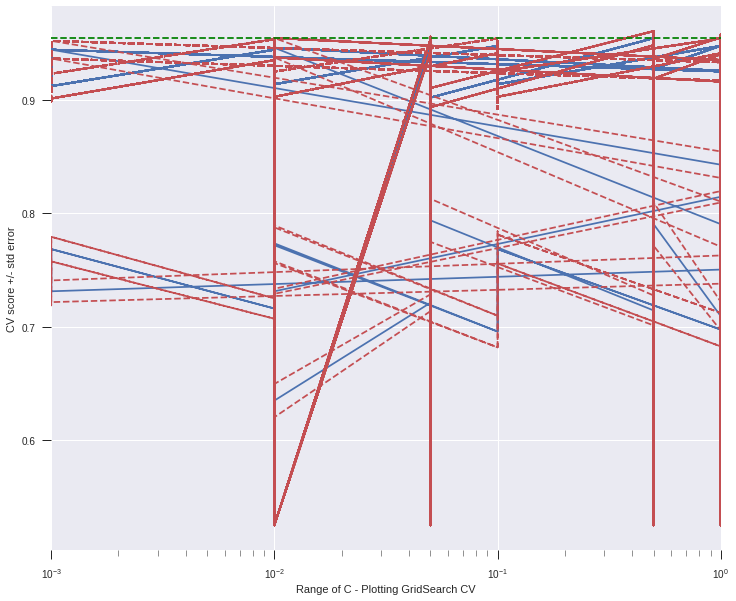

In [218]:
plot_crossval_graph(best_clf_dim, 'param_model_gs__C')
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(best_clf_dim.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=True, pca=True)

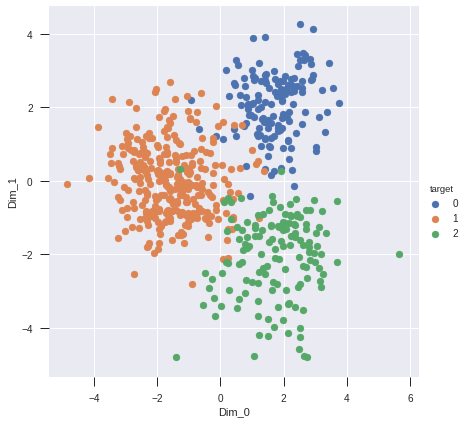

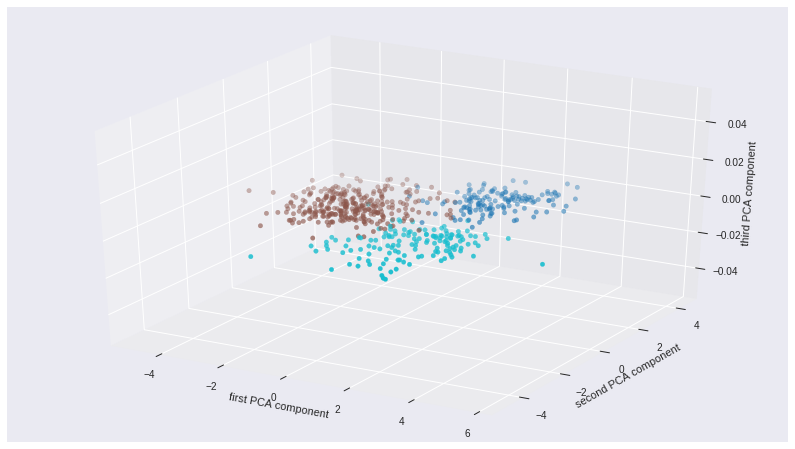

In [219]:
############################################################################
#### Visualizing LDA for the target class ##################################
############################################################################
best_model, X_train_lda, X_test_lda = get_X_Transformed_traintest_gridsearch(best_clf_dim, X_train, y_train, X_test, y_test, scaled_flag=True, pca_flag=True, verbose=False)
lda_df = visualize_pca(X_train_lda, y_train, True)
visualize_pca3D(X_train_lda, y_train)

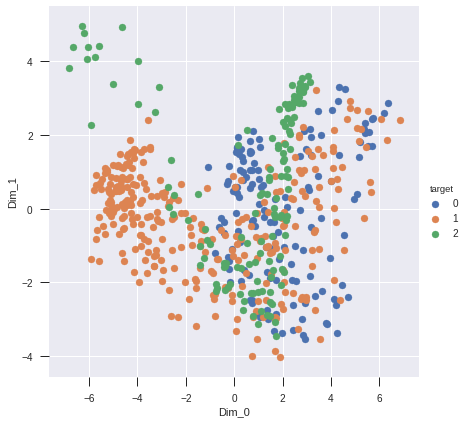

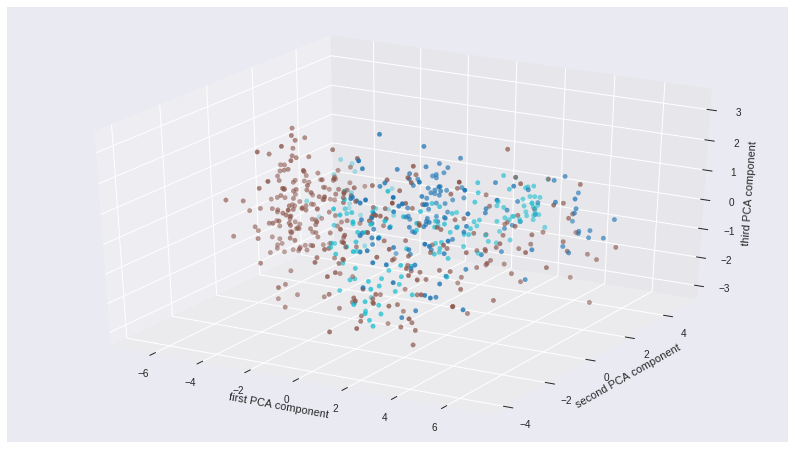

In [220]:
############################################################################
#### Comparing LDA with PCA ################################################
############################################################################
best_model, X_train_new, X_test_new = get_X_Transformed_traintest_gridsearch(best_clf_6, X_train, y_train, X_test, y_test, scaled_flag=True, pca_flag=True, verbose=False)
pca_df = visualize_pca(X_train_new, y_train, True)
visualize_pca3D(X_train_new, y_train)

### Lot of overlaps in PCA but, LDA is retaining the information within target class and clearly demonstrating better clustering of the target variables without loss of information. LDA has also given us 2% improvement for identifying class 1 (van) compared to PCA with hyperparameter tuned best model.

### Summarizing :

###### Principal Component Analysis (PCA) 
identifies the combination of attributes (principal components, or directions in the feature space) that account for the most variance in the data

###### Linear Discriminant Analysis (LDA) 
tries to identify attributes that account for the most variance between classes. In particular, LDA, in contrast to PCA, is a supervised method, using known class labels.

###### Neighborhood Components Analysis (NCA) 
tries to find a feature space such that a stochastic nearest neighbor algorithm will give the best accuracy. Like LDA, it is a supervised method. NCA enforces a clustering of the data that is visually meaningful despite the large reduction in dimension.
https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.NeighborhoodComponentsAnalysis.html#sklearn.neighbors.NeighborhoodComponentsAnalysis

In [259]:
#######################################################################################
########## Trying NCA to see how it is classifying these 3 target variables ###########
#######################################################################################

n_folds = 5
scaling_options = [StandardScaler()]
collinear_removal_techniques = [NeighborhoodComponentsAnalysis()]

pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('dimension_reduction', NeighborhoodComponentsAnalysis()),
    ('model_gs' , LogisticRegression())
])

param_grid_models = [   
    {'scaler': scaling_options,
     'dimension_reduction': collinear_removal_techniques,
     'model_gs' : [svm.SVC()],
    'model_gs__C': [0.01, 0.5, 1],
    'model_gs__gamma': [0.01, 0.1, 1],
    'model_gs__kernel': ['linear', 'poly'],
    'model_gs__degree': [2],
    'model_gs__decision_function_shape': ['ovo'],
    'model_gs__random_state': [42]}
]

In [260]:
#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)
best_clf_neighbor = grid.fit(X_train, y_train)

Fitting 5 folds for each of 18 candidates, totalling 90 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:   11.4s
[Parallel(n_jobs=-1)]: Done  90 out of  90 | elapsed:   32.0s finished


In [261]:
best_clf_neighbor.best_estimator_

Pipeline(memory=None,
         steps=[('scaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('dimension_reduction',
                 NeighborhoodComponentsAnalysis(callback=None, init='auto',
                                                max_iter=50, n_components=None,
                                                random_state=None, tol=1e-05,
                                                verbose=0, warm_start=False)),
                ('model_gs',
                 SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
                     decision_function_shape='ovo', degree=2, gamma=0.01,
                     kernel='linear', max_iter=-1, probability=False,
                     random_state=42, shrinking=True, tol=0.001,
                     verbose=False))],
         verbose=False)

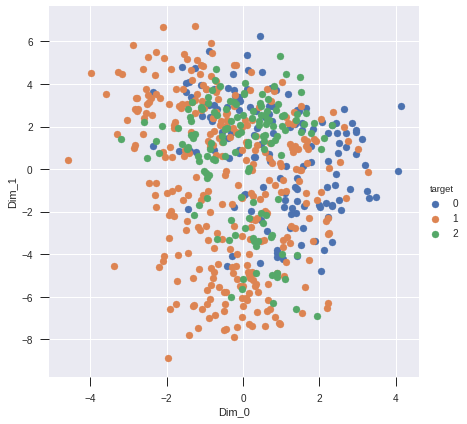

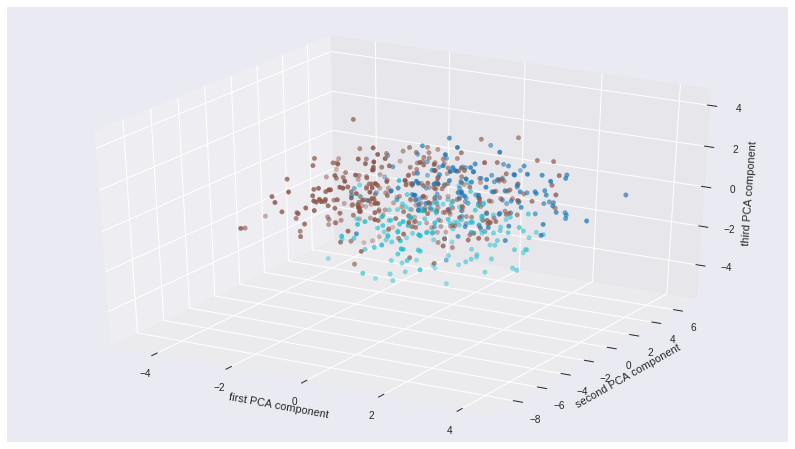

In [262]:
############################################################################
#### Visualizing NCA for the target class ##################################
############################################################################
best_model, X_train_nca, X_test_nca = get_X_Transformed_traintest_gridsearch(best_clf_neighbor, X_train, y_train, X_test, y_test, scaled_flag=True, pca_flag=True, verbose=False)
nca_df = visualize_pca(X_train_nca, y_train, True)
visualize_pca3D(X_train_nca, y_train)

In [263]:
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(best_clf_neighbor.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=True, pca=True)

Inside PCA and Scaler included in grid search <True, True>
Features reduced to : [18]

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 54   4   0]
 [  2 110   6]
 [  2   4  72]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.93      0.93      0.93        58
           1       0.93      0.93      0.93       118
           2       0.92      0.92      0.92        78

    accuracy                           0.93       254
   macro avg       0.93      0.93      0.93       254
weighted avg       0.93      0.93      0.93       254



### NCA technique is actually NOT BAD. It consistently had around 93% of chance to identify each of the class targets - bus, van and car based on F1 score evaluation.

ONE CAUTION :- NCA will be computationally very slow if experimented with other hyperparameters to find best matching NCA parameters. 

In [223]:
###############################################################################
############# EXPERIMENTING T-SNE #############################################
#### Let us get the best model fit in grid search WITHOUT PCA #################
###############################################################################
best_model, X_train_scaled_nopca, X_test_scaled_nopca = get_X_Transformed_traintest_gridsearch(best_clf_3, X_train, y_train, X_test, y_test, 
                                                                                               scaled_flag=True, 
                                                                                   pca_flag=False, verbose=False)
X_train_scaled_nopca.shape, X_test_scaled_nopca.shape

((592, 18), (254, 18))

In [224]:
###########################################################################################################
############ Utility function for tsne - to estimate the cost with various hyperparameters of tsne ########
###########################################################################################################
from joblib import Parallel, delayed

def tsne_optimization(n_components_list, perplexity_list, n_iteration_list, learning_rate_list, X):
    tsne_iteration_results = pd.DataFrame()
    start_time = time.clock()
    for learning_rate in learning_rate_list:
        for iteration in n_iteration_list:
            for perplexity in perplexity_list:
                for component in n_components_list:
                    print("############ BEGIN ITERATION ##################")
                    print("Iteration <component, perplexity, iteration, learning rate> : <%s,%s,%s,%s>"%(component, perplexity, iteration, learning_rate))
                    tsne_transformer = TSNE(n_components=component, 
                                            perplexity=perplexity, 
                                            n_iter=iteration,
                                            learning_rate=learning_rate,
                                            method='exact',
                                           verbose=1, random_state=42)
                    tsne_embedded = tsne_transformer.fit_transform(X)
                    #print(np.array([[learning_rate,iteration,perplexity,component,tsne_transformer.kl_divergence_]]))
                    temp_1 = pd.DataFrame(np.array([[learning_rate,iteration,perplexity,component,tsne_transformer.kl_divergence_]]),
                                          columns=["learning_rate", "iteration", "perplexity", "component", "cost"])
                    
                    tsne_iteration_results = pd.concat([tsne_iteration_results, temp_1], axis=0)
                    print("############ END ITERATION ##################")
    end_time = time.clock()
    print("TOTAL TIME FOR TSNE ITERATIONS : %s"%(end_time - start_time))
    
    return tsne_iteration_results

In [225]:
###########################################################################################
######## Experimenting various tsne parameters to see what fits our data ##################
################## Need to introduce parallel processing - future scope####################
###########################################################################################
tsne_components = [1,2,3,4,5,6,7,8]
tsne_perplexity = [20,30,40,50,60,70]
tsne_iteration = [250, 300, 350,400,450,500]
tsne_learning_rate = [20, 30, 100, 200, 250, 300, 350]

tsne_iteration_df = tsne_optimization(tsne_components, tsne_perplexity, tsne_iteration, 
                                      tsne_learning_rate, X_train_scaled_nopca)

############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,20,250,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.568848
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,20,250,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[

[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.210364
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,30,250,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.233818
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894641

[t-SNE] KL divergence after 250 iterations: 0.516285
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,50,250,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.516842
[t-SNE] KL divergence after 250 iterations: 0.476786
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,50,250,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.531144
[t-SNE] KL divergence after 250 iterations: 0.562113
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 250 iterations: 0.481584
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,20,300,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.568848
[t-SNE] KL divergence after 300 iterations: 1.649926
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,20,300,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.276069
[t-SNE] KL divergence after 300 iterations: 1.097365
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 300 iterations: 0.635788
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,40,300,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.524946
[t-SNE] KL divergence after 300 iterations: 0.585182
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,40,300,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.561213
[t-SNE] KL divergence after 300 iterations: 0.548639
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 300 iterations: 0.298935
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,60,300,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.830169
[t-SNE] KL divergence after 300 iterations: 0.328518
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,60,300,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.839433
[t-SNE] KL divergence after 300 iterations: 0.498704
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 350 iterations: 1.188147
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,30,350,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.915644
[t-SNE] KL divergence after 350 iterations: 0.830242
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,30,350,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.096402
[t-SNE] KL divergence after 350 iterations: 0.700514
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 350 iterations: 0.392350
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,50,350,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.496131
[t-SNE] KL divergence after 350 iterations: 0.372484
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,50,350,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.516842
[t-SNE] KL divergence after 350 iterations: 0.317748
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 350 iterations: 0.288231
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,70,350,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.394958
[t-SNE] KL divergence after 350 iterations: 0.514909
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,20,400,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.568848
[t-SNE] KL divergence after 400 iterations: 1.343530
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 400 iterations: 0.706901
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,40,400,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.458718
[t-SNE] KL divergence after 400 iterations: 0.555980
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,40,400,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.524946
[t-SNE] KL divergence after 400 iterations: 0.480000
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 400 iterations: 0.299238
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,60,400,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.817585
[t-SNE] KL divergence after 400 iterations: 0.252264
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,60,400,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.830169
[t-SNE] KL divergence after 400 iterations: 0.212825
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 450 iterations: 0.482662
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,30,450,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 200 iterations with early exaggeration: 58.915645
[t-SNE] KL divergence after 450 iterations: 1.152964
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,30,450,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.915644
[t-SNE] KL divergence after 450 iterations: 0.738502
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 450 iterations: 0.457986
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,50,450,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.463631
[t-SNE] KL divergence after 450 iterations: 0.394162
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,50,450,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.496131
[t-SNE] KL divergence after 450 iterations: 0.349257
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 450 iterations: 0.277529
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,70,450,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.387114
[t-SNE] KL divergence after 450 iterations: 0.354108
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,70,450,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.394958
[t-SNE] KL divergence after 450 iterations: 0.579309
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 500 iterations: 1.048123
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,40,500,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.306793
[t-SNE] KL divergence after 500 iterations: 0.692649
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,40,500,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.458718
[t-SNE] KL divergence after 500 iterations: 0.541359
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 500 iterations: 0.365876
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,60,500,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.799533
[t-SNE] KL divergence after 500 iterations: 0.344634
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,60,500,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.817585
[t-SNE] KL divergence after 500 iterations: 0.325849
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.633143
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,20,250,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.657560
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894641

[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.306793
[t-SNE] KL divergence after 250 iterations: 1.169501
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,40,250,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.306793
[t-SNE] KL divergence after 250 iterations: 0.906747
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,40,250,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.458718
[t-SNE] KL divergence after 250 iterations: 0.869195
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.771530
[t-SNE] KL divergence after 250 iterations: 0.411811
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,60,250,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.799533
[t-SNE] KL divergence after 250 iterations: 0.377868
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,60,250,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.817585
[t-SNE] KL divergence after 250 iterations: 0.434978
#

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.672741
[t-SNE] KL divergence after 300 iterations: 0.675905
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,20,300,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.682902
[t-SNE] KL divergence after 300 iterations: 0.674198
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,30,300,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 200 iterations with early exaggeration: 58.915645
[t-SNE] KL divergence after 300 iterations: 1.210647
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.277673
[t-SNE] KL divergence after 300 iterations: 0.635542
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,50,300,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.405866
[t-SNE] KL divergence after 300 iterations: 0.498734
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,50,300,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.463631
[t-SNE] KL divergence after 300 iterations: 0.406170
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.361346
[t-SNE] KL divergence after 300 iterations: 0.264824
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,70,300,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.376500
[t-SNE] KL divergence after 300 iterations: 0.309329
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,70,300,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.387114
[t-SNE] KL divergence after 300 iterations: 0.449217
#

[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.259845
[t-SNE] KL divergence after 350 iterations: 0.455210
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,40,350,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.306793
[t-SNE] KL divergence after 350 iterations: 1.053176
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,40,350,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.306793
[t-SNE] KL divergence after 350 iterations: 0.692913
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.722466
[t-SNE] KL divergence after 350 iterations: 0.415582
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,60,350,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.771530
[t-SNE] KL divergence after 350 iterations: 0.329928
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,60,350,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.799533
[t-SNE] KL divergence after 350 iterations: 0.297701
#

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.657560
[t-SNE] KL divergence after 400 iterations: 0.525044
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,20,400,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.672741
[t-SNE] KL divergence after 400 iterations: 0.499290
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,20,400,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.682902
[t-SNE] KL divergence after 400 iterations: 0.482235
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.277674
[t-SNE] KL divergence after 400 iterations: 0.955487
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,50,400,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.277673
[t-SNE] KL divergence after 400 iterations: 0.621126
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,50,400,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.405866
[t-SNE] KL divergence after 400 iterations: 0.446754
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.337975
[t-SNE] KL divergence after 400 iterations: 0.317487
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,70,400,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.361346
[t-SNE] KL divergence after 400 iterations: 0.285652
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,70,400,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.376500
[t-SNE] KL divergence after 400 iterations: 0.307472
#

[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.249160
[t-SNE] KL divergence after 450 iterations: 0.405234
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,30,450,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.259845
[t-SNE] KL divergence after 450 iterations: 0.395636
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,40,450,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.306793
[t-SNE] KL divergence after 450 iterations: 1.044224
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.615605
[t-SNE] KL divergence after 450 iterations: 0.583304
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,60,450,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.722466
[t-SNE] KL divergence after 450 iterations: 0.415934
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,60,450,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.771530
[t-SNE] KL divergence after 450 iterations: 0.363602
#

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.633143
[t-SNE] KL divergence after 500 iterations: 0.545224
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,20,500,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.657560
[t-SNE] KL divergence after 500 iterations: 0.522149
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,20,500,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.672741
[t-SNE] KL divergence after 500 iterations: 0.510313
#

[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.610107
[t-SNE] KL divergence after 500 iterations: 0.687902
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,50,500,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.277674
[t-SNE] KL divergence after 500 iterations: 0.955427
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,50,500,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.277673
[t-SNE] KL divergence after 500 iterations: 0.619042
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.297341
[t-SNE] KL divergence after 500 iterations: 0.395658
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,70,500,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.337975
[t-SNE] KL divergence after 500 iterations: 0.331077
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,70,500,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.361346
[t-SNE] KL divergence after 500 iterations: 0.316474
#

[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.947651
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,30,250,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.956974
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.383988
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,40,250,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.583807
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.633560
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,60,250,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.624350
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 200 iterations with early exaggeration: 51.361346
[t-SNE] KL divergence after 250 iterations: 0.523122
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,70,250,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.510582
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity

[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.220863
[t-SNE] KL divergence after 300 iterations: 0.592773
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,30,300,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.259844
[t-SNE] KL divergence after 300 iterations: 0.720969
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,40,300,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.346811
[t-SNE] KL divergence after 300 iterations: 1.095151

[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.624350
[t-SNE] KL divergence after 300 iterations: 0.641571
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,60,300,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.724338
[t-SNE] KL divergence after 300 iterations: 0.488750
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,60,300,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.771530
[t-SNE] KL divergence after 300 iterations: 0.485438

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.634883
[t-SNE] KL divergence after 350 iterations: 0.547637
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,20,350,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.957657
[t-SNE] KL divergence after 350 iterations: 0.671025
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,20,350,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.672596
[t-SNE] KL divergence after 350 iterations: 0.506870

[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.444571
[t-SNE] KL divergence after 350 iterations: 1.245001
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,50,350,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.288886
[t-SNE] KL divergence after 350 iterations: 0.958966
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,50,350,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.317176
[t-SNE] KL divergence after 350 iterations: 0.636815

[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.931237
[t-SNE] KL divergence after 350 iterations: 0.453900
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,70,350,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.337975
[t-SNE] KL divergence after 350 iterations: 0.343523
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,70,350,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 200 iterations with early exaggeration: 51.361346
[t-SNE] KL divergence after 350 iterations: 0.443781

[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.966008
[t-SNE] KL divergence after 400 iterations: 0.455591
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,30,400,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.220863
[t-SNE] KL divergence after 400 iterations: 0.503559
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,30,400,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.259844
[t-SNE] KL divergence after 400 iterations: 0.592643

[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.633560
[t-SNE] KL divergence after 400 iterations: 0.883486
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,60,400,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.624350
[t-SNE] KL divergence after 400 iterations: 0.611594
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,60,400,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.724338
[t-SNE] KL divergence after 400 iterations: 0.416291

[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.116793
[t-SNE] KL divergence after 450 iterations: 0.603110
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,20,450,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.634883
[t-SNE] KL divergence after 450 iterations: 0.537586
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,20,450,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.957657
[t-SNE] KL divergence after 450 iterations: 0.654754

[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.599111
[t-SNE] KL divergence after 450 iterations: 0.791903
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,40,450,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.444571
[t-SNE] KL divergence after 450 iterations: 1.196385
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,50,450,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.288886
[t-SNE] KL divergence after 450 iterations: 0.956029

[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.238194
[t-SNE] KL divergence after 450 iterations: 0.540641
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,70,450,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.931237
[t-SNE] KL divergence after 450 iterations: 0.428472
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,70,450,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.337975
[t-SNE] KL divergence after 450 iterations: 0.322986

[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.210309
[t-SNE] KL divergence after 500 iterations: 0.498342
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,30,500,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.966008
[t-SNE] KL divergence after 500 iterations: 0.532358
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,30,500,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.220863
[t-SNE] KL divergence after 500 iterations: 0.604916

[t-SNE] KL divergence after 200 iterations with early exaggeration: 54.541590
[t-SNE] KL divergence after 500 iterations: 1.109952
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,60,500,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.633560
[t-SNE] KL divergence after 500 iterations: 0.883456
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,60,500,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.624350
[t-SNE] KL divergence after 500 iterations: 0.608885

[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.979272
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,20,250,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.368919
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 75.921532
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,30,250,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.711596
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.371371
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,50,250,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.941974
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.288828
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,60,250,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.774019
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.979272
[t-SNE] KL divergence after 300 iterations: 2.402215
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,20,300,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.368919
[t-SNE] KL divergence after 300 iterations: 2.556228
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,20,300,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 88.577217
[t-SNE] KL divergence after 300 iterations: 2.258231

[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.456857
[t-SNE] KL divergence after 300 iterations: 1.333006
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,40,300,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.310411
[t-SNE] KL divergence after 300 iterations: 1.275398
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,40,300,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.220079
[t-SNE] KL divergence after 300 iterations: 1.550185

[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.098606
[t-SNE] KL divergence after 300 iterations: 0.859228
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,70,300,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.076596
[t-SNE] KL divergence after 300 iterations: 0.579901
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,70,300,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.799525
[t-SNE] KL divergence after 300 iterations: 1.273057

[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.636514
[t-SNE] KL divergence after 350 iterations: 1.725813
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,30,350,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.212591
[t-SNE] KL divergence after 350 iterations: 1.523704
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,30,350,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.635928
[t-SNE] KL divergence after 350 iterations: 1.291913

[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.960330
[t-SNE] KL divergence after 350 iterations: 0.902897
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,50,350,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.877640
[t-SNE] KL divergence after 350 iterations: 1.301785
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,60,350,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.087870
[t-SNE] KL divergence after 350 iterations: 0.909791

[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.476932
[t-SNE] KL divergence after 400 iterations: 0.791812
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,20,400,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.979272
[t-SNE] KL divergence after 400 iterations: 1.746038
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,20,400,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.368919
[t-SNE] KL divergence after 400 iterations: 2.075761

[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.404401
[t-SNE] KL divergence after 400 iterations: 1.191614
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,40,400,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.456857
[t-SNE] KL divergence after 400 iterations: 1.197270
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,40,400,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.310411
[t-SNE] KL divergence after 400 iterations: 1.170252

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.774019
[t-SNE] KL divergence after 400 iterations: 1.189782
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,70,400,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.098606
[t-SNE] KL divergence after 400 iterations: 0.851672
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,70,400,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.076596
[t-SNE] KL divergence after 400 iterations: 0.557687

[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.861802
[t-SNE] KL divergence after 450 iterations: 1.324010
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,30,450,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.636514
[t-SNE] KL divergence after 450 iterations: 1.440421
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,30,450,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.212591
[t-SNE] KL divergence after 450 iterations: 1.619598

[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.868116
[t-SNE] KL divergence after 450 iterations: 1.023254
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,50,450,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.960330
[t-SNE] KL divergence after 450 iterations: 0.882173
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,50,450,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.877640
[t-SNE] KL divergence after 450 iterations: 1.246276

[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.441574
[t-SNE] KL divergence after 500 iterations: 1.256680
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,20,500,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.476932
[t-SNE] KL divergence after 500 iterations: 0.780290
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,20,500,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.979272
[t-SNE] KL divergence after 500 iterations: 1.437153

[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.883504
[t-SNE] KL divergence after 500 iterations: 1.103429
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,40,500,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.404401
[t-SNE] KL divergence after 500 iterations: 1.311930
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,40,500,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.456857
[t-SNE] KL divergence after 500 iterations: 1.126428

[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.288828
[t-SNE] KL divergence after 500 iterations: 1.125100
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,60,500,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.774019
[t-SNE] KL divergence after 500 iterations: 1.167227
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,70,500,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.098606
[t-SNE] KL divergence after 500 iterations: 0.851664

[t-SNE] KL divergence after 250 iterations with early exaggeration: 151.319095
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,20,250,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 145.087495
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 94.238751
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,40,250,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 108.970091
[t-SNE] KL divergence after 251 iterations: 17976931348623157081452742373170435679807056752584499659891747680315726078002853876058955863276687817154045895351438246423432132688946

[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.781375
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,50,250,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 99.010207
[t-SNE] KL divergence after 251 iterations: 17976931348623157081452742373170435679807056752584499659891747680315726078002853876058955863276687817154045895351438246423432132688946

[t-SNE] KL divergence after 250 iterations with early exaggeration: 85.631527
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,70,250,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 90.676288
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.244480
[t-SNE] KL divergence after 300 iterations: 0.836482
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,30,300,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 98.611204
[t-SNE] KL divergence after 300 iterations: 2.788732
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,30,300,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 115.559450
[t-SNE] KL divergence after 300 iterations: 3.78880

[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.913402
[t-SNE] KL divergence after 300 iterations: 3.273779
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,50,300,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 104.557179
[t-SNE] KL divergence after 300 iterations: 3.536901
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,50,300,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.781375
[t-SNE] KL divergence after 300 iterations: 3.516

[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.792681
[t-SNE] KL divergence after 300 iterations: 2.788085
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,20,350,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.762789
[t-SNE] KL divergence after 350 iterations: 1.399823
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,20,350,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.315362
[t-SNE] KL divergence after 350 iterations: 0.850151

[t-SNE] KL divergence after 250 iterations with early exaggeration: 94.238751
[t-SNE] KL divergence after 350 iterations: 2.241498
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,40,350,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 108.970091
[t-SNE] KL divergence after 350 iterations: 3.088012
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,40,350,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 102.936278
[t-SNE] KL divergence after 350 iterations: 2.8433

[t-SNE] KL divergence after 250 iterations with early exaggeration: 93.478731
[t-SNE] KL divergence after 350 iterations: 2.711294
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,60,350,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 93.563563
[t-SNE] KL divergence after 350 iterations: 2.710231
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,60,350,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 93.160717
[t-SNE] KL divergence after 350 iterations: 2.877171

[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.609606
[t-SNE] KL divergence after 400 iterations: 1.177165
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,30,400,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.244480
[t-SNE] KL divergence after 400 iterations: 0.748389
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,30,400,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 98.611204
[t-SNE] KL divergence after 400 iterations: 2.123152

[t-SNE] KL divergence after 250 iterations with early exaggeration: 99.460158
[t-SNE] KL divergence after 400 iterations: 2.493536
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,50,400,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.913402
[t-SNE] KL divergence after 400 iterations: 2.788594
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,50,400,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 104.557179
[t-SNE] KL divergence after 400 iterations: 3.1363

[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.061689
[t-SNE] KL divergence after 400 iterations: 2.544535
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,70,400,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.792681
[t-SNE] KL divergence after 400 iterations: 2.559531
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,20,450,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.762789
[t-SNE] KL divergence after 450 iterations: 1.332202

[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.508600
[t-SNE] KL divergence after 450 iterations: 0.655760
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,40,450,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 94.238751
[t-SNE] KL divergence after 450 iterations: 1.878002
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,40,450,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 108.970091
[t-SNE] KL divergence after 450 iterations: 2.68692

[t-SNE] KL divergence after 250 iterations with early exaggeration: 97.769353
[t-SNE] KL divergence after 450 iterations: 2.403929
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,60,450,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 93.478731
[t-SNE] KL divergence after 450 iterations: 2.497927
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,60,450,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 93.563563
[t-SNE] KL divergence after 450 iterations: 2.513198

[t-SNE] KL divergence after 250 iterations with early exaggeration: 145.087495
[t-SNE] KL divergence after 500 iterations: 4.868701
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,30,500,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.609606
[t-SNE] KL divergence after 500 iterations: 1.166451
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,30,500,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.244480
[t-SNE] KL divergence after 500 iterations: 0.72836

[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.134676
[t-SNE] KL divergence after 500 iterations: 1.589827
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,50,500,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 99.460158
[t-SNE] KL divergence after 500 iterations: 2.265518
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,50,500,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.913402
[t-SNE] KL divergence after 500 iterations: 2.58018

[t-SNE] KL divergence after 250 iterations with early exaggeration: 91.572468
[t-SNE] KL divergence after 500 iterations: 2.364236
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,70,500,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.061689
[t-SNE] KL divergence after 500 iterations: 2.423952
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,70,500,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.792681
[t-SNE] KL divergence after 500 iterations: 2.456651

[t-SNE] KL divergence after 250 iterations with early exaggeration: 113.237625
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,30,250,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 134.583874
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 138.029760
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,40,250,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 140.121103
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 104.969891
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,60,250,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 110.944884
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 116.226823
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,70,250,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 109.695734
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.862531
[t-SNE] KL divergence after 300 iterations: 1.133372
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,40,300,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.811449
[t-SNE] KL divergence after 300 iterations: 0.747502
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,40,300,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 111.610718
[t-SNE] KL divergence after 300 iterations: 3.29312

[t-SNE] KL divergence after 250 iterations with early exaggeration: 110.944884
[t-SNE] KL divergence after 300 iterations: 3.510565
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,60,300,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 120.495239
[t-SNE] KL divergence after 300 iterations: 4.137136
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,60,300,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 121.461954
[t-SNE] KL divergence after 300 iterations: 4.268

[t-SNE] KL divergence after 250 iterations with early exaggeration: 177.703544
[t-SNE] KL divergence after 350 iterations: 6.688083
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,20,350,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 185.378373
[t-SNE] KL divergence after 350 iterations: 7.329934
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,30,350,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.860622
[t-SNE] KL divergence after 350 iterations: 1.2286

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.041076
[t-SNE] KL divergence after 350 iterations: 0.665503
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,50,350,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 105.080117
[t-SNE] KL divergence after 350 iterations: 2.495158
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,50,350,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 117.769348
[t-SNE] KL divergence after 350 iterations: 3.3989

[t-SNE] KL divergence after 250 iterations with early exaggeration: 114.169785
[t-SNE] KL divergence after 350 iterations: 3.423545
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,70,350,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 119.408932
[t-SNE] KL divergence after 350 iterations: 3.806714
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,70,350,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 116.226823
[t-SNE] KL divergence after 350 iterations: 4.079

[t-SNE] KL divergence after 250 iterations with early exaggeration: 150.643196
[t-SNE] KL divergence after 400 iterations: 5.370904
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,40,400,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.862531
[t-SNE] KL divergence after 400 iterations: 1.091651
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,40,400,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.811449
[t-SNE] KL divergence after 400 iterations: 0.66861

[t-SNE] KL divergence after 250 iterations with early exaggeration: 104.969891
[t-SNE] KL divergence after 400 iterations: 2.322004
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,60,400,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 110.944884
[t-SNE] KL divergence after 400 iterations: 2.893965
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,60,400,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 120.495239
[t-SNE] KL divergence after 400 iterations: 3.536

[t-SNE] KL divergence after 250 iterations with early exaggeration: 175.147426
[t-SNE] KL divergence after 450 iterations: 5.958122
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,20,450,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 177.703544
[t-SNE] KL divergence after 450 iterations: 6.182304
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,20,450,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 185.378373
[t-SNE] KL divergence after 450 iterations: 6.845

[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.574325
[t-SNE] KL divergence after 450 iterations: 1.028885
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,50,450,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.041076
[t-SNE] KL divergence after 450 iterations: 0.660508
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,50,450,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 105.080117
[t-SNE] KL divergence after 450 iterations: 2.15111

[t-SNE] KL divergence after 250 iterations with early exaggeration: 110.484459
[t-SNE] KL divergence after 450 iterations: 2.819054
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,70,450,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 114.169785
[t-SNE] KL divergence after 450 iterations: 3.081613
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,70,450,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 119.408932
[t-SNE] KL divergence after 450 iterations: 3.473

[t-SNE] KL divergence after 250 iterations with early exaggeration: 152.661025
[t-SNE] KL divergence after 500 iterations: 5.038961
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,30,500,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 150.643196
[t-SNE] KL divergence after 500 iterations: 5.113158
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,40,500,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.862531
[t-SNE] KL divergence after 500 iterations: 1.0885

[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.463494
[t-SNE] KL divergence after 500 iterations: 0.574406
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,60,500,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 104.969891
[t-SNE] KL divergence after 500 iterations: 2.097483
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,60,500,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 110.944884
[t-SNE] KL divergence after 500 iterations: 2.6642

[t-SNE] KL divergence after 250 iterations with early exaggeration: 160.967878
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,20,250,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 179.080848
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 193.125204
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,40,250,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.826983
[t-SNE] KL divergence after 251 iterations: 17976931348623157081452742373170435679807056752584499659891747680315726078002853876058955863276687817154045895351438246423432132688946

[t-SNE] KL divergence after 250 iterations with early exaggeration: 139.661706
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,50,250,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 148.725253
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 157.487986
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,70,250,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.863409
[t-SNE] KL divergence after 251 iterations: 17976931348623157081452742373170435679807056752584499659891747680315726078002853876058955863276687817154045895351438246423432132688946

[t-SNE] KL divergence after 250 iterations with early exaggeration: 179.080848
[t-SNE] KL divergence after 300 iterations: 6.440733
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,20,300,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 193.769374
[t-SNE] KL divergence after 300 iterations: 7.592037
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,20,300,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 204.111445
[t-SNE] KL divergence after 300 iterations: 8.460

[t-SNE] KL divergence after 250 iterations with early exaggeration: 181.193393
[t-SNE] KL divergence after 300 iterations: 7.600233
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,50,300,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.702271
[t-SNE] KL divergence after 300 iterations: 1.026210
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,50,300,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.851530
[t-SNE] KL divergence after 300 iterations: 0.71563

[t-SNE] KL divergence after 250 iterations with early exaggeration: 109.762926
[t-SNE] KL divergence after 300 iterations: 3.025360
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,70,300,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 134.007519
[t-SNE] KL divergence after 300 iterations: 4.391968
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,70,300,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 145.281045
[t-SNE] KL divergence after 300 iterations: 4.897

[t-SNE] KL divergence after 250 iterations with early exaggeration: 180.465670
[t-SNE] KL divergence after 350 iterations: 6.330688
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,30,350,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 182.259726
[t-SNE] KL divergence after 350 iterations: 6.646652
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,30,350,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 193.125204
[t-SNE] KL divergence after 350 iterations: 7.648

[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.764111
[t-SNE] KL divergence after 350 iterations: 0.908801
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,60,350,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.528150
[t-SNE] KL divergence after 350 iterations: 0.611344
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,60,350,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 112.245722
[t-SNE] KL divergence after 350 iterations: 2.82131

[t-SNE] KL divergence after 250 iterations with early exaggeration: 160.967878
[t-SNE] KL divergence after 400 iterations: 4.655114
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,20,400,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 179.080848
[t-SNE] KL divergence after 400 iterations: 5.495739
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,20,400,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 193.769374
[t-SNE] KL divergence after 400 iterations: 6.684

[t-SNE] KL divergence after 250 iterations with early exaggeration: 174.015921
[t-SNE] KL divergence after 400 iterations: 6.310688
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,40,400,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 181.193393
[t-SNE] KL divergence after 400 iterations: 6.946420
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,50,400,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.456630
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.702271
[t-SNE] KL divergence after 400 iterations: 1.0009

[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.804217
[t-SNE] KL divergence after 400 iterations: 0.578595
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,70,400,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 109.762926
[t-SNE] KL divergence after 400 iterations: 2.526744
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,70,400,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 134.007519
[t-SNE] KL divergence after 400 iterations: 3.6197

[t-SNE] KL divergence after 250 iterations with early exaggeration: 167.510530
[t-SNE] KL divergence after 450 iterations: 4.862088
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,30,450,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 180.465670
[t-SNE] KL divergence after 450 iterations: 5.782947
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,30,450,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 182.259726
[t-SNE] KL divergence after 450 iterations: 6.160

[t-SNE] KL divergence after 250 iterations with early exaggeration: 165.626076
[t-SNE] KL divergence after 450 iterations: 5.899050
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,60,450,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.764111
[t-SNE] KL divergence after 450 iterations: 0.908404
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,60,450,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.528150
[t-SNE] KL divergence after 450 iterations: 0.60749

[t-SNE] KL divergence after 250 iterations with early exaggeration: 117.937545
[t-SNE] KL divergence after 500 iterations: 2.852581
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,20,500,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 160.967878
[t-SNE] KL divergence after 500 iterations: 4.318295
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,20,500,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.105907
[t-SNE] KL divergence after 250 iterations with early exaggeration: 179.080848
[t-SNE] KL divergence after 500 iterations: 5.099

[t-SNE] KL divergence after 250 iterations with early exaggeration: 164.286663
[t-SNE] KL divergence after 500 iterations: 5.109635
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,40,500,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 174.015921
[t-SNE] KL divergence after 500 iterations: 5.947307
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,40,500,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.360726
[t-SNE] KL divergence after 250 iterations with early exaggeration: 181.193393
[t-SNE] KL divergence after 500 iterations: 6.607

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.863409
[t-SNE] KL divergence after 500 iterations: 0.936848
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,70,500,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.804217
[t-SNE] KL divergence after 500 iterations: 0.578415
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,70,500,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 250 iterations with early exaggeration: 109.762926
[t-SNE] KL divergence after 500 iterations: 2.35397

In [226]:
temp_tsne_df = tsne_iteration_df.copy()

In [227]:
############################################################################################
### without parallel processing - TOTAL TIME FOR TSNE ITERATIONS : 14673.974902 seconds#####
#### Sorting by lowest cost to observe for best tsne parameters to apply ###################
############################################################################################

tsne_iteration_df = tsne_iteration_df.sort_values(by='cost').reset_index()
tsne_iteration_df.drop(['index'], axis=1, inplace = True )
tsne_iteration_df['index'] = tsne_iteration_df.index.values
tsne_iteration_df.head(10)

,learning_rate,iteration,perplexity,component,cost,index
0,20.0,400.0,60.0,7.0,0.212825,0
1,20.0,350.0,70.0,6.0,0.216867,1
2,20.0,500.0,50.0,7.0,0.229621,2
3,20.0,400.0,70.0,6.0,0.237579,3
4,20.0,450.0,60.0,7.0,0.238301,4
5,30.0,400.0,60.0,6.0,0.245685,5
6,20.0,300.0,70.0,6.0,0.247055,6
7,20.0,350.0,60.0,6.0,0.248668,7
8,30.0,350.0,70.0,5.0,0.249158,8
9,100.0,450.0,50.0,5.0,0.251231,9


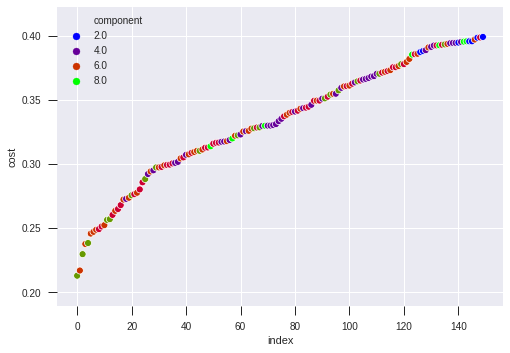

In [228]:
#####################################################
#### Plotting the cost vs other tsne parameters #####
#####################################################
sns.scatterplot(x="index", y="cost", hue="component", palette="brg", data=tsne_iteration_df.head(150))


##### TOP TWO BEST PARAMETERS OF TSNE : learning_rate, iteration, perplexity, component, cost
1. 0, 20.0, 400.0, 60.0, 7.0, 0.212825
2. 1, 20.0, 350.0, 70.0, 6.0, 0.216867	

#### Observation : 
We could see that, KL divergence has been on lower with n_components = 7, learning rate = 20, iteration = 400 and perplexity = 60. We will proceed with clustering as per this parameters and observe how efficient it could be.

[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.248386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.197003
[t-SNE] KL divergence after 300 iterations: 0.861956
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 254 / 254
[t-SNE] Mean sigma: 1.626905
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.297870
[t-SNE] KL divergence after 300 iterations: 0.519099


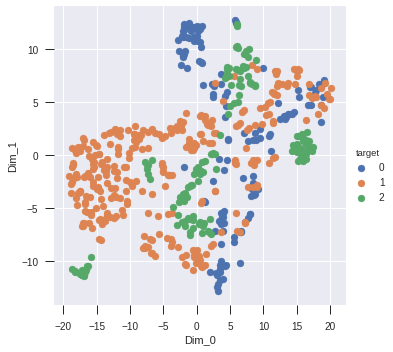

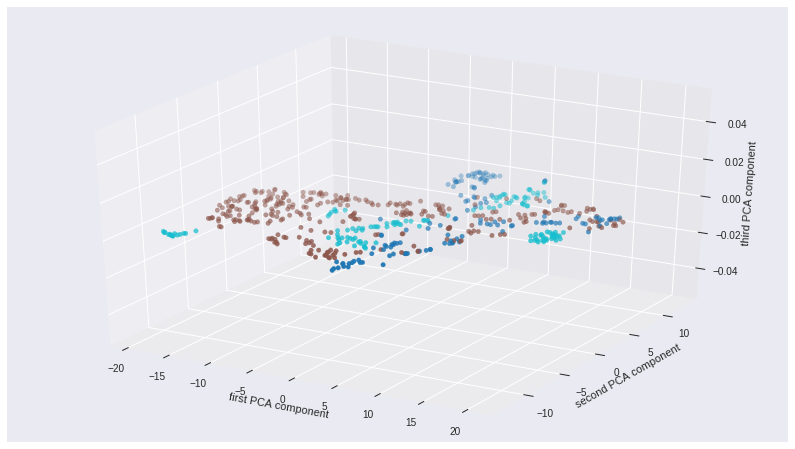

In [229]:
#############################################################################################################
########## Plotting the default tsne parameters with components as 2, iteration 300 and perplexity 30 #######
#############################################################################################################

tsne_transformer = TSNE(n_components=2, verbose=1, perplexity=30, n_iter=300, method='exact')
X_tsne_embedded_1 = tsne_transformer.fit_transform(X_train_scaled_nopca)
X_test_tsne1 = tsne_transformer.fit_transform(X_test_scaled_nopca)
tsne_df = visualize_pca(X_tsne_embedded_1, y_train, True, size=5)
visualize_pca3D(X_tsne_embedded_1, y_train)

#### Observation for default T-SNE parameters: 

Tsne with default parameters definitely did not group the data points compared to LDA. There are still overlaps observed in above plots, clustering would still struggle to isolate the target groups. Let us proceed with tuned paramters of tsne and see how it performs.

[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.542846
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.830169
[t-SNE] KL divergence after 400 iterations: 0.212825
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 254 / 254
[t-SNE] Mean sigma: 2.105396
[t-SNE] KL divergence after 150 iterations with early exaggeration: 44.987295
[t-SNE] KL divergence after 400 iterations: 0.680143


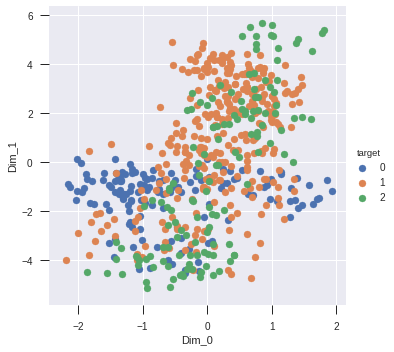

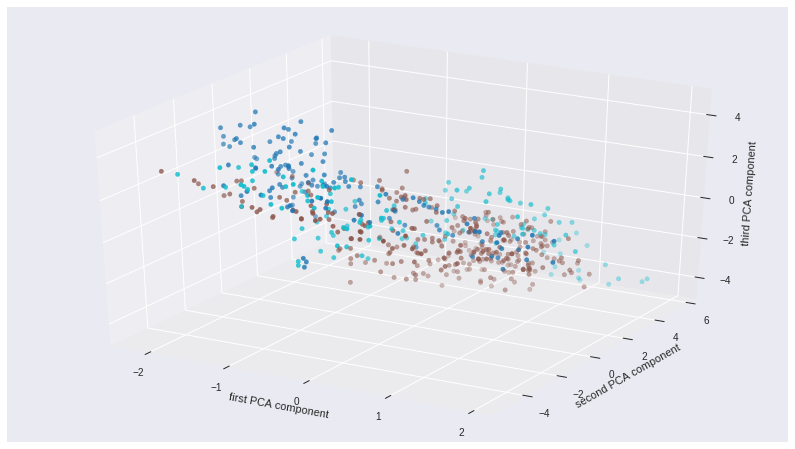

In [230]:
###############################################################################################################
########## Plotting with obstained/tuned tsne parameters with components as 7, iteration 400, perplexity 60 ###
###############################################################################################################

tsne_transformer = TSNE(n_components=7, verbose=1, perplexity=60, n_iter=400, learning_rate=20
                        , method='exact', random_state=42)
X_tsne_embedded_2 = tsne_transformer.fit_transform(X_train_scaled_nopca)
X_test_tsne2 = tsne_transformer.fit_transform(X_test_scaled_nopca)
tsne_df = visualize_pca(X_tsne_embedded_2, y_train, True, size=5)
visualize_pca3D(X_tsne_embedded_2, y_train)

[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.622867
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.376500
[t-SNE] KL divergence after 350 iterations: 0.216867
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 254 / 254
[t-SNE] Mean sigma: 2.251025
[t-SNE] KL divergence after 250 iterations with early exaggeration: 43.946300
[t-SNE] KL divergence after 350 iterations: 0.329478


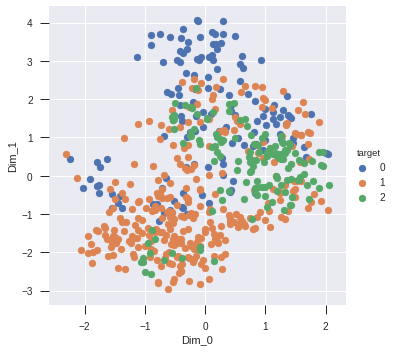

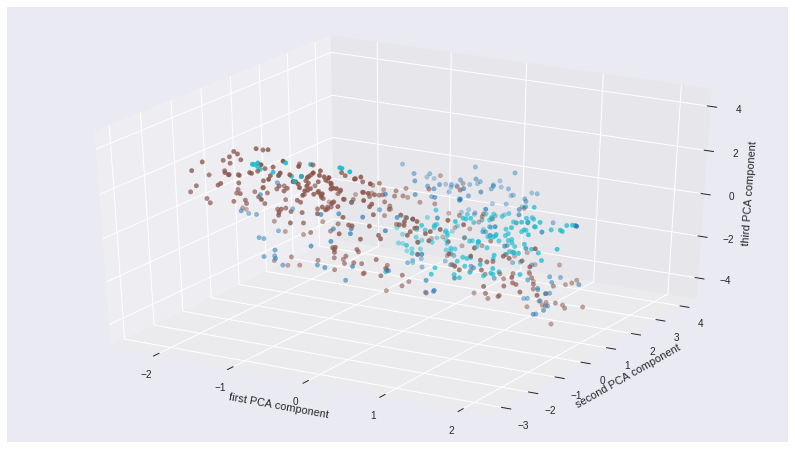

In [231]:
###############################################################################################################
########## Plotting with obstained/tuned tsne parameters with components as 6, iteration 350, perplexity 70 ###
###############################################################################################################

tsne_transformer = TSNE(n_components=6, verbose=1, perplexity=70, n_iter=350, learning_rate=20
                        , method='exact', random_state=42)
X_tsne_embedded_3 = tsne_transformer.fit_transform(X_train_scaled_nopca)
X_test_tsne3 = tsne_transformer.fit_transform(X_test_scaled_nopca)
tsne_df = visualize_pca(X_tsne_embedded_3, y_train, True, size=5)
visualize_pca3D(X_tsne_embedded_3, y_train)

In [232]:
###############################################################################
############# EXPERIMENTING T-SNE #############################################
#### Let us get the best model fit in grid search WITH PCA - 'best_clf_6' #####
###############################################################################
best_model_pca, X_train_scaled_withpca, X_test_scaled_withpca = get_X_Transformed_traintest_gridsearch(best_clf_6, X_train, y_train, X_test, y_test, 
                                                                                               scaled_flag=True, 
                                                                                   pca_flag=True, verbose=False)
X_train_scaled_withpca.shape, X_test_scaled_withpca.shape

((592, 11), (254, 11))

In [233]:
##########################################################################################################
#### Invoking TSNE Optimization method for X that has been scaled and transformed with PCA already #######
##########################################################################################################

tsne_iteration_pca_df = tsne_optimization(tsne_components, tsne_perplexity, tsne_iteration, 
                                      tsne_learning_rate, X_train_scaled_withpca)

############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,20,250,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.557009
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,20,250,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[

[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.199641
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,30,250,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.223045
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894641

[t-SNE] KL divergence after 250 iterations: 0.470631
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,50,250,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.508214
[t-SNE] KL divergence after 250 iterations: 0.470653
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,50,250,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.522534
[t-SNE] KL divergence after 250 iterations: 0.472641
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 250 iterations: 0.459175
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,20,300,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.557009
[t-SNE] KL divergence after 300 iterations: 1.648624
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,20,300,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.280466
[t-SNE] KL divergence after 300 iterations: 1.097114
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 300 iterations: 0.600024
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,40,300,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.514840
[t-SNE] KL divergence after 300 iterations: 0.549425
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,40,300,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 150 iterations with early exaggeration: 56.551099
[t-SNE] KL divergence after 300 iterations: 0.397215
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 300 iterations: 0.311402
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,60,300,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.823376
[t-SNE] KL divergence after 300 iterations: 0.334514
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,60,300,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.832679
[t-SNE] KL divergence after 300 iterations: 0.411301
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 350 iterations: 1.189458
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,30,350,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.904690
[t-SNE] KL divergence after 350 iterations: 0.837922
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,30,350,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.085715
[t-SNE] KL divergence after 350 iterations: 0.694946
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 350 iterations: 0.369276
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,50,350,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.487468
[t-SNE] KL divergence after 350 iterations: 0.356444
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,50,350,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.508214
[t-SNE] KL divergence after 350 iterations: 0.343309
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 350 iterations: 0.331030
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,70,350,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.389808
[t-SNE] KL divergence after 350 iterations: 0.485475
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,20,400,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.557009
[t-SNE] KL divergence after 400 iterations: 1.342741
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 400 iterations: 0.704823
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,40,400,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.448558
[t-SNE] KL divergence after 400 iterations: 0.540527
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,40,400,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.514840
[t-SNE] KL divergence after 400 iterations: 0.457265
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 400 iterations: 0.305587
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,60,400,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.810737
[t-SNE] KL divergence after 400 iterations: 0.272933
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,60,400,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.823376
[t-SNE] KL divergence after 400 iterations: 0.235804
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 450 iterations: 0.479680
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,30,450,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 200 iterations with early exaggeration: 58.904691
[t-SNE] KL divergence after 450 iterations: 1.155149
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,30,450,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.904690
[t-SNE] KL divergence after 450 iterations: 0.738088
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 450 iterations: 0.455464
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,50,450,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.454896
[t-SNE] KL divergence after 450 iterations: 0.390582
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,50,450,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.487468
[t-SNE] KL divergence after 450 iterations: 0.363528
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 450 iterations: 0.251921
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,70,450,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.381913
[t-SNE] KL divergence after 450 iterations: 0.408142
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,70,450,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.389808
[t-SNE] KL divergence after 450 iterations: 0.558655
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 500 iterations: 1.044861
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,40,500,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 150 iterations with early exaggeration: 56.296325
[t-SNE] KL divergence after 500 iterations: 0.695866
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,40,500,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.448558
[t-SNE] KL divergence after 500 iterations: 0.510271
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 500 iterations: 0.364174
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,60,500,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.792603
[t-SNE] KL divergence after 500 iterations: 0.347656
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,60,500,20>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.810737
[t-SNE] KL divergence after 500 iterations: 0.331885
############ END ITERATION ##################
############ BEGIN ITERATION ####

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.636577
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,20,250,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.660750
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894641

[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.296324
[t-SNE] KL divergence after 250 iterations: 1.168847
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,40,250,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.296324
[t-SNE] KL divergence after 250 iterations: 0.904053
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,40,250,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.448558
[t-SNE] KL divergence after 250 iterations: 0.865806
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.764466
[t-SNE] KL divergence after 250 iterations: 0.390640
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,60,250,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.792603
[t-SNE] KL divergence after 250 iterations: 0.371180
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,60,250,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.810737
[t-SNE] KL divergence after 250 iterations: 0.388010
#

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.675771
[t-SNE] KL divergence after 300 iterations: 0.661260
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,20,300,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.685806
[t-SNE] KL divergence after 300 iterations: 0.676971
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,30,300,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 200 iterations with early exaggeration: 58.904691
[t-SNE] KL divergence after 300 iterations: 1.211845
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.268315
[t-SNE] KL divergence after 300 iterations: 0.622666
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,50,300,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.396968
[t-SNE] KL divergence after 300 iterations: 0.514413
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,50,300,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.454897
[t-SNE] KL divergence after 300 iterations: 0.376119
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.355974
[t-SNE] KL divergence after 300 iterations: 0.295097
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,70,300,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.371230
[t-SNE] KL divergence after 300 iterations: 0.339701
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,70,300,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.381913
[t-SNE] KL divergence after 300 iterations: 0.502972
#

[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.248981
[t-SNE] KL divergence after 350 iterations: 0.444068
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,40,350,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.296324
[t-SNE] KL divergence after 350 iterations: 1.053445
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,40,350,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.296324
[t-SNE] KL divergence after 350 iterations: 0.691710
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.715154
[t-SNE] KL divergence after 350 iterations: 0.445638
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,60,350,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.764466
[t-SNE] KL divergence after 350 iterations: 0.330591
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,60,350,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.792603
[t-SNE] KL divergence after 350 iterations: 0.279732
#

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.660750
[t-SNE] KL divergence after 400 iterations: 0.542067
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,20,400,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.675771
[t-SNE] KL divergence after 400 iterations: 0.505483
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,20,400,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.685806
[t-SNE] KL divergence after 400 iterations: 0.478591
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.268316
[t-SNE] KL divergence after 400 iterations: 0.966681
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,50,400,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.268315
[t-SNE] KL divergence after 400 iterations: 0.609604
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,50,400,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.396968
[t-SNE] KL divergence after 400 iterations: 0.496705
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.332445
[t-SNE] KL divergence after 400 iterations: 0.311764
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,70,400,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.355974
[t-SNE] KL divergence after 400 iterations: 0.279027
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,70,400,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.371230
[t-SNE] KL divergence after 400 iterations: 0.349426
#

[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.238339
[t-SNE] KL divergence after 450 iterations: 0.402236
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,30,450,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.248981
[t-SNE] KL divergence after 450 iterations: 0.382800
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,40,450,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.296324
[t-SNE] KL divergence after 450 iterations: 1.044945
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.607713
[t-SNE] KL divergence after 450 iterations: 0.601201
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,60,450,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.715154
[t-SNE] KL divergence after 450 iterations: 0.422557
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,60,450,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.764466
[t-SNE] KL divergence after 450 iterations: 0.366388
#

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.636577
[t-SNE] KL divergence after 500 iterations: 0.550749
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,20,500,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.660750
[t-SNE] KL divergence after 500 iterations: 0.531323
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,20,500,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.675771
[t-SNE] KL divergence after 500 iterations: 0.512926
#

[t-SNE] KL divergence after 200 iterations with early exaggeration: 56.599912
[t-SNE] KL divergence after 500 iterations: 0.429741
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,50,500,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.268316
[t-SNE] KL divergence after 500 iterations: 0.966623
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,50,500,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 150 iterations with early exaggeration: 54.268315
[t-SNE] KL divergence after 500 iterations: 0.607768
#

[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.291530
[t-SNE] KL divergence after 500 iterations: 0.375591
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,70,500,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.332445
[t-SNE] KL divergence after 500 iterations: 0.328061
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,70,500,30>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.355974
[t-SNE] KL divergence after 500 iterations: 0.316227
#

[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.935239
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,30,250,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.916084
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.551099
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,40,250,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.573668
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.624854
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,60,250,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.716864
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.371230
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,70,250,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 200 iterations with early exaggeration: 51.381914
[t-SNE] KL divergence after 250 iterations: 0.704317
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity

[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.129189
[t-SNE] KL divergence after 300 iterations: 0.781090
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,40,300,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.288087
[t-SNE] KL divergence after 300 iterations: 1.094670
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,40,300,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.303694
[t-SNE] KL divergence after 300 iterations: 0.743220

[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.716864
[t-SNE] KL divergence after 300 iterations: 0.453676
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,60,300,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.764466
[t-SNE] KL divergence after 300 iterations: 0.504392
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,60,300,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.792603
[t-SNE] KL divergence after 300 iterations: 0.570726

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.660983
[t-SNE] KL divergence after 350 iterations: 0.532020
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,20,350,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.675785
[t-SNE] KL divergence after 350 iterations: 0.503397
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,20,350,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.685815
[t-SNE] KL divergence after 350 iterations: 0.489028

[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.279463
[t-SNE] KL divergence after 350 iterations: 0.969253
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,50,350,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.287406
[t-SNE] KL divergence after 350 iterations: 0.613661
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,50,350,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.395895
[t-SNE] KL divergence after 350 iterations: 0.466453

[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.332445
[t-SNE] KL divergence after 350 iterations: 0.356589
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,70,350,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.879909
[t-SNE] KL divergence after 350 iterations: 0.297218
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,70,350,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.371230
[t-SNE] KL divergence after 350 iterations: 0.600847

[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.976286
[t-SNE] KL divergence after 400 iterations: 0.479582
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,30,400,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.129189
[t-SNE] KL divergence after 400 iterations: 0.643148
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,40,400,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.288087
[t-SNE] KL divergence after 400 iterations: 1.052508

[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.624854
[t-SNE] KL divergence after 400 iterations: 0.583646
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,60,400,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.716864
[t-SNE] KL divergence after 400 iterations: 0.426829
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,60,400,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.764466
[t-SNE] KL divergence after 400 iterations: 0.303145

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.635917
[t-SNE] KL divergence after 450 iterations: 0.539494
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,20,450,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.660983
[t-SNE] KL divergence after 450 iterations: 0.521307
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,20,450,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.675785
[t-SNE] KL divergence after 450 iterations: 0.497317

[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.599912
[t-SNE] KL divergence after 450 iterations: 1.033387
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,50,450,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.279463
[t-SNE] KL divergence after 450 iterations: 0.967293
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,50,450,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.287406
[t-SNE] KL divergence after 450 iterations: 0.608968

[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.292136
[t-SNE] KL divergence after 450 iterations: 0.375547
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,70,450,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.332445
[t-SNE] KL divergence after 450 iterations: 0.315379
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,70,450,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.879909
[t-SNE] KL divergence after 450 iterations: 0.343029

[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.223044
[t-SNE] KL divergence after 500 iterations: 0.466464
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,30,500,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.976286
[t-SNE] KL divergence after 500 iterations: 0.393673
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,30,500,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.129189
[t-SNE] KL divergence after 500 iterations: 0.594467

[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.627795
[t-SNE] KL divergence after 500 iterations: 0.891725
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,60,500,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.624854
[t-SNE] KL divergence after 500 iterations: 0.583291
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,60,500,100>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.716864
[t-SNE] KL divergence after 500 iterations: 0.425862

[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.230918
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,20,250,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 90.466394
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.305657
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,30,250,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 75.621292
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.334480
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,50,250,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.018837
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.614298
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,60,250,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.793613
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.230918
[t-SNE] KL divergence after 300 iterations: 2.281505
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,20,300,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 90.466394
[t-SNE] KL divergence after 300 iterations: 2.448841
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,20,300,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 88.769064
[t-SNE] KL divergence after 300 iterations: 2.298604

[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.536022
[t-SNE] KL divergence after 300 iterations: 1.253605
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,40,300,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.414097
[t-SNE] KL divergence after 300 iterations: 1.323843
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,40,300,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.987485
[t-SNE] KL divergence after 300 iterations: 1.151600

[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.052916
[t-SNE] KL divergence after 300 iterations: 0.859469
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,70,300,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.963474
[t-SNE] KL divergence after 300 iterations: 0.560644
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,70,300,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.995061
[t-SNE] KL divergence after 300 iterations: 1.184125

[t-SNE] KL divergence after 250 iterations with early exaggeration: 82.362534
[t-SNE] KL divergence after 350 iterations: 1.806132
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,30,350,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 81.414645
[t-SNE] KL divergence after 350 iterations: 1.736152
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,30,350,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.850168
[t-SNE] KL divergence after 350 iterations: 1.509022

[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.160762
[t-SNE] KL divergence after 350 iterations: 1.013749
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,50,350,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.578622
[t-SNE] KL divergence after 350 iterations: 1.162316
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,60,350,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.744262
[t-SNE] KL divergence after 350 iterations: 0.894187

[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.353264
[t-SNE] KL divergence after 400 iterations: 0.790619
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,20,400,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.230918
[t-SNE] KL divergence after 400 iterations: 1.719209
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,20,400,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 90.466394
[t-SNE] KL divergence after 400 iterations: 2.028934

[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.082509
[t-SNE] KL divergence after 400 iterations: 1.110871
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,40,400,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.536022
[t-SNE] KL divergence after 400 iterations: 1.162261
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,40,400,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.414097
[t-SNE] KL divergence after 400 iterations: 1.206181

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.793613
[t-SNE] KL divergence after 400 iterations: 1.155217
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,70,400,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.052916
[t-SNE] KL divergence after 400 iterations: 0.838136
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,70,400,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.963474
[t-SNE] KL divergence after 400 iterations: 0.525047

[t-SNE] KL divergence after 250 iterations with early exaggeration: 81.590799
[t-SNE] KL divergence after 450 iterations: 1.309317
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,30,450,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 82.362534
[t-SNE] KL divergence after 450 iterations: 1.527021
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,30,450,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 81.414645
[t-SNE] KL divergence after 450 iterations: 1.500150

[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.734887
[t-SNE] KL divergence after 450 iterations: 1.136210
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,50,450,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.160762
[t-SNE] KL divergence after 450 iterations: 0.987158
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,50,450,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.578622
[t-SNE] KL divergence after 450 iterations: 1.139736

[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.214477
[t-SNE] KL divergence after 500 iterations: 1.294735
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,20,500,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.353264
[t-SNE] KL divergence after 500 iterations: 0.777155
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,20,500,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.230918
[t-SNE] KL divergence after 500 iterations: 1.461783

[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.614840
[t-SNE] KL divergence after 500 iterations: 1.052710
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,40,500,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.082509
[t-SNE] KL divergence after 500 iterations: 1.026642
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,40,500,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.536022
[t-SNE] KL divergence after 500 iterations: 1.119702

[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.614298
[t-SNE] KL divergence after 500 iterations: 0.806961
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,60,500,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.793613
[t-SNE] KL divergence after 500 iterations: 1.140539
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,70,500,200>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.052916
[t-SNE] KL divergence after 500 iterations: 0.838119

[t-SNE] KL divergence after 250 iterations with early exaggeration: 138.057231
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,20,250,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 150.150369
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.354305
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,40,250,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 107.853535
[t-SNE] KL divergence after 251 iterations: 17976931348623157081452742373170435679807056752584499659891747680315726078002853876058955863276687817154045895351438246423432132688946

[t-SNE] KL divergence after 250 iterations with early exaggeration: 99.039938
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,50,250,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 96.524576
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.955176
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,70,250,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 93.398642
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464

[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.091756
[t-SNE] KL divergence after 300 iterations: 0.803400
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,30,300,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.468814
[t-SNE] KL divergence after 300 iterations: 2.929866
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,30,300,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 112.114134
[t-SNE] KL divergence after 300 iterations: 3.6806

[t-SNE] KL divergence after 250 iterations with early exaggeration: 100.219688
[t-SNE] KL divergence after 300 iterations: 3.064212
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,50,300,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 98.764298
[t-SNE] KL divergence after 300 iterations: 3.068339
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,50,300,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 99.039938
[t-SNE] KL divergence after 300 iterations: 3.27867

[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.009370
[t-SNE] KL divergence after 300 iterations: 2.519840
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,20,350,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.389328
[t-SNE] KL divergence after 350 iterations: 1.349939
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,20,350,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.431383
[t-SNE] KL divergence after 350 iterations: 0.848862

[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.354305
[t-SNE] KL divergence after 350 iterations: 2.112883
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,40,350,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 107.853535
[t-SNE] KL divergence after 350 iterations: 2.986607
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,40,350,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 105.999462
[t-SNE] KL divergence after 350 iterations: 3.0193

[t-SNE] KL divergence after 250 iterations with early exaggeration: 96.038300
[t-SNE] KL divergence after 350 iterations: 2.777467
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,60,350,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 95.638536
[t-SNE] KL divergence after 350 iterations: 2.957865
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,60,350,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.425256
[t-SNE] KL divergence after 350 iterations: 2.600275

[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.493274
[t-SNE] KL divergence after 400 iterations: 1.184474
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,30,400,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.091756
[t-SNE] KL divergence after 400 iterations: 0.739615
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,30,400,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.468814
[t-SNE] KL divergence after 400 iterations: 2.20878

[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.862336
[t-SNE] KL divergence after 400 iterations: 2.527717
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,50,400,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 100.219688
[t-SNE] KL divergence after 400 iterations: 2.609821
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,50,400,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 98.764298
[t-SNE] KL divergence after 400 iterations: 2.7072

[t-SNE] KL divergence after 250 iterations with early exaggeration: 93.868932
[t-SNE] KL divergence after 400 iterations: 2.973052
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,70,400,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.009370
[t-SNE] KL divergence after 400 iterations: 2.293323
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,20,450,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.389328
[t-SNE] KL divergence after 450 iterations: 1.281158

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.167266
[t-SNE] KL divergence after 450 iterations: 0.678142
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,40,450,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.354305
[t-SNE] KL divergence after 450 iterations: 1.745746
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,40,450,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 107.853535
[t-SNE] KL divergence after 450 iterations: 2.61925

[t-SNE] KL divergence after 250 iterations with early exaggeration: 97.619278
[t-SNE] KL divergence after 450 iterations: 2.483322
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,60,450,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 96.038300
[t-SNE] KL divergence after 450 iterations: 2.557970
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,60,450,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 95.638536
[t-SNE] KL divergence after 450 iterations: 2.751565

[t-SNE] KL divergence after 250 iterations with early exaggeration: 150.150369
[t-SNE] KL divergence after 500 iterations: 5.100545
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,30,500,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.493274
[t-SNE] KL divergence after 500 iterations: 1.173480
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,30,500,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.091756
[t-SNE] KL divergence after 500 iterations: 0.73451

[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.237553
[t-SNE] KL divergence after 500 iterations: 1.690787
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,50,500,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.862336
[t-SNE] KL divergence after 500 iterations: 2.307432
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,50,500,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 100.219688
[t-SNE] KL divergence after 500 iterations: 2.4143

[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.222514
[t-SNE] KL divergence after 500 iterations: 2.364799
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,70,500,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 93.868932
[t-SNE] KL divergence after 500 iterations: 2.837358
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,70,500,250>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.009370
[t-SNE] KL divergence after 500 iterations: 2.198945

[t-SNE] KL divergence after 250 iterations with early exaggeration: 113.325195
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,30,250,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 133.671766
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 139.191354
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,40,250,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 140.107979
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 104.539469
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,60,250,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 114.534243
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 113.358684
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,70,250,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 113.041416
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.819966
[t-SNE] KL divergence after 300 iterations: 1.149075
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,40,300,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.131573
[t-SNE] KL divergence after 300 iterations: 0.755654
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,40,300,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 107.370797
[t-SNE] KL divergence after 300 iterations: 2.99733

[t-SNE] KL divergence after 250 iterations with early exaggeration: 114.534243
[t-SNE] KL divergence after 300 iterations: 3.622450
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,60,300,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 121.605970
[t-SNE] KL divergence after 300 iterations: 4.178036
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,60,300,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 114.407987
[t-SNE] KL divergence after 300 iterations: 3.796

[t-SNE] KL divergence after 250 iterations with early exaggeration: 168.187561
[t-SNE] KL divergence after 350 iterations: 6.173716
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,20,350,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 182.665358
[t-SNE] KL divergence after 350 iterations: 7.286804
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,30,350,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.188831
[t-SNE] KL divergence after 350 iterations: 1.2016

[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.742996
[t-SNE] KL divergence after 350 iterations: 0.682166
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,50,350,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 106.632350
[t-SNE] KL divergence after 350 iterations: 2.664021
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,50,350,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 118.007424
[t-SNE] KL divergence after 350 iterations: 3.4189

[t-SNE] KL divergence after 250 iterations with early exaggeration: 114.184194
[t-SNE] KL divergence after 350 iterations: 3.561981
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,70,350,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 117.261734
[t-SNE] KL divergence after 350 iterations: 3.822287
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,70,350,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 113.358684
[t-SNE] KL divergence after 350 iterations: 3.691

[t-SNE] KL divergence after 250 iterations with early exaggeration: 150.218740
[t-SNE] KL divergence after 400 iterations: 5.239545
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,40,400,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.819966
[t-SNE] KL divergence after 400 iterations: 1.108335
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,40,400,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.131573
[t-SNE] KL divergence after 400 iterations: 0.71270

[t-SNE] KL divergence after 250 iterations with early exaggeration: 104.539469
[t-SNE] KL divergence after 400 iterations: 2.431213
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,60,400,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 114.534243
[t-SNE] KL divergence after 400 iterations: 2.958802
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,60,400,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 121.605970
[t-SNE] KL divergence after 400 iterations: 3.560

[t-SNE] KL divergence after 250 iterations with early exaggeration: 177.264289
[t-SNE] KL divergence after 450 iterations: 5.995259
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,20,450,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 168.187561
[t-SNE] KL divergence after 450 iterations: 5.692760
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,20,450,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 182.665358
[t-SNE] KL divergence after 450 iterations: 6.812

[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.871111
[t-SNE] KL divergence after 450 iterations: 1.063749
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,50,450,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.742996
[t-SNE] KL divergence after 450 iterations: 0.677492
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,50,450,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 106.632350
[t-SNE] KL divergence after 450 iterations: 2.33116

[t-SNE] KL divergence after 250 iterations with early exaggeration: 105.847695
[t-SNE] KL divergence after 450 iterations: 2.588865
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,70,450,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 114.184194
[t-SNE] KL divergence after 450 iterations: 3.223055
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,70,450,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 117.261734
[t-SNE] KL divergence after 450 iterations: 3.500

[t-SNE] KL divergence after 250 iterations with early exaggeration: 156.218668
[t-SNE] KL divergence after 500 iterations: 5.104457
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,30,500,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 150.218740
[t-SNE] KL divergence after 500 iterations: 4.957378
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,40,500,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.819966
[t-SNE] KL divergence after 500 iterations: 1.1056

[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.632437
[t-SNE] KL divergence after 500 iterations: 0.591293
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,60,500,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 104.539469
[t-SNE] KL divergence after 500 iterations: 2.237441
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,60,500,300>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 114.534243
[t-SNE] KL divergence after 500 iterations: 2.7064

[t-SNE] KL divergence after 250 iterations with early exaggeration: 156.660320
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,20,250,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 178.031877
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 199.676501
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,40,250,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.860008
[t-SNE] KL divergence after 251 iterations: 17976931348623157081452742373170435679807056752584499659891747680315726078002853876058955863276687817154045895351438246423432132688946

[t-SNE] KL divergence after 250 iterations with early exaggeration: 140.861458
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,50,250,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 153.151860
[t-SNE] KL divergence after 251 iterations: 1797693134862315708145274237317043567980705675258449965989174768031572607800285387605895586327668781715404589535143824642343213268894

[t-SNE] KL divergence after 250 iterations with early exaggeration: 161.598752
[t-SNE] KL divergence after 251 iterations: 179769313486231570814527423731704356798070567525844996598917476803157260780028538760589558632766878171540458953514382464234321326889464182768467546703537516986049910576551282076245490090389328944075868508455133942304583236903222948165808559332123348274797826204144723168738177180919299881250404026184124858368.000000
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,70,250,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.768568
[t-SNE] KL divergence after 251 iterations: 17976931348623157081452742373170435679807056752584499659891747680315726078002853876058955863276687817154045895351438246423432132688946

[t-SNE] KL divergence after 250 iterations with early exaggeration: 178.031877
[t-SNE] KL divergence after 300 iterations: 6.442258
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,20,300,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 196.740678
[t-SNE] KL divergence after 300 iterations: 7.760005
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,20,300,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 202.626341
[t-SNE] KL divergence after 300 iterations: 8.034

[t-SNE] KL divergence after 250 iterations with early exaggeration: 179.466041
[t-SNE] KL divergence after 300 iterations: 7.164427
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,50,300,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.346828
[t-SNE] KL divergence after 300 iterations: 1.072647
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,50,300,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.076424
[t-SNE] KL divergence after 300 iterations: 0.67351

[t-SNE] KL divergence after 250 iterations with early exaggeration: 112.135987
[t-SNE] KL divergence after 300 iterations: 3.186036
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,70,300,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 133.333723
[t-SNE] KL divergence after 300 iterations: 4.285862
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,70,300,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 144.132622
[t-SNE] KL divergence after 300 iterations: 4.959

[t-SNE] KL divergence after 250 iterations with early exaggeration: 180.812501
[t-SNE] KL divergence after 350 iterations: 6.369208
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,30,350,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 188.799015
[t-SNE] KL divergence after 350 iterations: 6.662443
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,30,350,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 199.676501
[t-SNE] KL divergence after 350 iterations: 7.898

[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.018810
[t-SNE] KL divergence after 350 iterations: 0.974243
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,60,350,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.877326
[t-SNE] KL divergence after 350 iterations: 0.656129
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,60,350,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 112.698026
[t-SNE] KL divergence after 350 iterations: 2.83415

[t-SNE] KL divergence after 250 iterations with early exaggeration: 156.660320
[t-SNE] KL divergence after 400 iterations: 4.424270
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,20,400,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 178.031877
[t-SNE] KL divergence after 400 iterations: 5.488271
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,20,400,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 196.740678
[t-SNE] KL divergence after 400 iterations: 6.843

[t-SNE] KL divergence after 250 iterations with early exaggeration: 176.544013
[t-SNE] KL divergence after 400 iterations: 6.242285
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,40,400,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 179.466041
[t-SNE] KL divergence after 400 iterations: 6.511281
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,50,400,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.447431
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.346828
[t-SNE] KL divergence after 400 iterations: 1.0511

[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.721936
[t-SNE] KL divergence after 400 iterations: 0.557869
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,70,400,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 112.135987
[t-SNE] KL divergence after 400 iterations: 2.623208
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,70,400,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 133.333723
[t-SNE] KL divergence after 400 iterations: 3.5388

[t-SNE] KL divergence after 250 iterations with early exaggeration: 164.345300
[t-SNE] KL divergence after 450 iterations: 4.622595
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <6,30,450,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 180.812501
[t-SNE] KL divergence after 450 iterations: 5.827665
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,30,450,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.238797
[t-SNE] KL divergence after 250 iterations with early exaggeration: 188.799015
[t-SNE] KL divergence after 450 iterations: 6.136

[t-SNE] KL divergence after 250 iterations with early exaggeration: 169.255328
[t-SNE] KL divergence after 450 iterations: 6.395504
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <1,60,450,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.018810
[t-SNE] KL divergence after 450 iterations: 0.973726
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,60,450,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.877326
[t-SNE] KL divergence after 450 iterations: 0.59909

[t-SNE] KL divergence after 250 iterations with early exaggeration: 111.001418
[t-SNE] KL divergence after 500 iterations: 2.487005
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <4,20,500,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 156.660320
[t-SNE] KL divergence after 500 iterations: 4.091264
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <5,20,500,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.096166
[t-SNE] KL divergence after 250 iterations with early exaggeration: 178.031877
[t-SNE] KL divergence after 500 iterations: 5.077

[t-SNE] KL divergence after 250 iterations with early exaggeration: 166.976301
[t-SNE] KL divergence after 500 iterations: 4.944227
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <7,40,500,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 176.544013
[t-SNE] KL divergence after 500 iterations: 5.866305
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <8,40,500,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.351337
[t-SNE] KL divergence after 250 iterations with early exaggeration: 179.466041
[t-SNE] KL divergence after 500 iterations: 6.178

[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.768568
[t-SNE] KL divergence after 500 iterations: 0.897520
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <2,70,500,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.721936
[t-SNE] KL divergence after 500 iterations: 0.555584
############ END ITERATION ##################
############ BEGIN ITERATION ##################
Iteration <component, perplexity, iteration, learning rate> : <3,70,500,350>
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 250 iterations with early exaggeration: 112.135987
[t-SNE] KL divergence after 500 iterations: 2.44566

In [234]:
temp2_tsne_pca_df = tsne_iteration_pca_df.copy()

In [235]:
############################################################################################
### without parallel processing - TOTAL TIME FOR TSNE ITERATIONS WITH PCA: 25209.5 seconds##
#### Sorting by lowest cost to observe for best tsne parameters to apply ###################
############################################################################################

tsne_iteration_pca_df = tsne_iteration_pca_df.sort_values(by='cost').reset_index()
tsne_iteration_pca_df.drop(['index'], axis=1, inplace = True )
tsne_iteration_pca_df['index'] = tsne_iteration_pca_df.index.values
tsne_iteration_pca_df.head(10)

,learning_rate,iteration,perplexity,component,cost,index
0,20.0,400.0,70.0,6.0,0.231545,0
1,20.0,400.0,60.0,7.0,0.235804,1
2,30.0,350.0,60.0,6.0,0.238362,2
3,20.0,450.0,60.0,7.0,0.244845,3
4,30.0,350.0,70.0,5.0,0.248770,4
5,20.0,350.0,70.0,6.0,0.249643,5
6,20.0,450.0,70.0,6.0,0.251921,6
7,30.0,400.0,60.0,6.0,0.254004,7
8,20.0,350.0,70.0,5.0,0.259573,8
9,20.0,350.0,60.0,7.0,0.269310,9


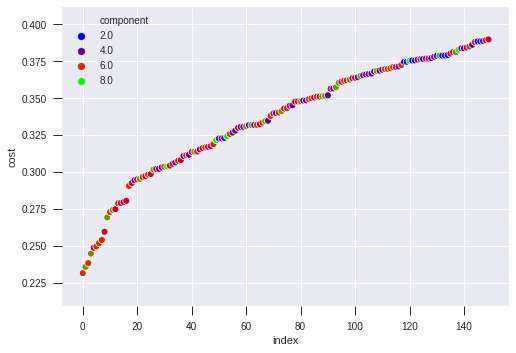

In [236]:
#####################################################
#### Plotting the cost vs other tsne parameters #####
#####################################################
sns.scatterplot(x="index", y="cost", hue="component", palette="brg", data=tsne_iteration_pca_df.head(150))

##### TOP TWO BEST PARAMETERS OF TSNE : learning_rate, iteration, perplexity, component, cost
1. 20.0, 400.0, 70.0, 6.0, 0.231545
2. 20.0, 400.0, 60.0, 7.0, 0.235804	

[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.613986
[t-SNE] KL divergence after 150 iterations with early exaggeration: 51.371230
[t-SNE] KL divergence after 400 iterations: 0.231545
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 254 / 254
[t-SNE] Mean sigma: 2.239856
[t-SNE] KL divergence after 250 iterations with early exaggeration: 43.945135
[t-SNE] KL divergence after 400 iterations: 0.470322


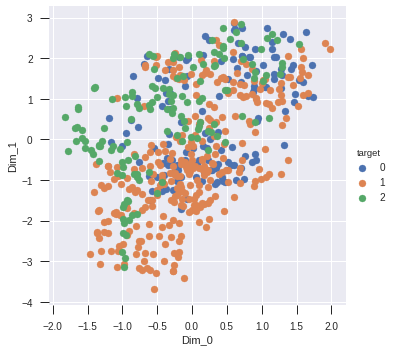

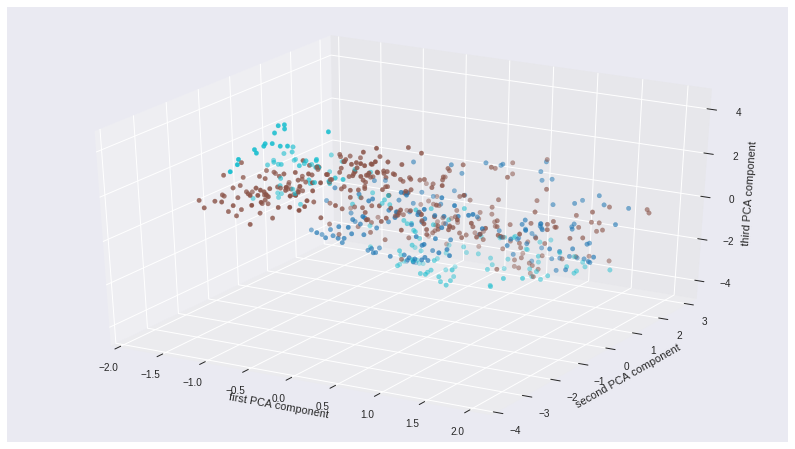

In [237]:
###############################################################################################################
########## Plotting with obstained/tuned tsne parameters with components as 6, iteration 400, perplexity 70 ###
###############################################################################################################

tsne_transformer = TSNE(n_components=6, verbose=1, perplexity=70, n_iter=400, learning_rate=20
                        , method='exact', random_state=42)
X_tsne_embedded_4 = tsne_transformer.fit_transform(X_train_scaled_withpca)
X_test_tsne4 = tsne_transformer.fit_transform(X_test_scaled_withpca)
tsne_df = visualize_pca(X_tsne_embedded_4, y_train, True, size=5)
visualize_pca3D(X_tsne_embedded_4, y_train)

[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 592 / 592
[t-SNE] Mean sigma: 1.533814
[t-SNE] KL divergence after 150 iterations with early exaggeration: 52.823376
[t-SNE] KL divergence after 400 iterations: 0.235804
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 254 / 254
[t-SNE] Mean sigma: 2.093909
[t-SNE] KL divergence after 150 iterations with early exaggeration: 44.992500
[t-SNE] KL divergence after 400 iterations: 0.652493


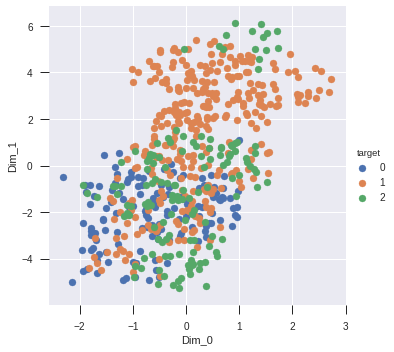

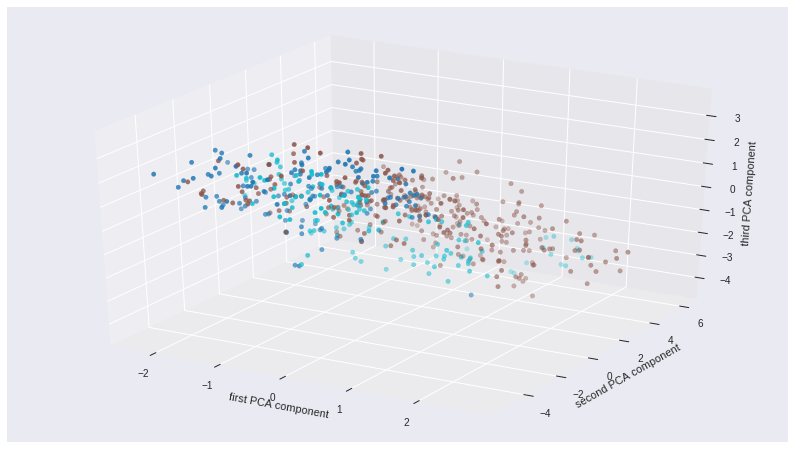

In [238]:
###############################################################################################################
########## Plotting with obstained/tuned tsne parameters with components as 7, iteration 400, perplexity 60 ###
###############################################################################################################

tsne_transformer = TSNE(n_components=7, verbose=1, perplexity=60, n_iter=400, learning_rate=20
                        , method='exact', random_state=42)
X_tsne_embedded_5 = tsne_transformer.fit_transform(X_train_scaled_withpca)
X_test_tsne5 = tsne_transformer.fit_transform(X_test_scaled_withpca)
tsne_df = visualize_pca(X_tsne_embedded_5, y_train, True, size=5)
visualize_pca3D(X_tsne_embedded_5, y_train)

#### T-SNE observation : 

1. So far, we have done T-SNE optimization with different combination of hyperparameters and obtained FIVE different transformations of input X.
2. X_tsne_embedded_1 - This is X transformed from default parameters of T-SNE algorithm
3. X_tsne_embedded_2 and X_tsne_embedded_3 - These are TOP two low scoring T-SNE models chosen from hyper parameter tuning with various parameters of T-SNE on scaled input X (WITHOUT PCA)
4. X_tsne_embedded_4 and X_tsne_embedded_5 - These are TOP two low scoring T-SNE models chosen from hyper parameter tuning with various parameters of T-SNE on scaled input X & WITH PCA

#### Next Steps - Let us evaluate all these FIVE TRANSFORMED X with hyperparamter tuned classifers

In [239]:
##########################################
#### Evaluation of X_tsne_embedded_1 #####
##########################################
n_folds = 5
scaling_options = [StandardScaler()]
no_of_features = np.arange(1, 16)

pipe = Pipeline([
    ('scaler', StandardScaler()),   
    ('model_gs' , LogisticRegression())
])

param_grid_models = [
    {'scaler': scaling_options,
     'model_gs' : [LogisticRegression(class_weight='balanced')],
     'model_gs__penalty' : ['l2'],
     'model_gs__C' : [0.001, 0.01, 0.1, 
                      1, 10, 40, 50, 200],
    'model_gs__solver' : ['newton-cg', 'sag', 'saga', 'lbfgs'],
     'model_gs__multi_class': ['multinomial'],
     'model_gs__random_state': [42]
    },
    {'scaler': scaling_options,
     'model_gs' : [svm.SVC()],
    'model_gs__C': [0.01, 0.05, 0.5, 1],
    'model_gs__gamma': [0.001, 0.01, 0.1, 1],
    'model_gs__kernel': ['linear', 'poly', 'rbf'],
    'model_gs__degree': [1,2,3],
    'model_gs__decision_function_shape': ['ovo'],
    'model_gs__random_state': [42]}
]

In [240]:
#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)
best_clf_tsne1 = grid.fit(X_tsne_embedded_1, y_train)
best_clf_tsne1.best_estimator_, best_clf_tsne1.best_score_

Fitting 5 folds for each of 176 candidates, totalling 880 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 880 out of 880 | elapsed:    2.1s finished


(Pipeline(memory=None,
          steps=[('scaler',
                  StandardScaler(copy=True, with_mean=True, with_std=True)),
                 ('model_gs',
                  SVC(C=0.5, cache_size=200, class_weight=None, coef0=0.0,
                      decision_function_shape='ovo', degree=1, gamma=1,
                      kernel='rbf', max_iter=-1, probability=False,
                      random_state=42, shrinking=True, tol=0.001,
                      verbose=False))],
          verbose=False), 0.7989864864864865)

Inside ONLY Scaler included in grid search <True, False>

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[36 21  1]
 [25 89  4]
 [62 16  0]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.29      0.62      0.40        58
           1       0.71      0.75      0.73       118
           2       0.00      0.00      0.00        78

    accuracy                           0.49       254
   macro avg       0.33      0.46      0.38       254
weighted avg       0.39      0.49      0.43       254



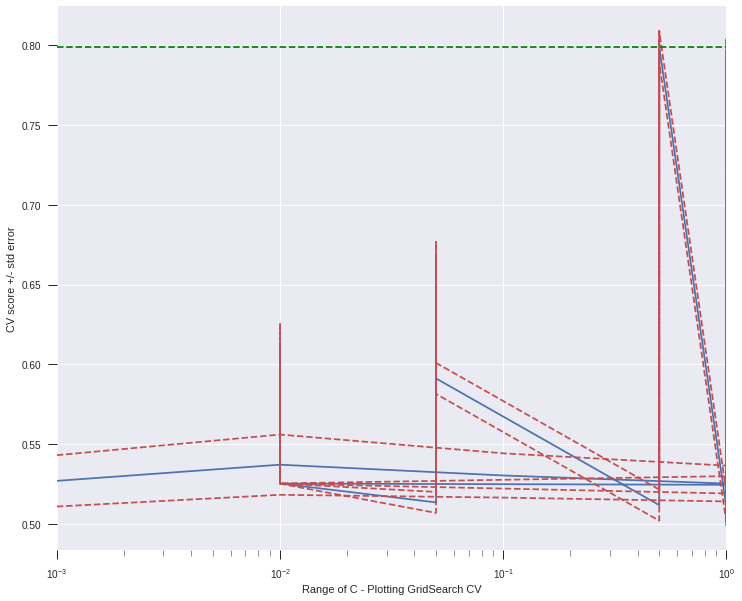

In [241]:
plot_crossval_graph(best_clf_tsne1, 'param_model_gs__C')
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(best_clf_tsne1.best_estimator_,
                                          X_tsne_embedded_1, y_train, X_test_tsne1, y_test, 
                                          tuned_models_list, scaled=True, pca=False)

In [242]:
#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)
best_clf_tsne2 = grid.fit(X_tsne_embedded_2, y_train)
best_clf_tsne2.best_estimator_, best_clf_tsne2.best_score_

Fitting 5 folds for each of 176 candidates, totalling 880 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  64 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 880 out of 880 | elapsed:    1.8s finished


(Pipeline(memory=None,
          steps=[('scaler',
                  StandardScaler(copy=True, with_mean=True, with_std=True)),
                 ('model_gs',
                  SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
                      decision_function_shape='ovo', degree=1, gamma=1,
                      kernel='rbf', max_iter=-1, probability=False,
                      random_state=42, shrinking=True, tol=0.001,
                      verbose=False))],
          verbose=False), 0.9070945945945946)

Inside ONLY Scaler included in grid search <True, False>

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[  0  58   0]
 [  0 118   0]
 [  0  78   0]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        58
           1       0.46      1.00      0.63       118
           2       0.00      0.00      0.00        78

    accuracy                           0.46       254
   macro avg       0.15      0.33      0.21       254
weighted avg       0.22      0.46      0.29       254



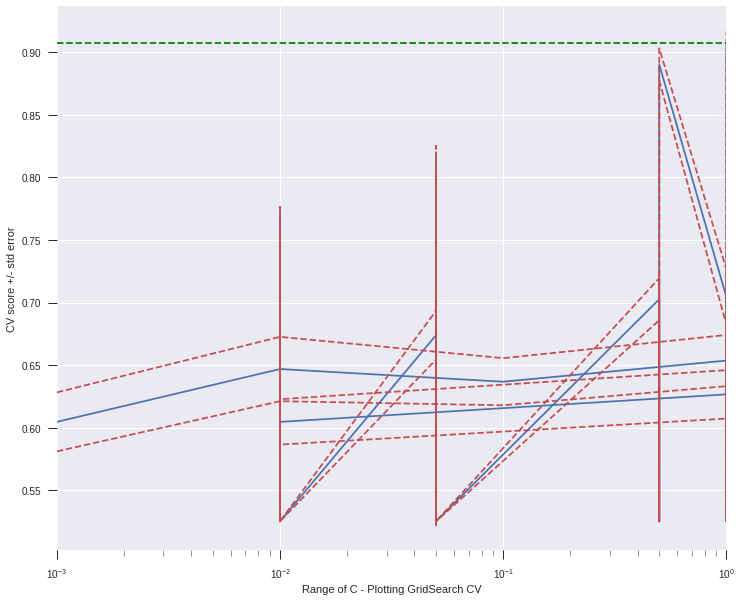

In [243]:
plot_crossval_graph(best_clf_tsne2, 'param_model_gs__C')
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(best_clf_tsne2.best_estimator_,
                                          X_tsne_embedded_2, y_train, X_test_tsne2, y_test, 
                                          tuned_models_list, scaled=True, pca=False)

In [244]:
#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)
best_clf_tsne3 = grid.fit(X_tsne_embedded_3, y_train)
best_clf_tsne3.best_estimator_, best_clf_tsne3.best_score_

Fitting 5 folds for each of 176 candidates, totalling 880 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  64 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 880 out of 880 | elapsed:    1.5s finished


(Pipeline(memory=None,
          steps=[('scaler',
                  StandardScaler(copy=True, with_mean=True, with_std=True)),
                 ('model_gs',
                  SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
                      decision_function_shape='ovo', degree=1, gamma=1,
                      kernel='rbf', max_iter=-1, probability=False,
                      random_state=42, shrinking=True, tol=0.001,
                      verbose=False))],
          verbose=False), 0.9121621621621622)

In [245]:
X_test_tsne3.shape, X_tsne_embedded_3.shape, y_train.shape, y_test.shape

((254, 6), (592, 6), (592, 1), (254, 1))

Inside ONLY Scaler included in grid search <True, False>

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 20  32   6]
 [ 12 105   1]
 [ 11  67   0]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.47      0.34      0.40        58
           1       0.51      0.89      0.65       118
           2       0.00      0.00      0.00        78

    accuracy                           0.49       254
   macro avg       0.33      0.41      0.35       254
weighted avg       0.35      0.49      0.39       254



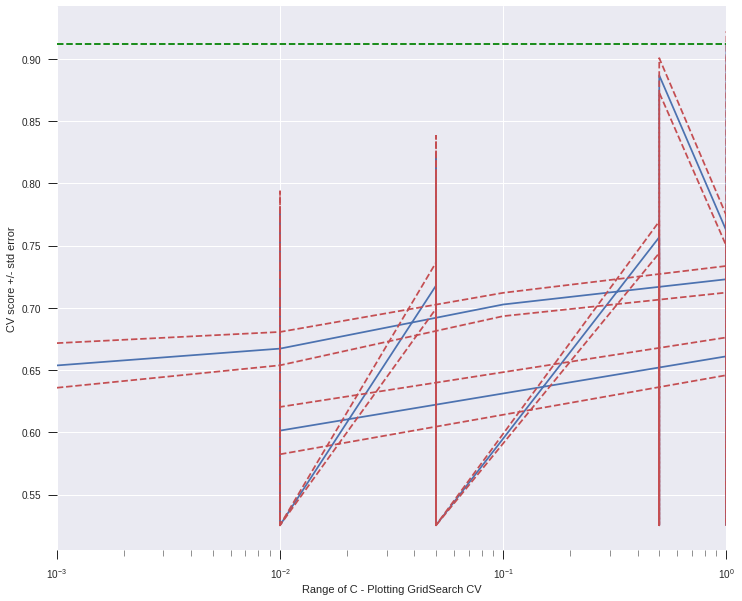

In [246]:
plot_crossval_graph(best_clf_tsne3, 'param_model_gs__C')
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(best_clf_tsne3.best_estimator_,
                                          X_tsne_embedded_3, y_train, X_test_tsne3, y_test, 
                                          tuned_models_list, scaled=True, pca=False)

In [247]:
#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)
best_clf_tsne4 = grid.fit(X_tsne_embedded_4, y_train)
best_clf_tsne4.best_estimator_, best_clf_tsne4.best_score_

Fitting 5 folds for each of 176 candidates, totalling 880 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  68 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 880 out of 880 | elapsed:    1.5s finished


(Pipeline(memory=None,
          steps=[('scaler',
                  StandardScaler(copy=True, with_mean=True, with_std=True)),
                 ('model_gs',
                  SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
                      decision_function_shape='ovo', degree=1, gamma=1,
                      kernel='rbf', max_iter=-1, probability=False,
                      random_state=42, shrinking=True, tol=0.001,
                      verbose=False))],
          verbose=False), 0.9155405405405406)

Inside ONLY Scaler included in grid search <True, False>

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[  0  58   0]
 [  1 117   0]
 [  0  77   1]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        58
           1       0.46      0.99      0.63       118
           2       1.00      0.01      0.03        78

    accuracy                           0.46       254
   macro avg       0.49      0.33      0.22       254
weighted avg       0.52      0.46      0.30       254



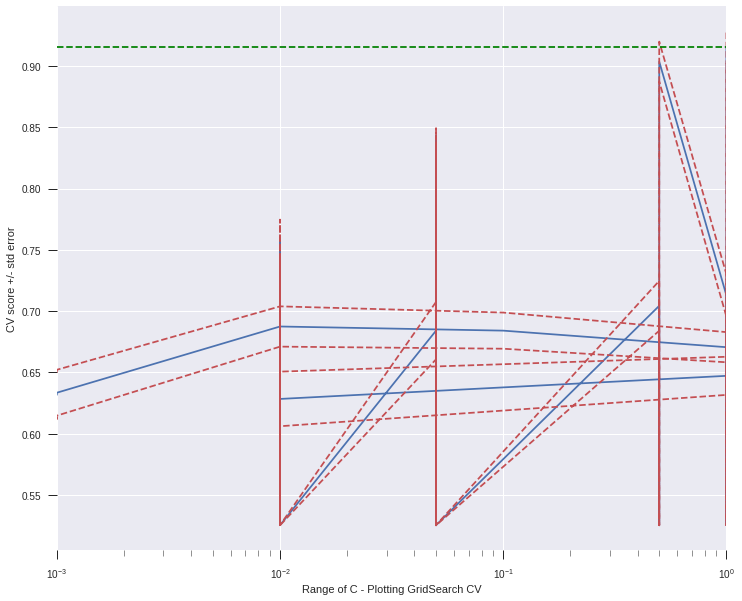

In [248]:
plot_crossval_graph(best_clf_tsne4, 'param_model_gs__C')
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(best_clf_tsne4.best_estimator_,
                                          X_tsne_embedded_4, y_train, X_test_tsne4, y_test, 
                                          tuned_models_list, scaled=True, pca=False)

In [249]:
#choosing njobs as -1 to have parallel processing
grid = GridSearchCV(pipe, param_grid = param_grid_models,cv = n_folds, verbose=True, n_jobs=-1)
best_clf_tsne5 = grid.fit(X_tsne_embedded_5, y_train)
best_clf_tsne5.best_estimator_, best_clf_tsne5.best_score_

Fitting 5 folds for each of 176 candidates, totalling 880 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  60 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 880 out of 880 | elapsed:    1.7s finished


(Pipeline(memory=None,
          steps=[('scaler',
                  StandardScaler(copy=True, with_mean=True, with_std=True)),
                 ('model_gs',
                  SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
                      decision_function_shape='ovo', degree=1, gamma=1,
                      kernel='rbf', max_iter=-1, probability=False,
                      random_state=42, shrinking=True, tol=0.001,
                      verbose=False))],
          verbose=False), 0.9138513513513513)

Inside ONLY Scaler included in grid search <True, False>

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[  0  58   0]
 [  0 118   0]
 [  0  78   0]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        58
           1       0.46      1.00      0.63       118
           2       0.00      0.00      0.00        78

    accuracy                           0.46       254
   macro avg       0.15      0.33      0.21       254
weighted avg       0.22      0.46      0.29       254



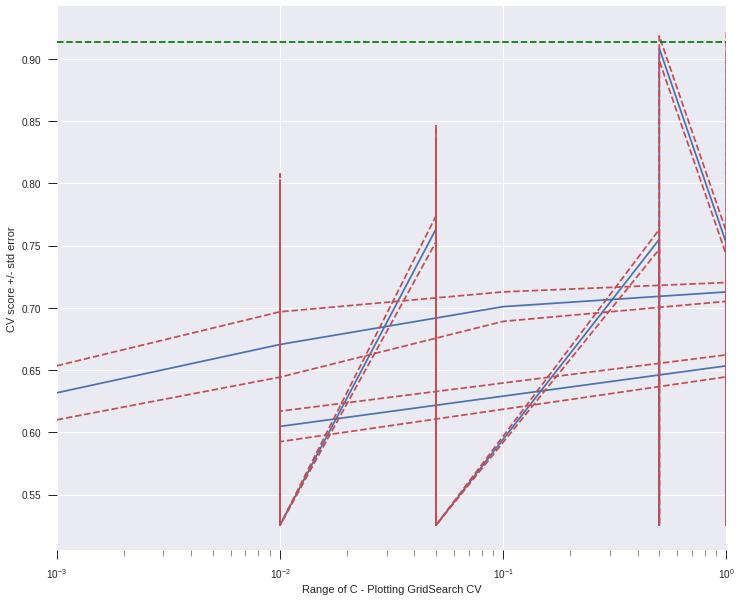

In [250]:
plot_crossval_graph(best_clf_tsne5, 'param_model_gs__C')
##### MODELS TRAINED SO FAR WITH HYPER PARAMETER TUNING #####
tuned_models_list, \
X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(best_clf_tsne5.best_estimator_,
                                          X_tsne_embedded_5, y_train, X_test_tsne5, y_test, 
                                          tuned_models_list, scaled=True, pca=False)

### Conclusion of T-SNE vs PCA vs LDA for our use case:



#############################################################
########### Recapping the NICE CLUSTERS from LDA ############
#############################################################


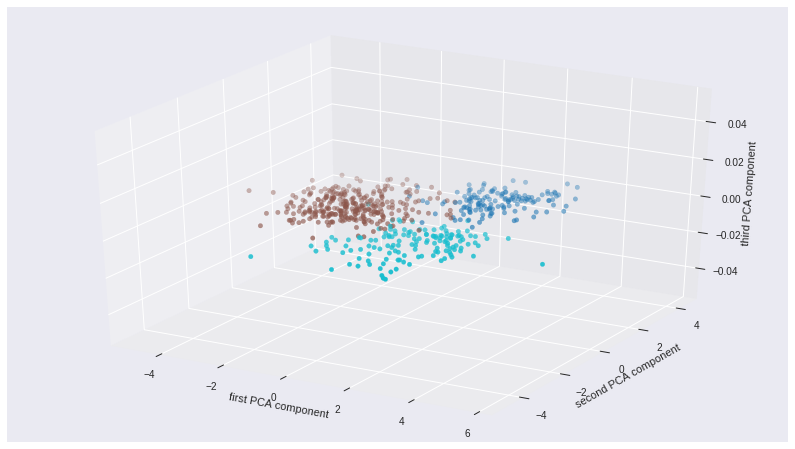

#############################################################
#################### LDA Performance Summary ################
#############################################################
Inside PCA and Scaler included in grid search <True, True>
Features reduced to : [2]

###### Confusion Matrix Summary for UNSEEN Test Data ######

[[ 57   1   0]
 [  2 111   5]
 [  1   1  76]]

###### Classification Report for UNSEEN Test Data ######

              precision    recall  f1-score   support

           0       0.95      0.98      0.97        58
           1       0.98      0.94      0.96       118
           2       0.94      0.97      0.96        78

    accuracy                           0.96       254
   macro avg       0.96      0.97      0.96       254
weighted avg       0.96      0.96      0.96       254



In [254]:
print("#############################################################")
print("########### Recapping the NICE CLUSTERS from LDA ############")
print("#############################################################")
visualize_pca3D(X_train_lda, y_train)
print("#############################################################")
print("#################### LDA Performance Summary ################")
print("#############################################################")
tuned_models_list, \
X_train_transformed, X_test_transformed  = print_confusion_classification_gridsearch(best_clf_dim.best_estimator_,
                                          X_train, y_train, X_test, y_test, 
                                          tuned_models_list, scaled=True, pca=True)

###### Note : 
We can clearly apply clustering on top of this LDA transformed data which would clearly separare all the targets nicely - A clean clustering compared to K-means which we tried some steps back

### Clearly, TSNE struggled to find clear boundaries across THREE TARGET variables (Van, bus and car). On the other hand, LDA has really outperformed PCA and TSNE for our use case with consistent F1 score of 97%, 96%, 96% chance of identifying van, bus and car correctly.

### Technical Summary :

1. Out of around 500,000 models fitted using grid search and hyper parameter tuning with PCA, LDA, Clustering, Scaling and clustering - we were able to clearly observe Support vector has performed very consistently
2. We were able to reduce original 18 features to 11 features with still 99.1% explained variance ratio i.e. without much loss of information > 95%, we still managed to reduce 7 features without compromising model performance
3. Model's final evaluation after Scaling, PCA and Grid Search is as below - F1 Score of UNSEEN TEST DATA : Class 1 - 95%, Class 2 - 96%, Class 3 - 96%. This is very satisfactory outcome.
4. K Means Clustering technique to fit the dataset into 3 clusters performed very poorly, there are very good room of opportunity to explore other cluster parameters for fine tuning and perhaps, data might fit without overlapping of data points if we would have tried beyond 3 clusters. To be noted, Elbow method clearly revealed of having 5-6 clusters and that kind of matches the problem statement of wanting to identify specific car types instead of just car or a van or a bus. In short, data clearly seem to have more than 3 clusters.
5. Stacking has been very successful with better model evaluation performance which has been explained above in dteails. If we could do further levels of stacking, there is definitely a room for further increment in model performance.
6. 
###### Stacking has given SIGNIFICANT improvment over regular grid search pipelines with F1 score of 97% for class1(van), 97% for class2(car), 97% for class3(bus) overall, which is 2% improvement for identifying Van, 1% improvement for identifying car and 1% improvement for identifying bus

7. PCA, LDA and T-SNE algorithms were applied on our dataset with hyperparameters tuning - LDA had the highest F1 score of 97% for class 1(van), 96% for class 2(car), 96% for class 3(bus). This has been the highest score among other models attempted in thsi use case. We have gained YET ANOTHER SIGNIFICANT 2% overall BOOST in classification score for class 1(Van), which matters in classification problems
8. T-SNE for some reasons, did not suit our use case. May have to inspect the nature of data(may be, dimension of data is not too big). i.e. T-SNE's strength is to solve crowding problem, which may not have been an issue here. 
9. With LDA performing better over PCA and T-SNE, I would prefer sticking with LDA and stack it too which may still give small boost in generalization of accurate model

## FINAL CONCLUSION :

Overall, we have been able to successully implement a generalized object identification model that has 97% chance of recognizing a Van, 97% chance of recognizing a car and 97% of chance of recognizing a bus. This could be very well ready for identifying the vehicle types in PRODUCTION. 